# Exhaustive Correlation Explorer

## Purpose

 This notebook is designed as a **systematic observation tool** for exploring relationships among a set of selected variables. It automatically generates and analyzes "all mutually exclusive and collectively exhaustive (MECE) pairwise combinations", ensuring full coverage of potential relationships. It is designed to be flexible — users can easily modify the input variable list through **Analysis.yaml** file to test new hypotheses. (Note: a large number of combinations will result in a high volume of visual outputs)

## Goals
- Explore correlations across selected variables in a structured way,
- Uncover patterns that are interesting and may evolve into potential hypotheses, and
- Highlight meaningful relationships worth further analysis with causal investigation.


# Step 0. Basic Settings

In [1]:
import pandas as pd
import numpy as np
# Disable scientific notation & add commas
pd.set_option('display.float_format', '{:,.5f}'.format)
# Show all columns without truncation
pd.set_option('display.max_columns', None)
# Show full column width (helpful for long strings)
pd.set_option('display.max_colwidth', None)
# Limit the number of rows displayed in output
pd.set_option('display.max_rows', 500)

/opt/anaconda3/lib/python3.9/site-packages/pandas/core/computation/expressions.py:21: UserWarning: Pandas requires version '2.8.4' or newer of 'numexpr' (version '2.7.3' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED
/opt/anaconda3/lib/python3.9/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.2' currently installed).
  from pandas.core import (


# Step 1. Load the Dataset

In [2]:
import yaml

# Step 1: Load YAML
with open("../../config/Analysis.yaml", "r") as f:
    config = yaml.safe_load(f)

path = config['02_correlations']['data']['path']
df = pd.read_csv(path)
df = df.dropna()

In [3]:
msa_infos = [i for i in df.columns if 'Crosswalk' in i]

### Population ###
total_population = ['NRI_POPULATION']
exposure_pe = [i for i in df.columns if 'EXPPE' in i]
eal_pe = [i for i in df.columns if 'EALPE' in i]


### Buildings ###
total_building = ['NRI_BUILDVALUE']
exposure_bldg = [i for i in df.columns if 'EXPB' in i]
eal_bldg = [i for i in df.columns if 'EALB' in i]

# Step 2. Preprocessing columns

In [4]:
# Can be read from the yaml as well
hazard_types = 17
population_equivalence = 11_000_000

## Per capita columns

### Population and building losses are structured in a funnel format:
### Funnel 1: Total population or buildings in the MSA
### Funnel 2: Subset of Funnel 1 exposed to hazards
### Funnel 3: Subset of Funnel 2 expected to experience loss

### Thus:

#### - Exposure rate = Funnel 2 / Funnel 1

#### - Loss rate = Funnel 3 / Funnel 2

#### - Loss per capita = Funnel 3 / Funnel 1


## 2-1. Population‑equivalent (PE)

In [5]:
# Funnel 1 - Population into total population equivalence
df["total_population_equiv"] = df["NRI_POPULATION"] * population_equivalence * hazard_types  # 11 M * 17 hazard types

# Funnel 2 - Sum of exposed population to the all hazards
df["exposure_pop_total"] = df[exposure_pe].sum(axis=1)
df["pct_pop_exposed"] = df["exposure_pop_total"] / df["total_population_equiv"] * 100

# Funnel 3 - Sum of loss from all hazards
df["loss_pop_total"] = df[eal_pe].sum(axis=1)
df["pct_pop_loss"] =  df["loss_pop_total"] / df["exposure_pop_total"] * 100

## 2-2. Building Loss (Bldg)

In [6]:
# Funnel 1 - Building value into total building value
df["building_equiv"] = df["NRI_BUILDVALUE"] * hazard_types

# Funnel 2 - Sum of exposed building value to all hazards
df["exposure_bldg_total"] = df[exposure_bldg].sum(axis=1)
df["pct_bldg_exposed"] = df["exposure_bldg_total"] / df["building_equiv"] * 100

# Funnel 3 - Sum of loss from all hazards
df["loss_bldg_total"] = df[eal_bldg].sum(axis=1)
df["pct_bldg_loss"] = df["loss_bldg_total"] / df["exposure_bldg_total"] * 100


## 2-3. Index (Loss per capita / Migration ratio to the population)

In [7]:
# Loss per capita - PE / Bldg
df["loss_per_capita_pe"]   = df["loss_pop_total"]  / df["NRI_POPULATION"]
df["loss_per_capita_bldg"] = df["loss_bldg_total"] / df["NRI_POPULATION"]


### Migration - Normalize ###
df['Inflow_rate'] = df['Migration16to20_A_Inflow_Estimate'] / df['NRI_POPULATION'] * 100
df['Outflow_rate'] = df['Migration16to20_A_Outflow_Estimate'] / df['NRI_POPULATION'] * 100
df['NetMigration_rate'] = df['Migration16to20_A_NetMigration_Estimate'] / df['NRI_POPULATION'] * 100

In [8]:
#df.to_csv('df_with_index.csv', index=False)

## 2-4. Analysis dataset (Key variables)

In [9]:
col_themes = config['02_correlations']['analysis_variables']
columns = col_themes['index'] + col_themes['migration_cols'] + col_themes['housing_cols']
print("Selected variables: ", columns)
data = df[columns]
data = data.dropna()
data = data.replace([np.inf, -np.inf], np.nan).dropna()

data.head(5)

Selected variables:  ['loss_per_capita_pe', 'loss_per_capita_bldg', 'Inflow_rate', 'Outflow_rate', 'Migration16to20_A_Outflow_Estimate', 'HousingPI25_2000', 'HousingPI25_2010', 'HousingPI25_2020', 'HousingPI25_2024']


,loss_per_capita_pe,loss_per_capita_bldg,Inflow_rate,Outflow_rate,Migration16to20_A_Outflow_Estimate,HousingPI25_2000,HousingPI25_2010,HousingPI25_2020,HousingPI25_2024
0,43.36766,119.84033,7.97674,7.20593,"12,714.00000",2.10000,2.70000,3.60000,4.00000
2,9.91116,37.18698,4.13965,4.25729,"29,891.00000",2.50000,2.30000,2.70000,2.90000
3,53.46401,106.24747,5.04364,5.53223,"8,209.00000",2.60000,3.10000,3.40000,4.30000
4,114.61040,227.34218,6.15123,6.27178,"8,064.00000",3.60000,3.90000,4.50000,5.70000
5,23.59265,32.27868,4.17407,3.97949,"35,770.00000",2.40000,3.40000,3.10000,3.70000


# Step 3. Visualization

## 3-1. Simple Correlation Heatmap


🔹 Raw data:


,loss_per_capita_pe,loss_per_capita_bldg,Inflow_rate,Outflow_rate,Migration16to20_A_Outflow_Estimate,HousingPI25_2000,HousingPI25_2010,HousingPI25_2020,HousingPI25_2024
loss_per_capita_pe,1.00**,0.42**,0.04,0.09,0.00,0.16**,0.08,0.15**,0.10
loss_per_capita_bldg,0.42**,1.00**,0.12*,0.12*,0.00,0.31**,0.23**,0.27**,0.26**
Inflow_rate,0.04,0.12*,1.00**,0.84**,-0.29**,0.13*,0.14**,0.07,0.12*
Outflow_rate,0.09,0.12*,0.84**,1.00**,-0.27**,0.09,0.13*,0.03,0.05
Migration16to20_A_Outflow_Estimate,0.00,0.00,-0.29**,-0.27**,1.00**,0.23**,0.18**,0.28**,0.26**
HousingPI25_2000,0.16**,0.31**,0.13*,0.09,0.23**,1.00**,0.86**,0.88**,0.87**
HousingPI25_2010,0.08,0.23**,0.14**,0.13*,0.18**,0.86**,1.00**,0.87**,0.86**
HousingPI25_2020,0.15**,0.27**,0.07,0.03,0.28**,0.88**,0.87**,1.00**,0.96**
HousingPI25_2024,0.10,0.26**,0.12*,0.05,0.26**,0.87**,0.86**,0.96**,1.00**


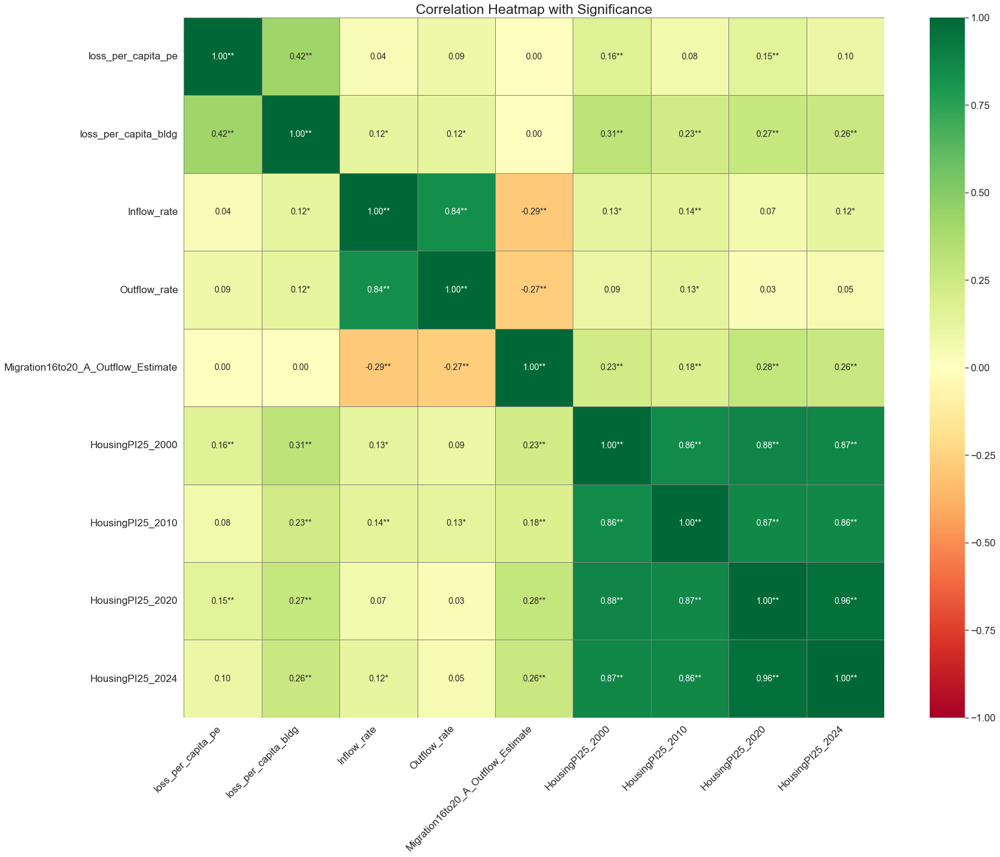

In [10]:
import numpy as np
from scipy.stats import pearsonr
import seaborn as sns
import matplotlib.pyplot as plt

cols = data.columns
n = len(cols)
corr = np.zeros((n, n))
pvals = np.zeros_like(corr)
annot = np.empty_like(corr).astype(str)

# correlation r (pearson) & p-value
for i in range(n):
    for j in range(n):
        x = df[cols[i]]
        y = df[cols[j]]
        valid = np.isfinite(x) & np.isfinite(y)
        if valid.sum() > 1:
            r, p = pearsonr(x[valid], y[valid])
            corr[i, j] = r
            pvals[i, j] = p
            stars = "**" if p < 0.01 else "*" if p < 0.05 else ""
            annot[i, j] = f"{r:.2f}{stars}"
        else:
            corr[i, j] = np.nan
            annot[i, j] = ""


# correlation DataFrame
corr_df = pd.DataFrame(corr, index=cols, columns=cols)

# p-value DataFrame
pval_df = pd.DataFrame(pvals, index=cols, columns=cols)

# annot DataFrame (r + significance)
annot_df = pd.DataFrame(annot, index=cols, columns=cols)

print("\n🔹 Raw data:")
display(annot_df)



plt.figure(figsize=(25, 20))
sns.set(font_scale=1.5)

sns.heatmap(
    corr,
    annot=annot,
    fmt='',
    cmap='RdYlGn',
    vmin=-1,
    vmax=1,
    xticklabels=cols,
    yticklabels=cols,
    linewidths=0.7,
    linecolor='gray',
    square=True,
    annot_kws={"size": 14}
)

plt.xticks(rotation=45, ha='right', fontsize=17)
plt.yticks(fontsize=17)
plt.title("Correlation Heatmap with Significance", fontsize=23)
plt.tight_layout()
plt.show()


# Step 4. Closer look with Scatterplots

## 4-1. Creating a combination table

In [11]:
import itertools
from scipy.stats import pearsonr

def all_variable_combinations(df, min_non_na=3):
    """
    Generate (x, y, z) combinations and calculate the corrleations.
    Include only x ≠ y ≠ z, x < y conditions.
    """
    # Select only Numeric columns for the scatterplots.
    numeric_vars = list(df.select_dtypes(include='number').columns)
    rows = []

    for x, y, z in itertools.permutations(numeric_vars, 3):
        if x < y:  # delete redundant combinations
            temp = df[[x, y]].dropna()
            if len(temp) >= min_non_na:
                r, p = pearsonr(temp[x], temp[y])
            else:
                r, p = np.nan, np.nan
            rows.append({
                'X': x,
                'Y': y,
                'r': r,
                'p': p,
                'Z': z
            })

    result = pd.DataFrame(rows)
    result.insert(0, 'ID', range(1, len(result) + 1))  # Create ID column
    return result

combo_table = all_variable_combinations(data)
combo_table 

,ID,X,Y,r,p,Z
0,1,loss_per_capita_bldg,loss_per_capita_pe,0.41800,0.00000,Inflow_rate
1,2,loss_per_capita_bldg,loss_per_capita_pe,0.41800,0.00000,Outflow_rate
2,3,loss_per_capita_bldg,loss_per_capita_pe,0.41800,0.00000,Migration16to20_A_Outflow_Estimate
3,4,loss_per_capita_bldg,loss_per_capita_pe,0.41800,0.00000,HousingPI25_2000
4,5,loss_per_capita_bldg,loss_per_capita_pe,0.41800,0.00000,HousingPI25_2010
5,6,loss_per_capita_bldg,loss_per_capita_pe,0.41800,0.00000,HousingPI25_2020
6,7,loss_per_capita_bldg,loss_per_capita_pe,0.41800,0.00000,HousingPI25_2024
7,8,Inflow_rate,loss_per_capita_pe,0.03689,0.48114,loss_per_capita_bldg
8,9,Inflow_rate,loss_per_capita_pe,0.03689,0.48114,Outflow_rate
9,10,Inflow_rate,loss_per_capita_pe,0.03689,0.48114,Migration16to20_A_Outflow_Estimate


## 4-2 Vizualize each combo ID case

In [13]:
from IPython.display import display
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
import numpy as np

def plot_grouped_and_total_regression(df, x, y, z, group_col_name="Group"):
    """
    regressio between x and y and with z (including r and p-value)
    """
    sns.set_style("whitegrid")
    df = df.copy()

    try:
        df[group_col_name] = pd.qcut(df[z], q=3, labels=["Low", "Mid", "High"])
    except Exception as e:
        print(f"[Grouping Error] {z} fail: {e}")
        return None

    base_colors = sns.color_palette("Set1", 3)
    palette = dict(zip(["Low", "Mid", "High"], base_colors))

    fig, axes = plt.subplots(1, 2, figsize=(14, 6))

    sns.regplot(
        data=df,
        x=x,
        y=y,
        scatter_kws={"alpha": 0.6},
        line_kws={"color": "black", "linewidth": 2},
        ax=axes[0]
    )
    axes[0].set_title(f"Overall Regression: {y} vs {x}", fontsize=12)
    axes[0].grid(True)

    results = {'x': x, 'y': y, 'z': z}

    temp_df = df[[x, y]].dropna()
    if len(temp_df) >= 3:
        r_all, p_all = pearsonr(temp_df[x], temp_df[y])
        axes[0].text(0.05, 0.95, f"Overall: r = {r_all:.2f}",
                     transform=axes[0].transAxes,
                     color="black", fontsize=12, verticalalignment="top")
    else:
        r_all, p_all = np.nan, np.nan

    results['r_all'] = r_all
    results['p_all'] = p_all

    for group in ["Low", "Mid", "High"]:
        group_data = df[df[group_col_name] == group]
        sns.regplot(
            data=group_data,
            x=x,
            y=y,
            scatter_kws={"alpha": 0.6},
            line_kws={"linewidth": 2},
            color=palette[group],
            label=group,
            ax=axes[1]
        )

    axes[1].legend(title=group_col_name)
    axes[1].set_title(f"{y} vs {x}\nGrouped by {z}", fontsize=12)
    axes[1].grid(True)

    for i, group in enumerate(["Low", "Mid", "High"]):
        group_data = df[df[group_col_name] == group][[x, y]].dropna()
        if len(group_data) >= 3:
            r_group, p_group = pearsonr(group_data[x], group_data[y])
            axes[1].text(
                0.05, 0.95 - i * 0.07,
                f"{group}: r = {r_group:.2f}",
                transform=axes[1].transAxes,
                color=palette[group],
                fontsize=11,
                weight="bold"
            )
        else:
            r_group, p_group = np.nan, np.nan

        results[f"r_{group.lower()}"] = r_group
        results[f"p_{group.lower()}"] = p_group

    plt.tight_layout()
    plt.show()

    return results


def plot_by_combo_id(df, combo_table, ID_list):

    if isinstance(ID_list, int):
        ID_list = [ID_list]

    summary_rows = []
    plot_targets = []

    for ID in ID_list:
        if ID not in combo_table['ID'].values:
            print(f"[Error] ID {ID} not found in combo_table.\n")
            continue

        row = combo_table[combo_table['ID'] == ID].iloc[0]
        x, y, z = row['X'], row['Y'], row['Z']

        plot_targets.append((ID, x, y, z))

        temp = df[[x, y]].dropna()
        r_all, p_all = pearsonr(temp[x], temp[y]) if len(temp) >= 3 else (np.nan, np.nan)

        r_group = {}
        try:
            df['Group'] = pd.qcut(df[z], 3, labels=['Low', 'Mid', 'High'])
            for group in ['Low', 'Mid', 'High']:
                sub = df[df['Group'] == group][[x, y]].dropna()
                r, p = pearsonr(sub[x], sub[y]) if len(sub) >= 3 else (np.nan, np.nan)
                r_group[f"r_{group.lower()}"] = r
                r_group[f"p_{group.lower()}"] = p
        except:
            r_group = {f"r_{g.lower()}": np.nan for g in ['Low', 'Mid', 'High']}
            r_group.update({f"p_{g.lower()}": np.nan for g in ['Low', 'Mid', 'High']})

        summary_rows.append({
            'ID': ID, 'x': x, 'y': y, 'z': z,
            'r_all': r_all, 'p_all': p_all,
            **r_group
        })

    summary_df = pd.DataFrame(summary_rows)
    print("\n🔹 Raw data:")
    display(summary_df)

    # viz loop
    for ID, x, y, z in plot_targets:
        print(f"📊 Plot ID {ID}: X = {x}, Y = {y}, Z = {z}")
        plot_grouped_and_total_regression(df, x=x, y=y, z=z, group_col_name=z)

    return summary_df


🔹 Raw data:


,ID,x,y,z,r_all,p_all,r_low,p_low,r_mid,p_mid,r_high,p_high
0,1,loss_per_capita_bldg,loss_per_capita_pe,Inflow_rate,0.41800,0.00000,0.56921,0.00000,0.42845,0.00000,0.30540,0.00062
1,2,loss_per_capita_bldg,loss_per_capita_pe,Outflow_rate,0.41800,0.00000,0.45928,0.00000,0.39586,0.00001,0.39247,0.00001
2,3,loss_per_capita_bldg,loss_per_capita_pe,Migration16to20_A_Outflow_Estimate,0.41800,0.00000,0.38865,0.00001,0.39899,0.00001,0.51532,0.00000
3,4,loss_per_capita_bldg,loss_per_capita_pe,HousingPI25_2000,0.41800,0.00000,0.35523,0.00001,0.34070,0.00021,0.50235,0.00000
4,5,loss_per_capita_bldg,loss_per_capita_pe,HousingPI25_2010,0.41800,0.00000,0.37504,0.00001,0.33249,0.00032,0.52412,0.00000
5,6,loss_per_capita_bldg,loss_per_capita_pe,HousingPI25_2020,0.41800,0.00000,0.45673,0.00000,0.27475,0.00284,0.53065,0.00000
6,7,loss_per_capita_bldg,loss_per_capita_pe,HousingPI25_2024,0.41800,0.00000,0.48574,0.00000,0.28468,0.00163,0.52216,0.00000
7,8,Inflow_rate,loss_per_capita_pe,loss_per_capita_bldg,0.03689,0.48114,-0.02130,0.81582,0.00754,0.93429,-0.06005,0.50942
8,9,Inflow_rate,loss_per_capita_pe,Outflow_rate,0.03689,0.48114,-0.09987,0.27172,-0.06768,0.46076,0.01456,0.87298
9,10,Inflow_rate,loss_per_capita_pe,Migration16to20_A_Outflow_Estimate,0.03689,0.48114,0.00187,0.98364,0.08997,0.32643,-0.02361,0.79544


📊 Plot ID 1: X = loss_per_capita_bldg, Y = loss_per_capita_pe, Z = Inflow_rate


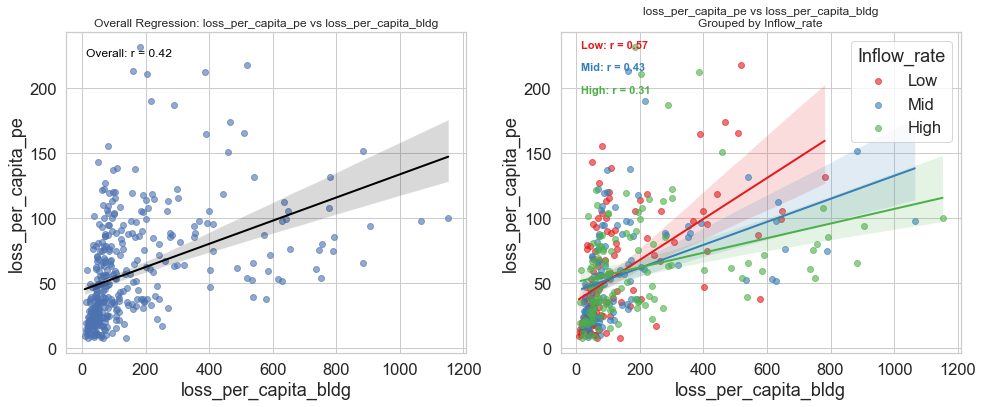

📊 Plot ID 2: X = loss_per_capita_bldg, Y = loss_per_capita_pe, Z = Outflow_rate


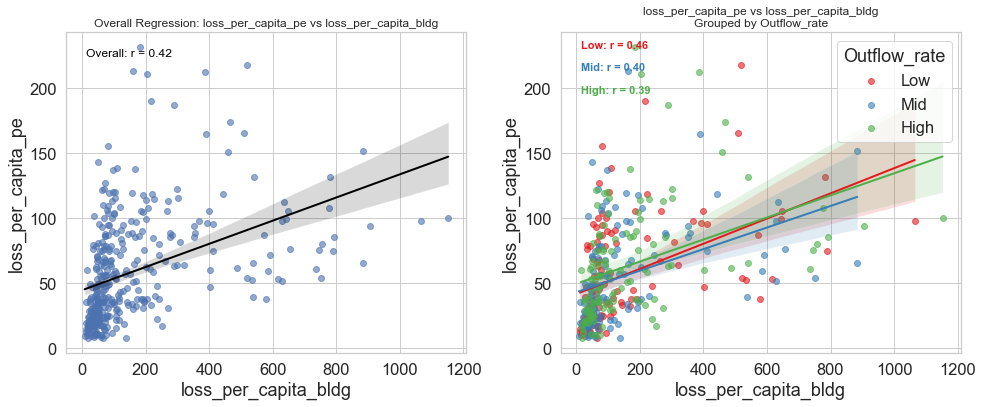

📊 Plot ID 3: X = loss_per_capita_bldg, Y = loss_per_capita_pe, Z = Migration16to20_A_Outflow_Estimate


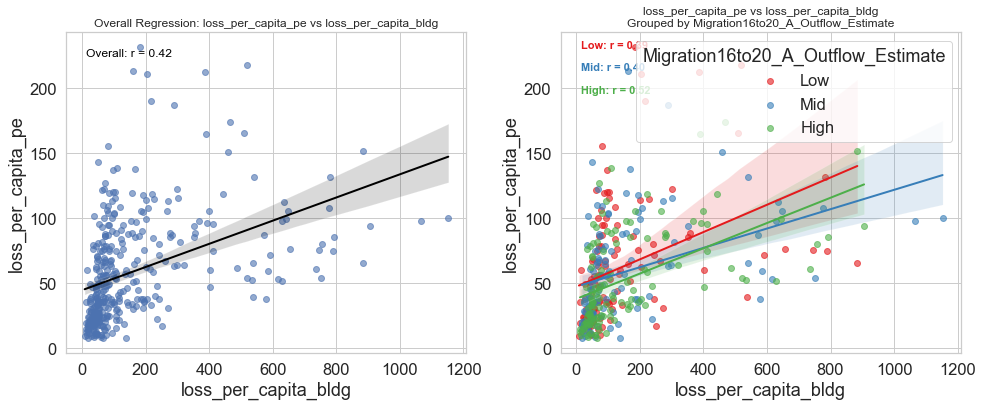

📊 Plot ID 4: X = loss_per_capita_bldg, Y = loss_per_capita_pe, Z = HousingPI25_2000


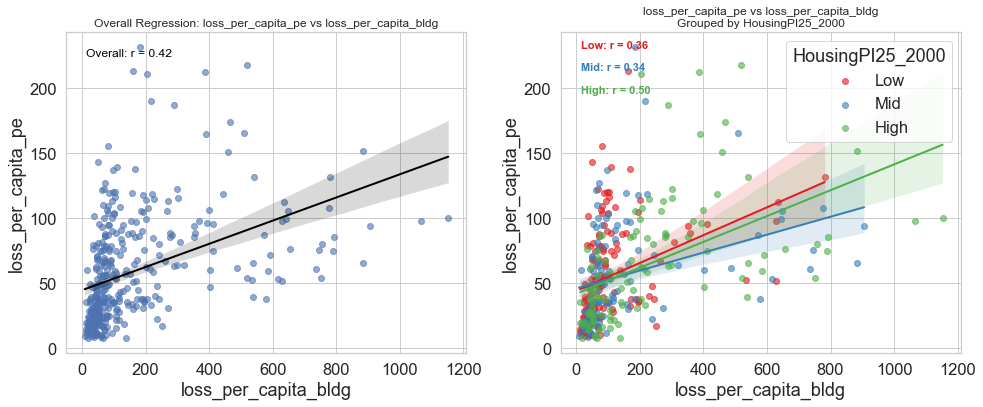

📊 Plot ID 5: X = loss_per_capita_bldg, Y = loss_per_capita_pe, Z = HousingPI25_2010


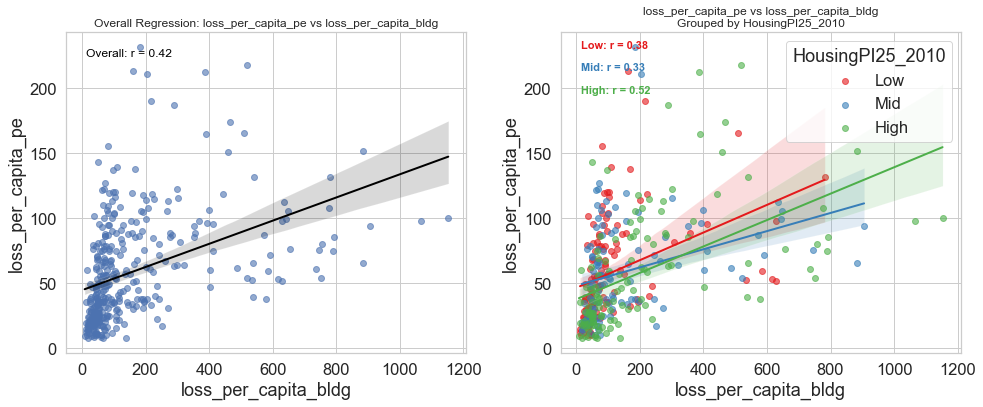

📊 Plot ID 6: X = loss_per_capita_bldg, Y = loss_per_capita_pe, Z = HousingPI25_2020


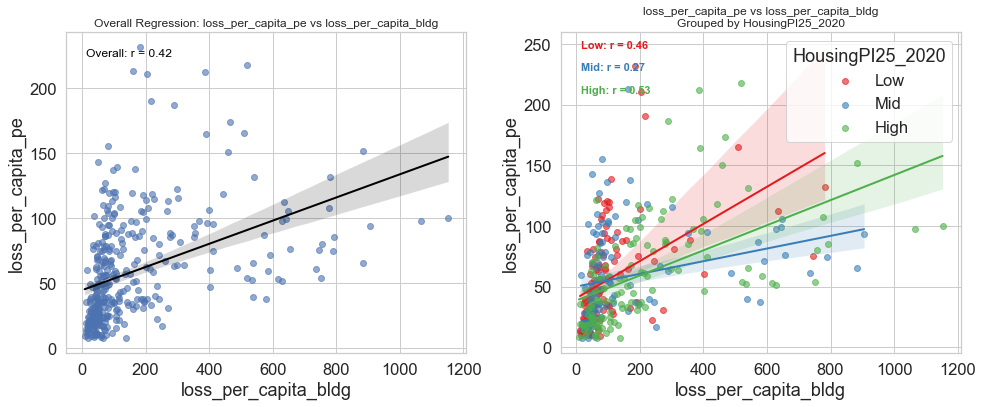

📊 Plot ID 7: X = loss_per_capita_bldg, Y = loss_per_capita_pe, Z = HousingPI25_2024


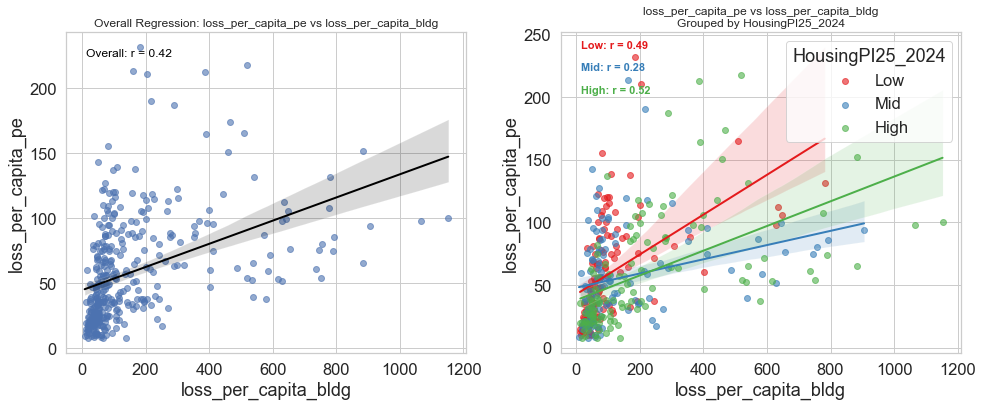

📊 Plot ID 8: X = Inflow_rate, Y = loss_per_capita_pe, Z = loss_per_capita_bldg


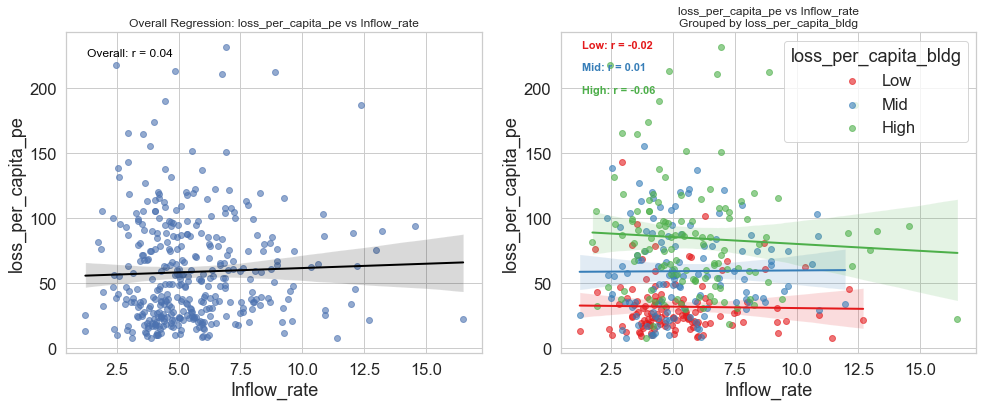

📊 Plot ID 9: X = Inflow_rate, Y = loss_per_capita_pe, Z = Outflow_rate


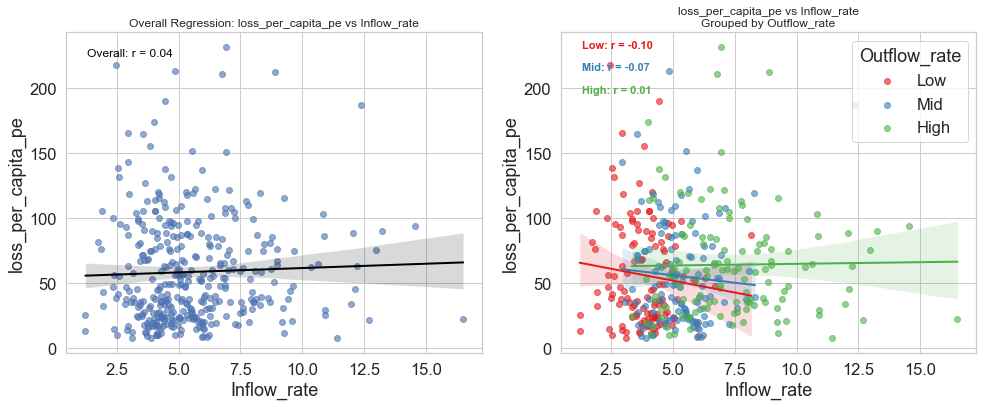

📊 Plot ID 10: X = Inflow_rate, Y = loss_per_capita_pe, Z = Migration16to20_A_Outflow_Estimate


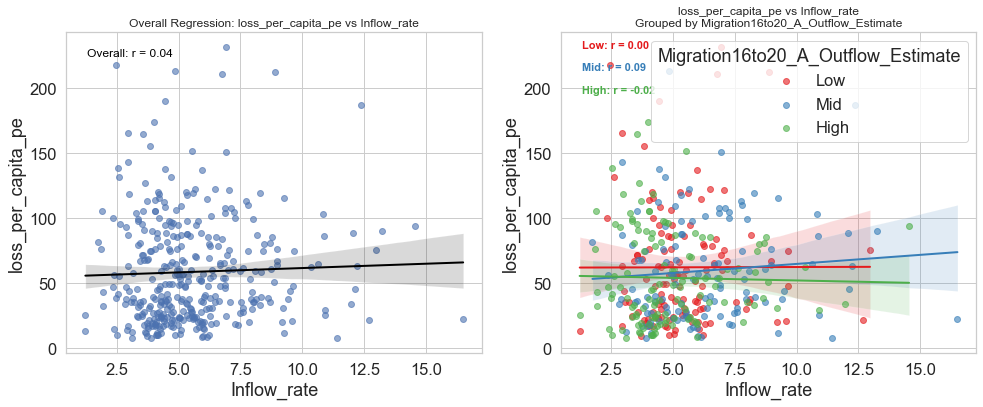

📊 Plot ID 11: X = Inflow_rate, Y = loss_per_capita_pe, Z = HousingPI25_2000


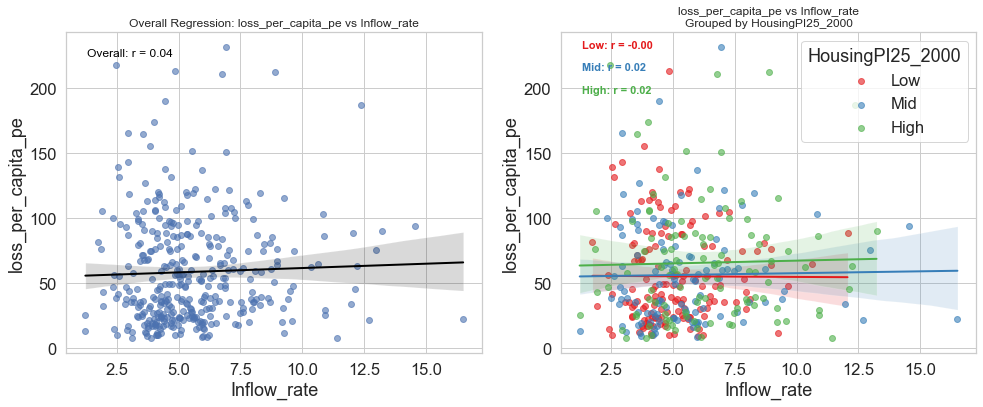

📊 Plot ID 12: X = Inflow_rate, Y = loss_per_capita_pe, Z = HousingPI25_2010


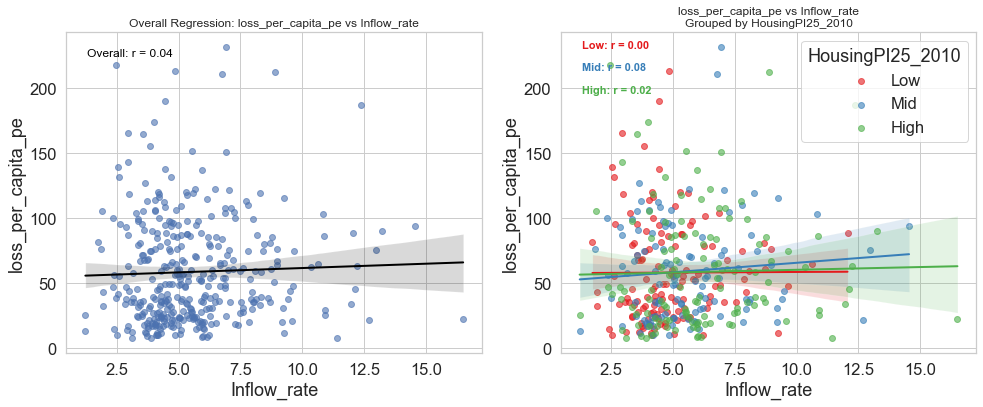

📊 Plot ID 13: X = Inflow_rate, Y = loss_per_capita_pe, Z = HousingPI25_2020


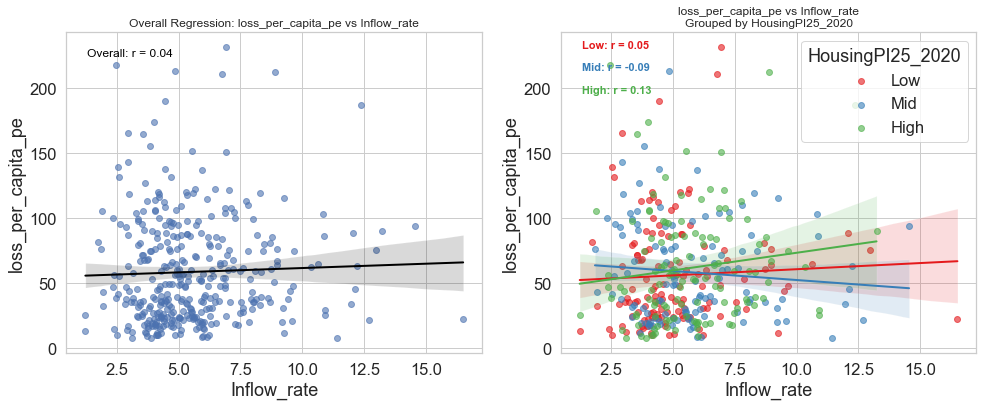

📊 Plot ID 14: X = Inflow_rate, Y = loss_per_capita_pe, Z = HousingPI25_2024


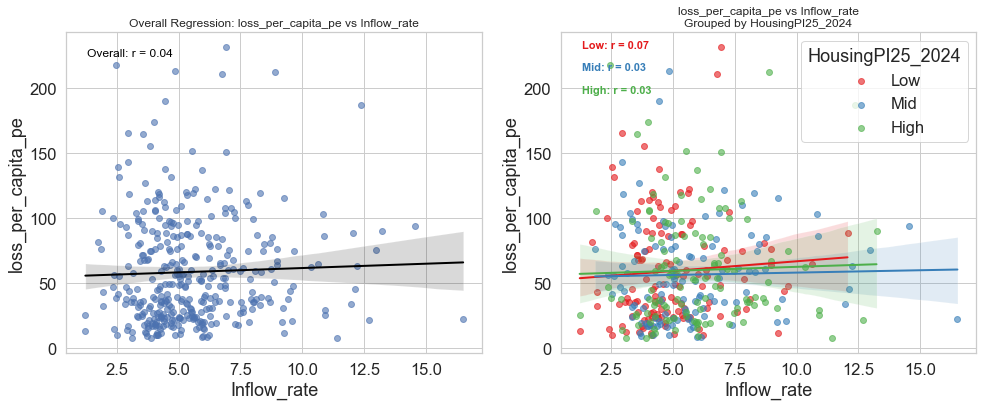

📊 Plot ID 15: X = Inflow_rate, Y = loss_per_capita_bldg, Z = loss_per_capita_pe


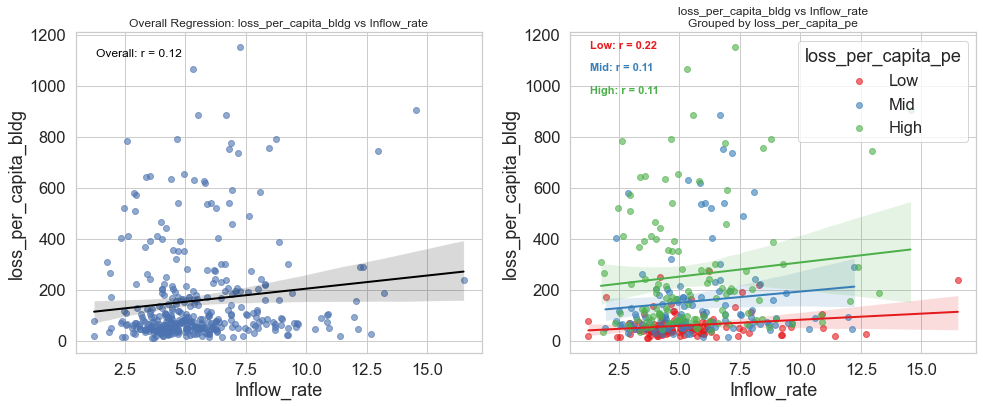

📊 Plot ID 16: X = Inflow_rate, Y = loss_per_capita_bldg, Z = Outflow_rate


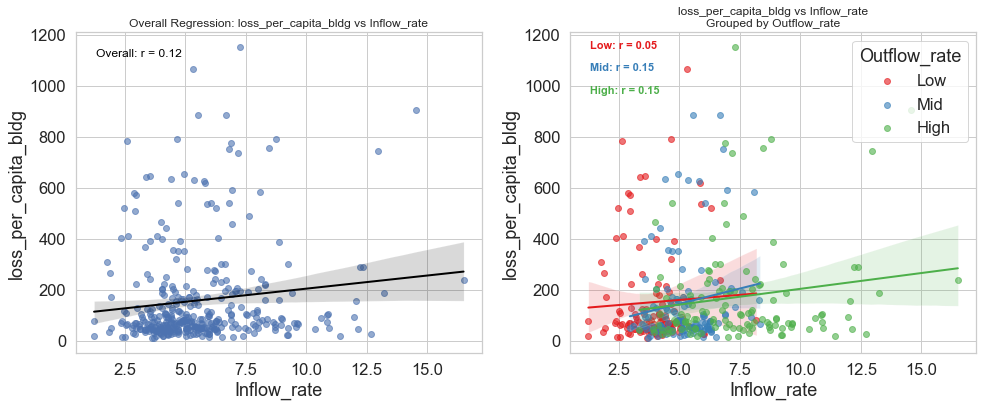

📊 Plot ID 17: X = Inflow_rate, Y = loss_per_capita_bldg, Z = Migration16to20_A_Outflow_Estimate


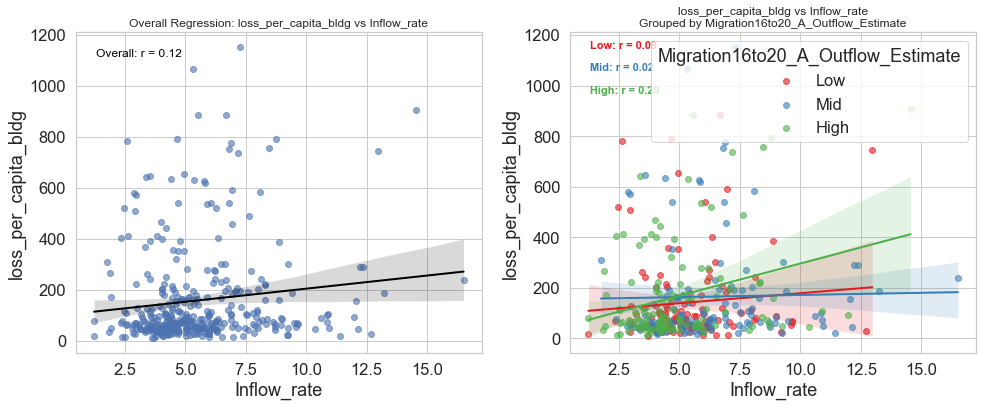

📊 Plot ID 18: X = Inflow_rate, Y = loss_per_capita_bldg, Z = HousingPI25_2000


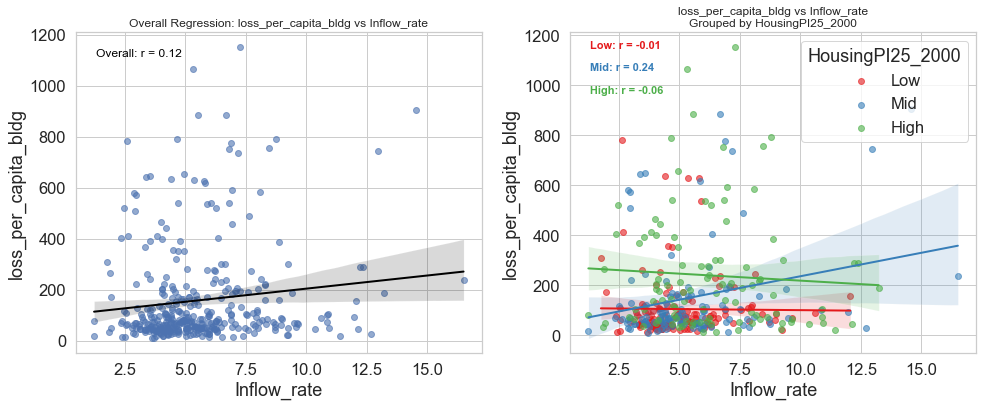

📊 Plot ID 19: X = Inflow_rate, Y = loss_per_capita_bldg, Z = HousingPI25_2010


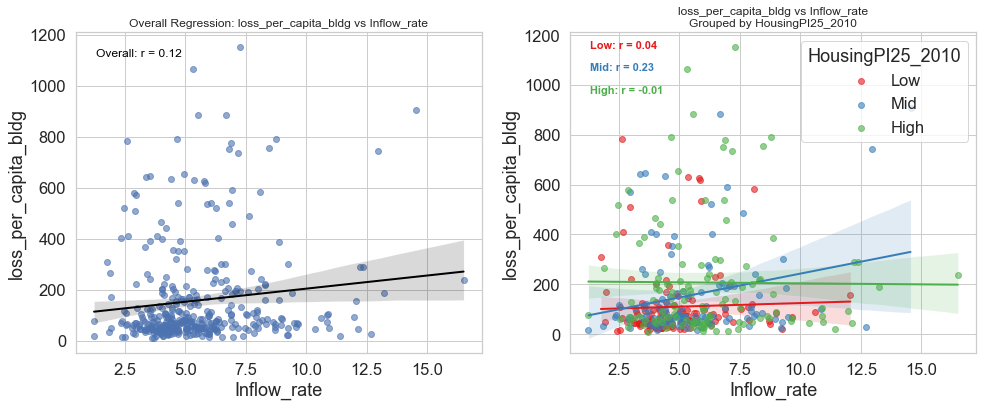

📊 Plot ID 20: X = Inflow_rate, Y = loss_per_capita_bldg, Z = HousingPI25_2020


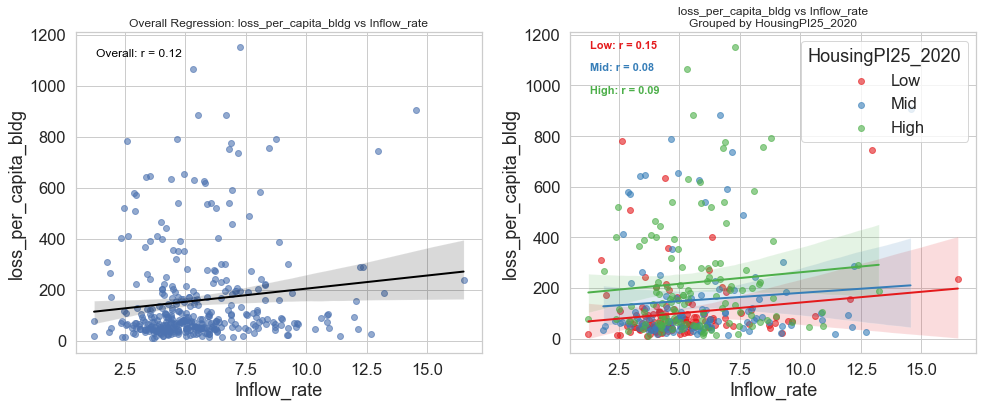

📊 Plot ID 21: X = Inflow_rate, Y = loss_per_capita_bldg, Z = HousingPI25_2024


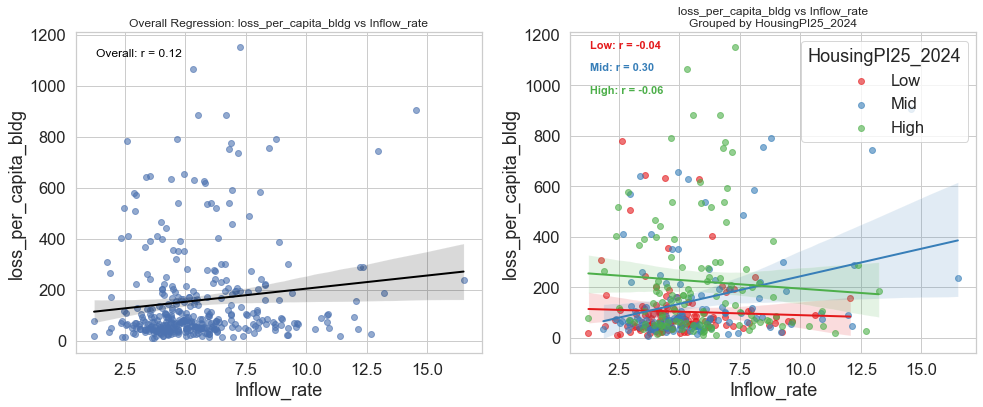

📊 Plot ID 22: X = Inflow_rate, Y = Outflow_rate, Z = loss_per_capita_pe


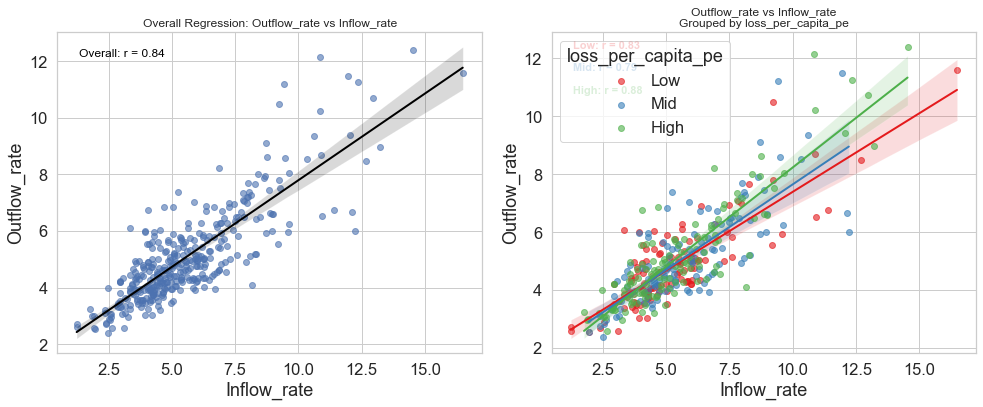

📊 Plot ID 23: X = Inflow_rate, Y = Outflow_rate, Z = loss_per_capita_bldg


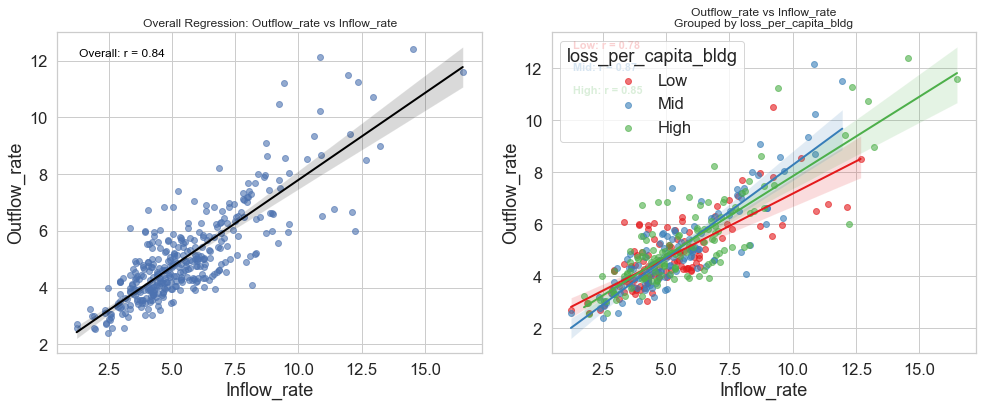

📊 Plot ID 24: X = Inflow_rate, Y = Outflow_rate, Z = Migration16to20_A_Outflow_Estimate


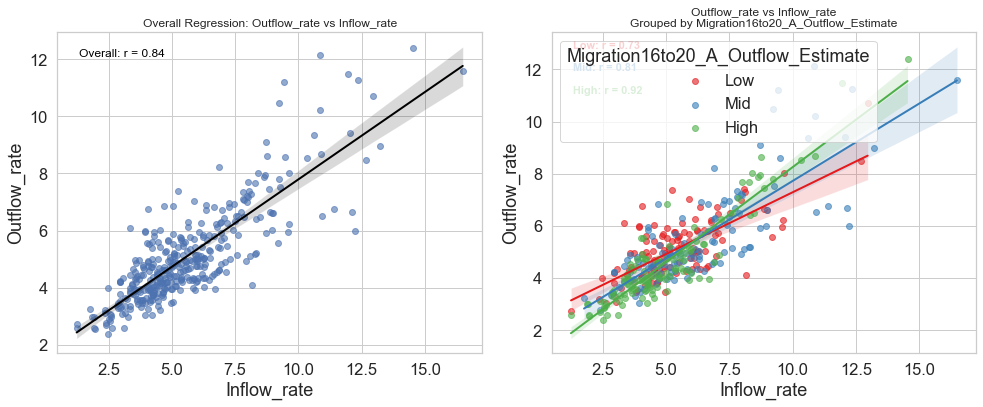

📊 Plot ID 25: X = Inflow_rate, Y = Outflow_rate, Z = HousingPI25_2000


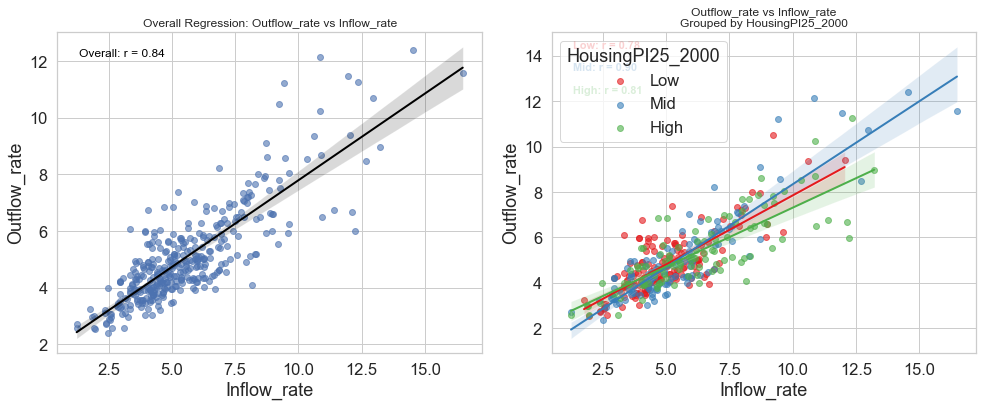

📊 Plot ID 26: X = Inflow_rate, Y = Outflow_rate, Z = HousingPI25_2010


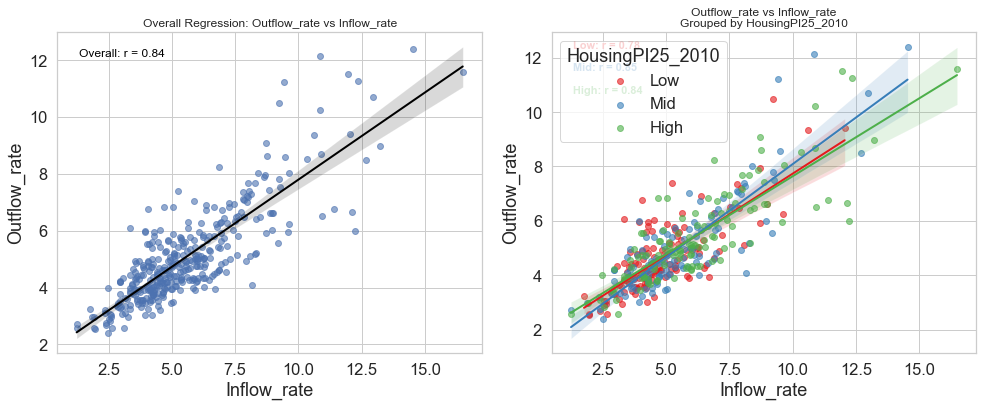

📊 Plot ID 27: X = Inflow_rate, Y = Outflow_rate, Z = HousingPI25_2020


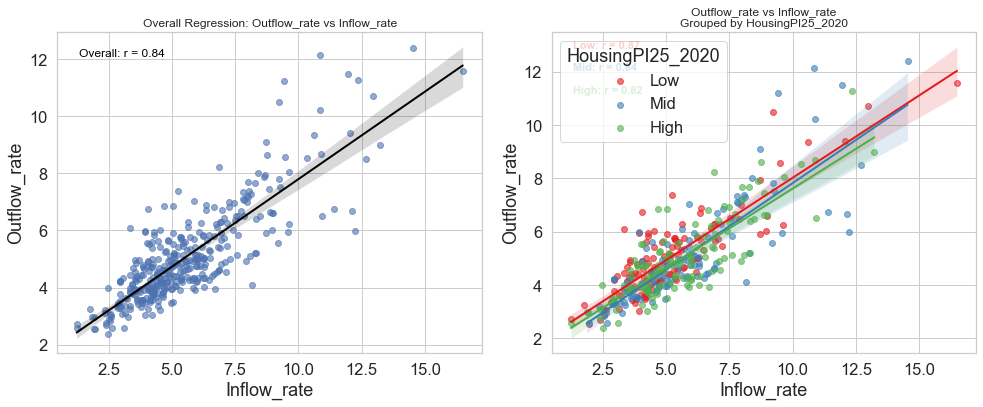

📊 Plot ID 28: X = Inflow_rate, Y = Outflow_rate, Z = HousingPI25_2024


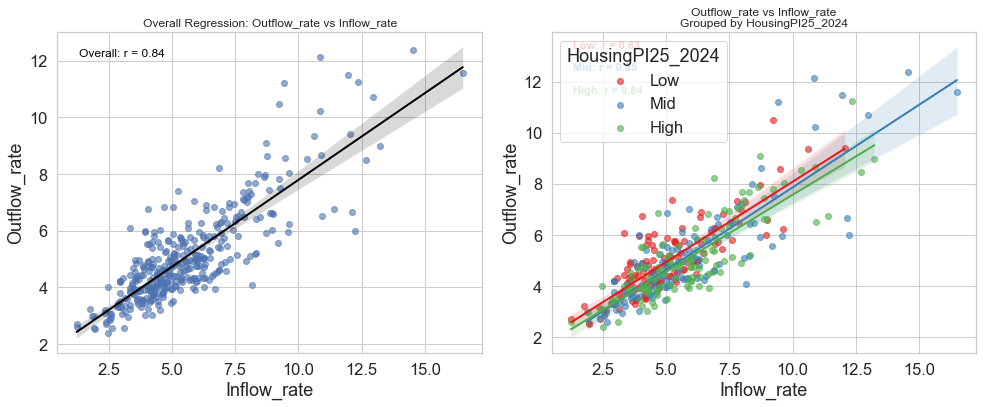

📊 Plot ID 29: X = Inflow_rate, Y = Migration16to20_A_Outflow_Estimate, Z = loss_per_capita_pe


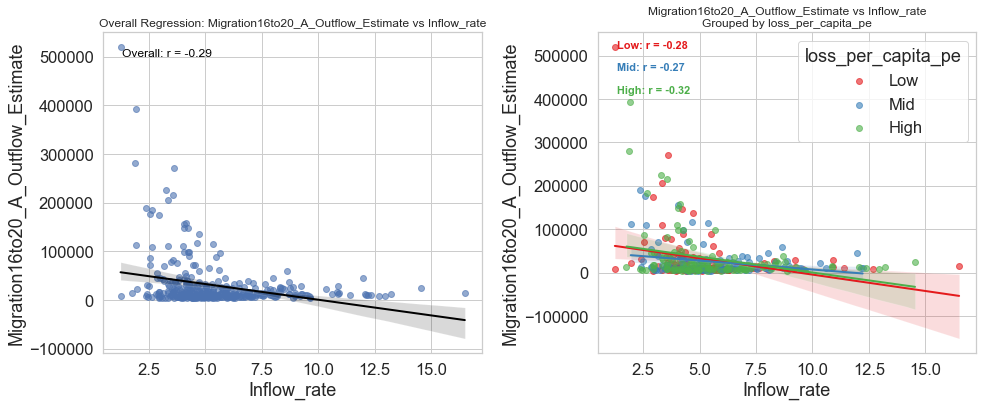

📊 Plot ID 30: X = Inflow_rate, Y = Migration16to20_A_Outflow_Estimate, Z = loss_per_capita_bldg


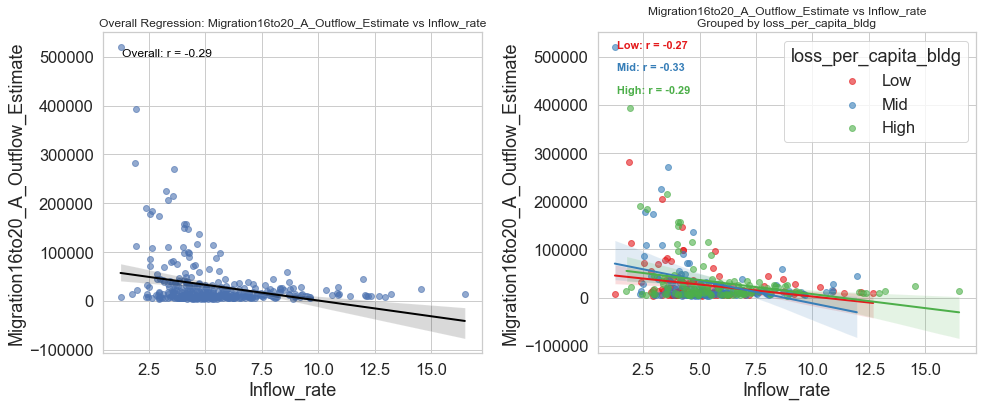

📊 Plot ID 31: X = Inflow_rate, Y = Migration16to20_A_Outflow_Estimate, Z = Outflow_rate


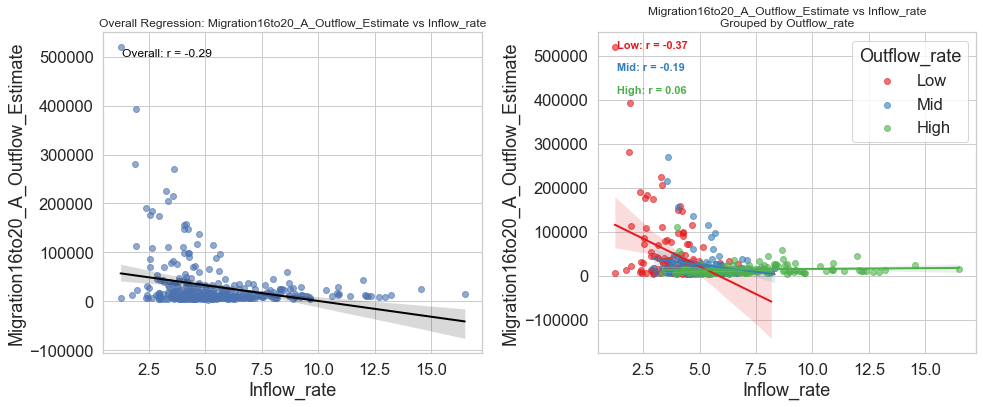

📊 Plot ID 32: X = Inflow_rate, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2000


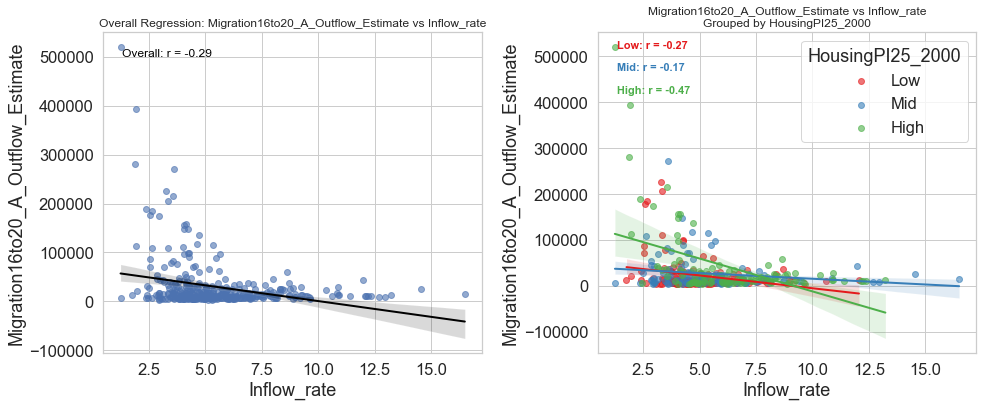

📊 Plot ID 33: X = Inflow_rate, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2010


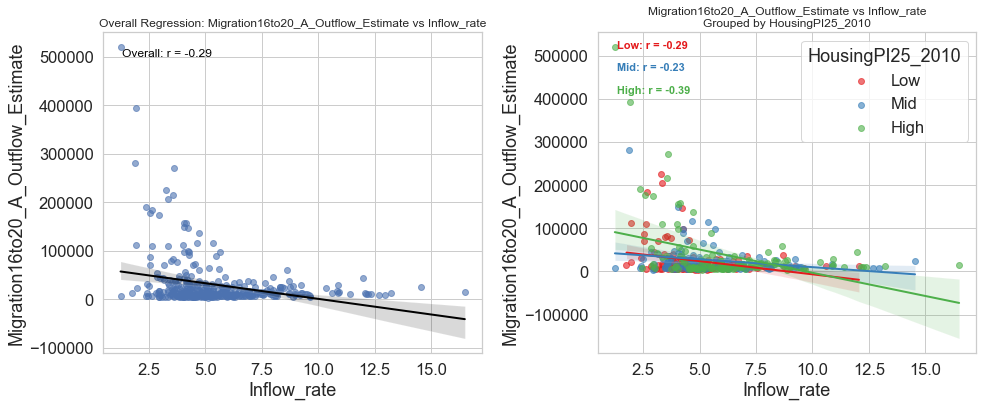

📊 Plot ID 34: X = Inflow_rate, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2020


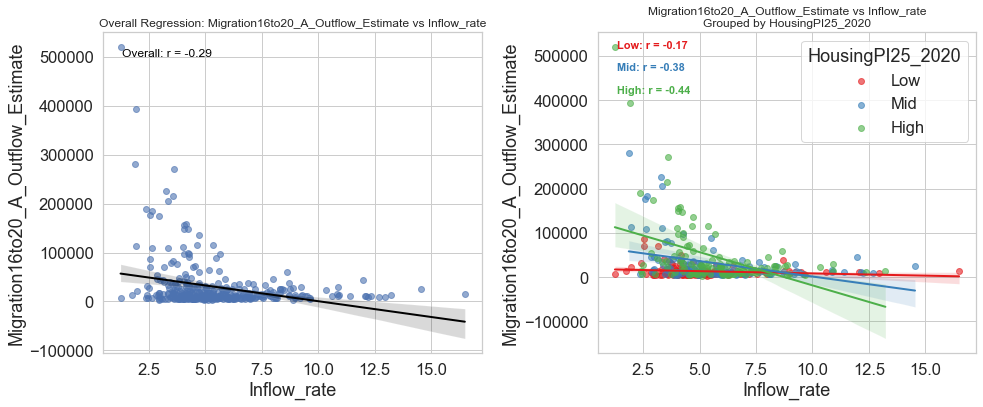

📊 Plot ID 35: X = Inflow_rate, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2024


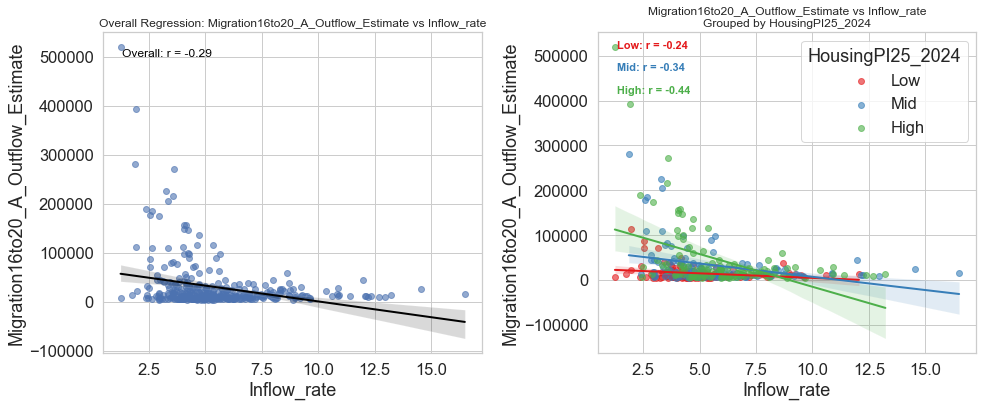

📊 Plot ID 36: X = Outflow_rate, Y = loss_per_capita_pe, Z = loss_per_capita_bldg


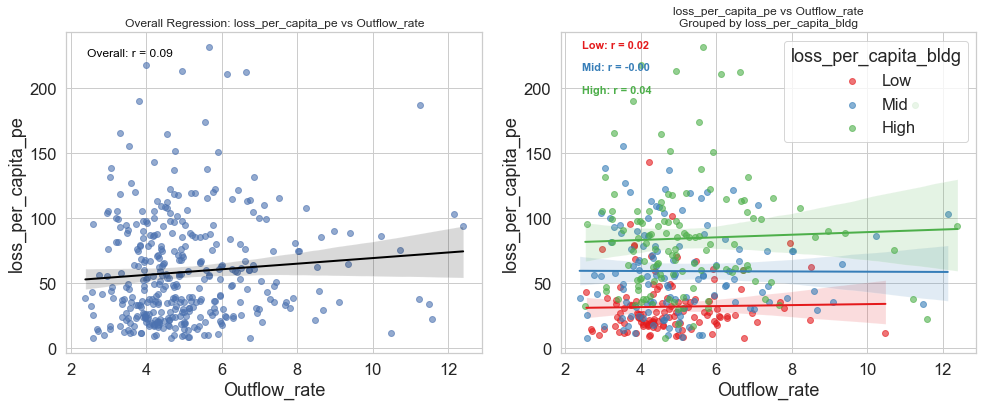

📊 Plot ID 37: X = Outflow_rate, Y = loss_per_capita_pe, Z = Inflow_rate


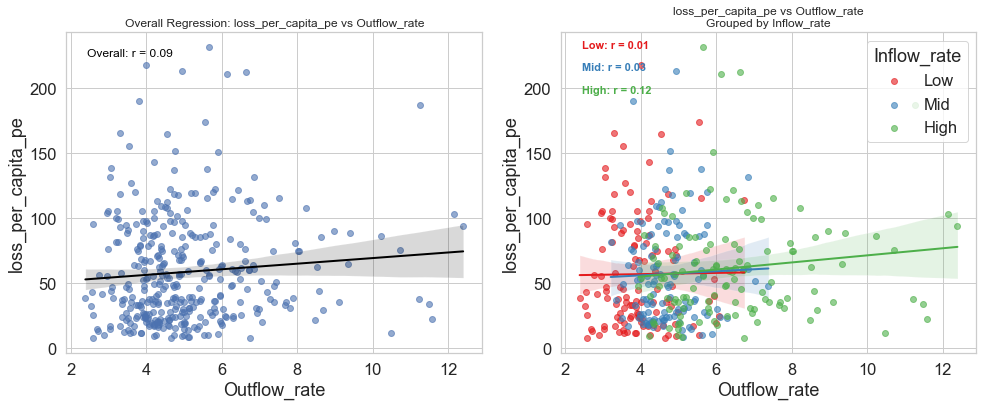

📊 Plot ID 38: X = Outflow_rate, Y = loss_per_capita_pe, Z = Migration16to20_A_Outflow_Estimate


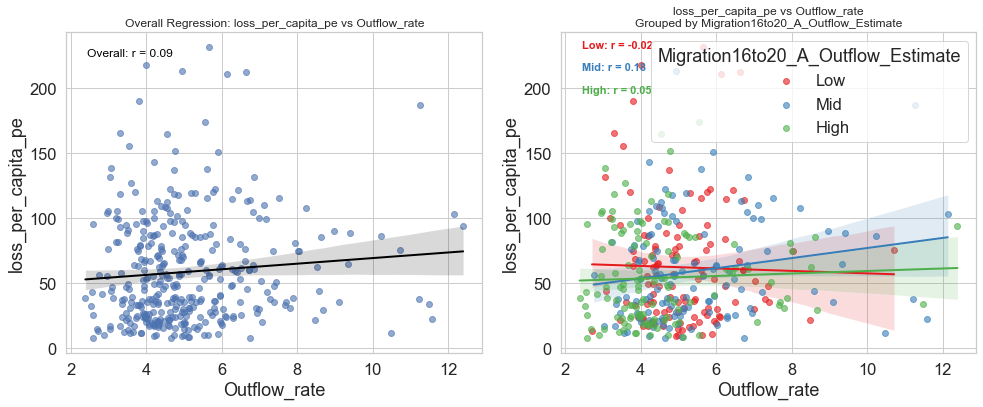

📊 Plot ID 39: X = Outflow_rate, Y = loss_per_capita_pe, Z = HousingPI25_2000


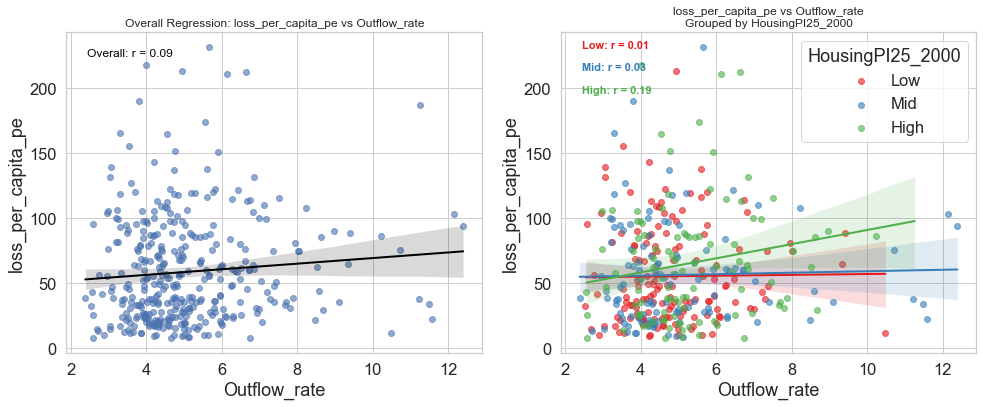

📊 Plot ID 40: X = Outflow_rate, Y = loss_per_capita_pe, Z = HousingPI25_2010


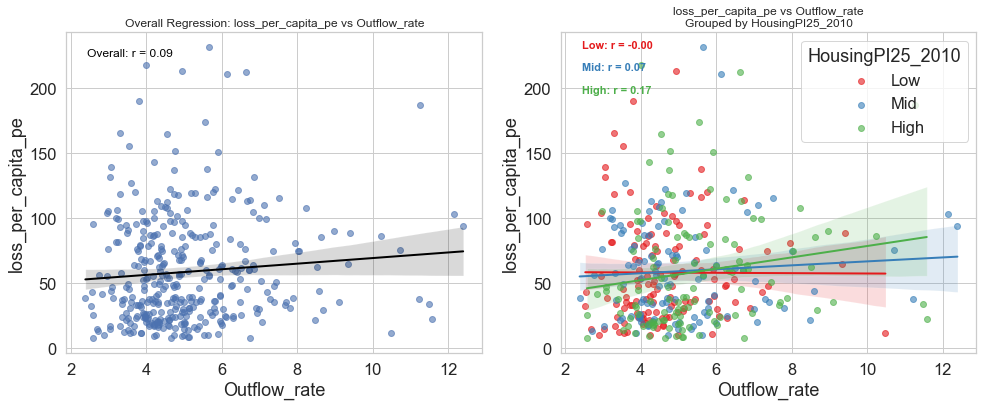

📊 Plot ID 41: X = Outflow_rate, Y = loss_per_capita_pe, Z = HousingPI25_2020


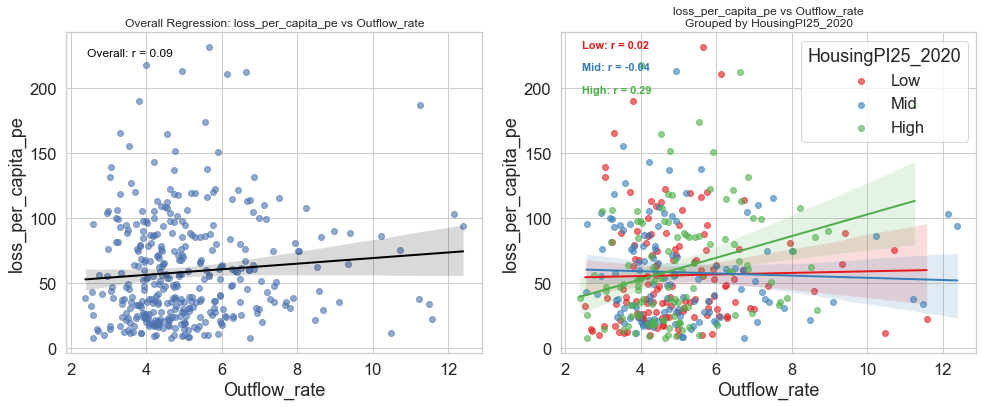

📊 Plot ID 42: X = Outflow_rate, Y = loss_per_capita_pe, Z = HousingPI25_2024


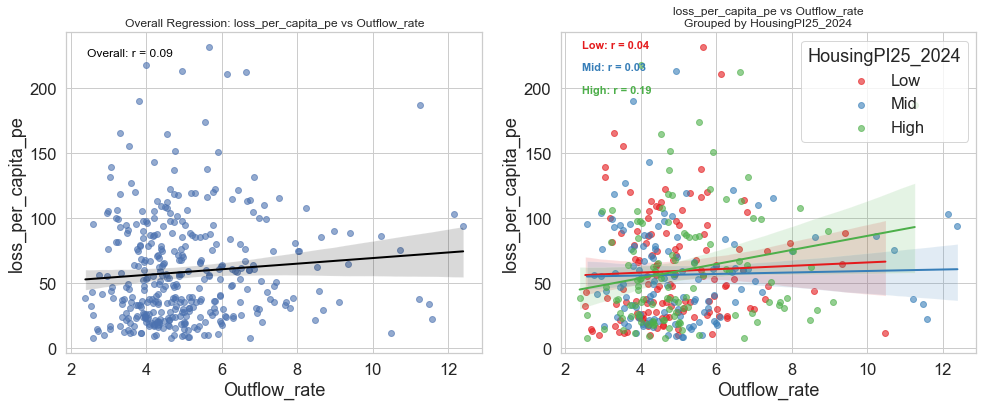

📊 Plot ID 43: X = Outflow_rate, Y = loss_per_capita_bldg, Z = loss_per_capita_pe


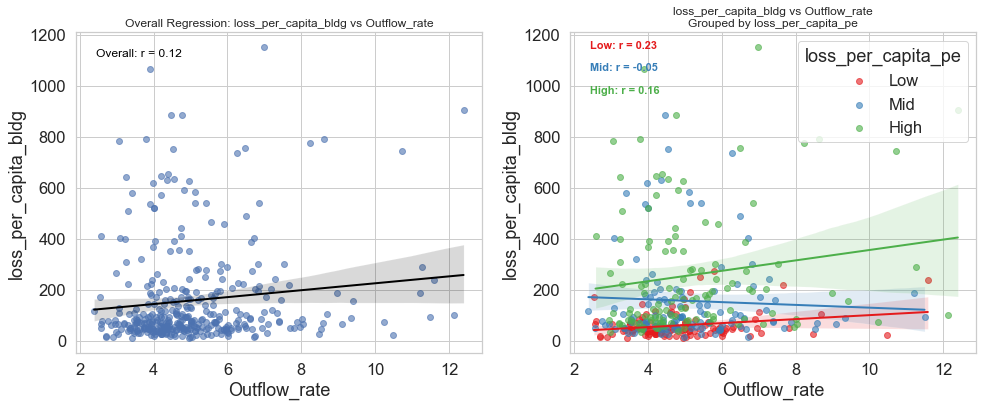

📊 Plot ID 44: X = Outflow_rate, Y = loss_per_capita_bldg, Z = Inflow_rate


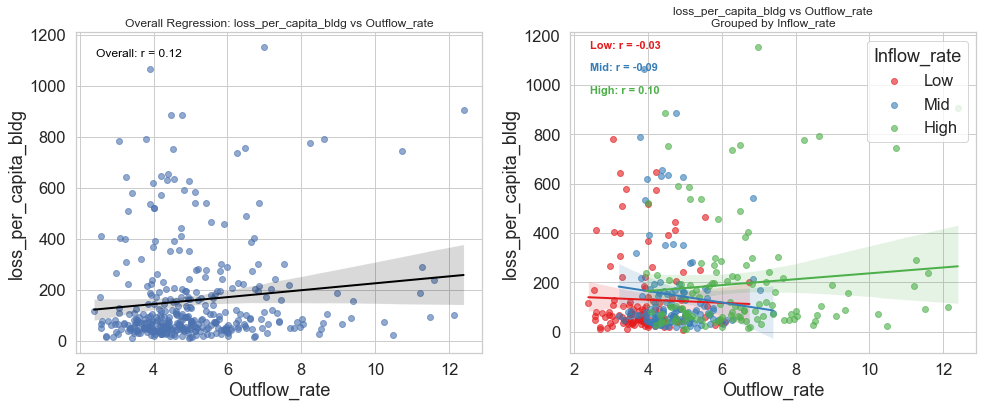

📊 Plot ID 45: X = Outflow_rate, Y = loss_per_capita_bldg, Z = Migration16to20_A_Outflow_Estimate


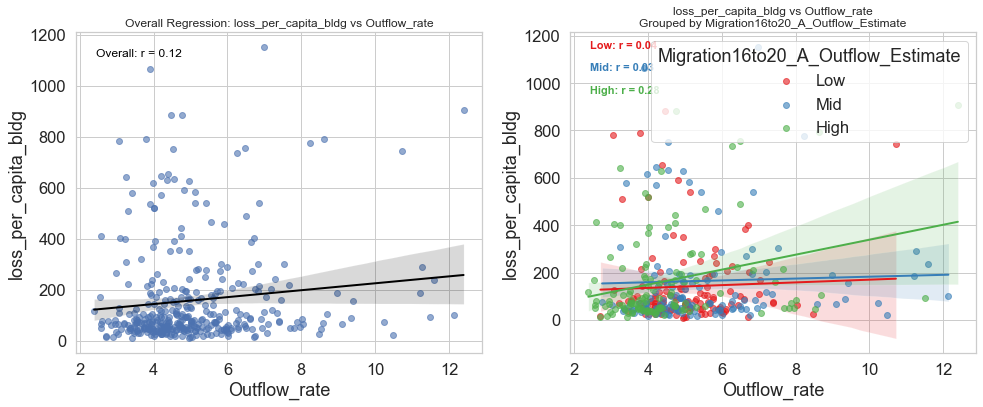

📊 Plot ID 46: X = Outflow_rate, Y = loss_per_capita_bldg, Z = HousingPI25_2000


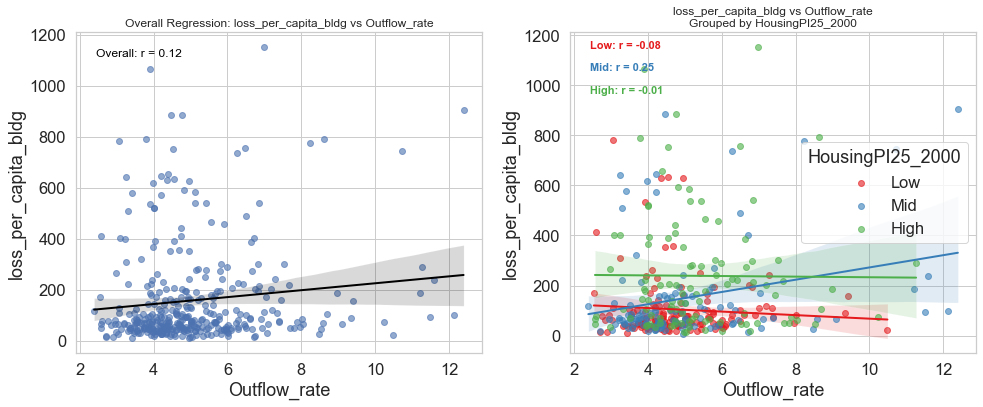

📊 Plot ID 47: X = Outflow_rate, Y = loss_per_capita_bldg, Z = HousingPI25_2010


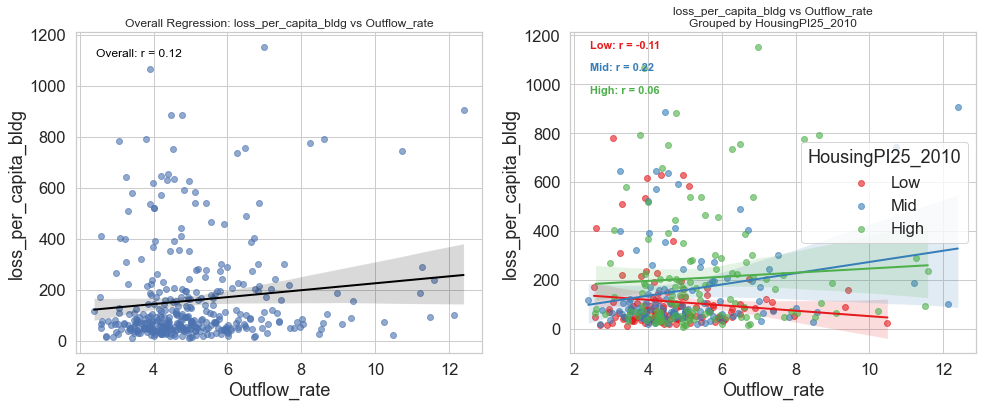

📊 Plot ID 48: X = Outflow_rate, Y = loss_per_capita_bldg, Z = HousingPI25_2020


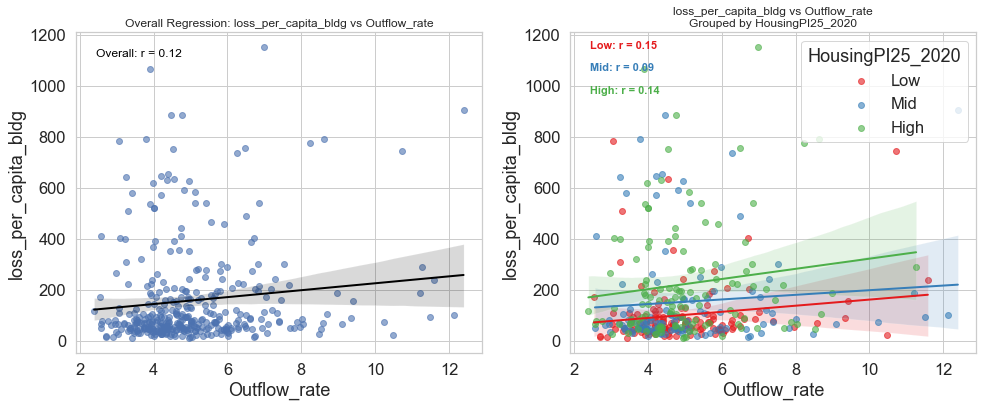

📊 Plot ID 49: X = Outflow_rate, Y = loss_per_capita_bldg, Z = HousingPI25_2024


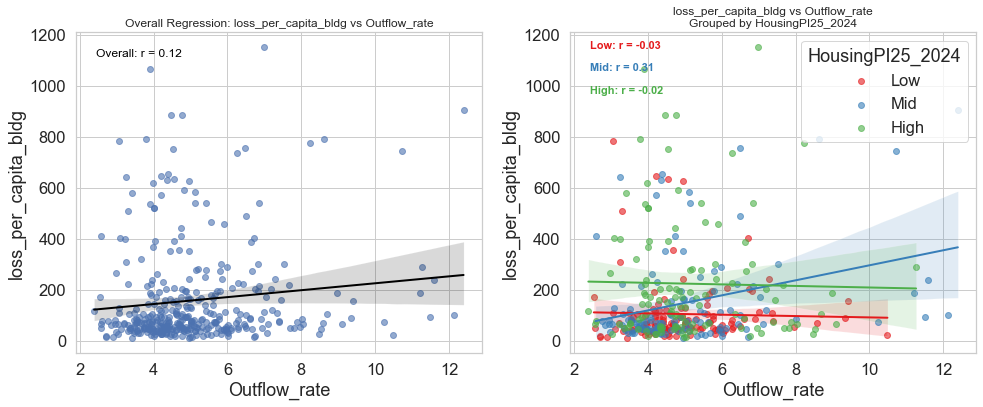

📊 Plot ID 50: X = Migration16to20_A_Outflow_Estimate, Y = loss_per_capita_pe, Z = loss_per_capita_bldg


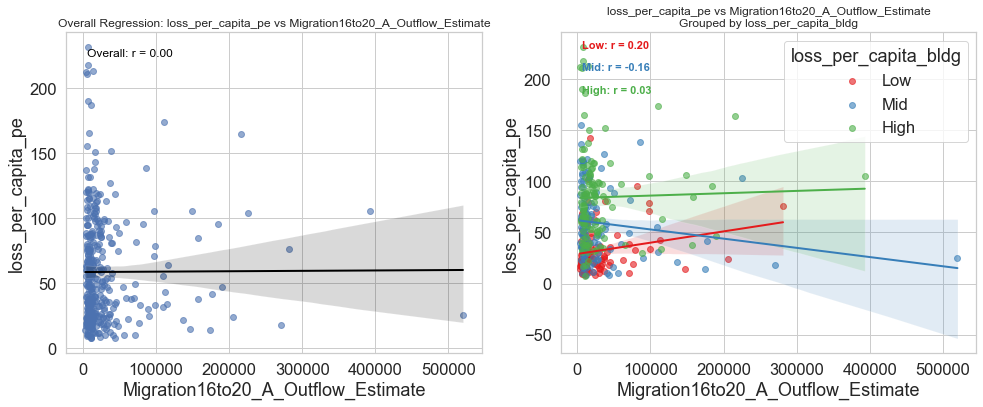

📊 Plot ID 51: X = Migration16to20_A_Outflow_Estimate, Y = loss_per_capita_pe, Z = Inflow_rate


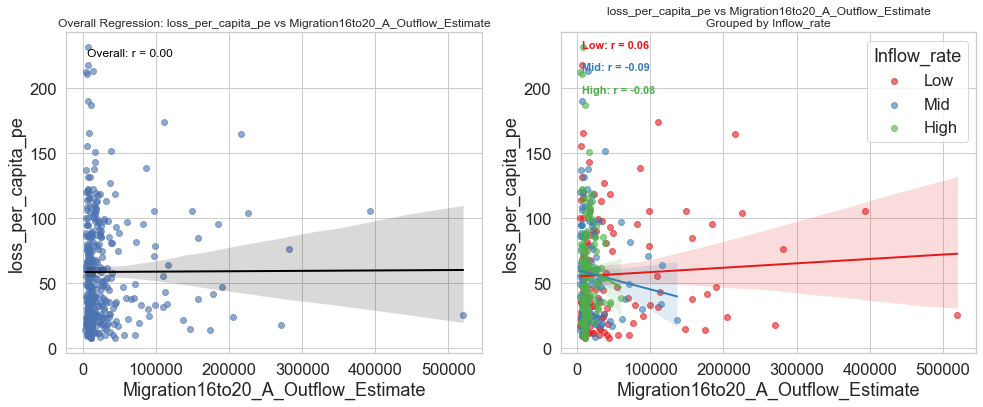

📊 Plot ID 52: X = Migration16to20_A_Outflow_Estimate, Y = loss_per_capita_pe, Z = Outflow_rate


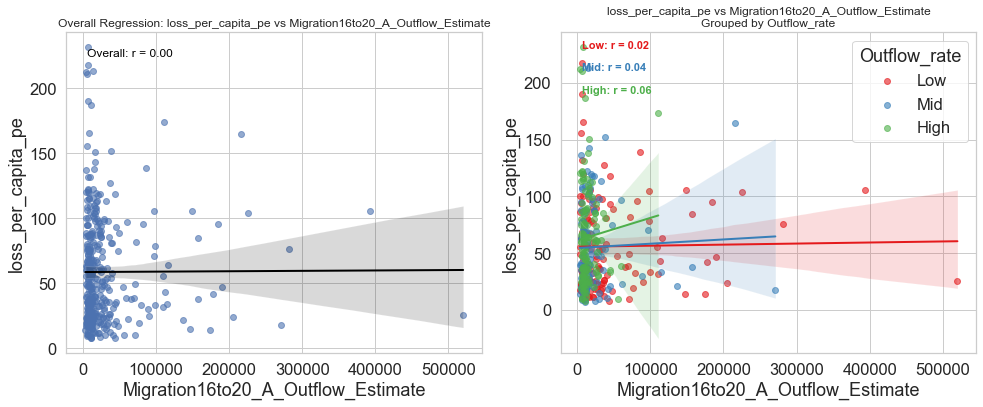

📊 Plot ID 53: X = Migration16to20_A_Outflow_Estimate, Y = loss_per_capita_pe, Z = HousingPI25_2000


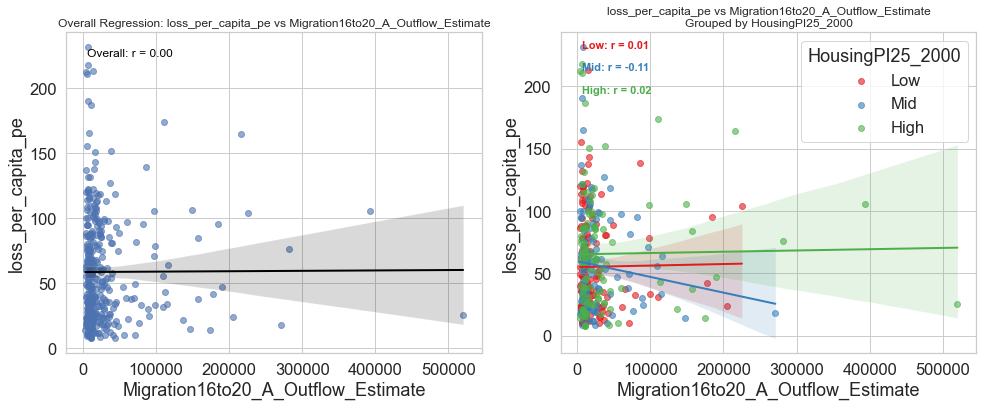

📊 Plot ID 54: X = Migration16to20_A_Outflow_Estimate, Y = loss_per_capita_pe, Z = HousingPI25_2010


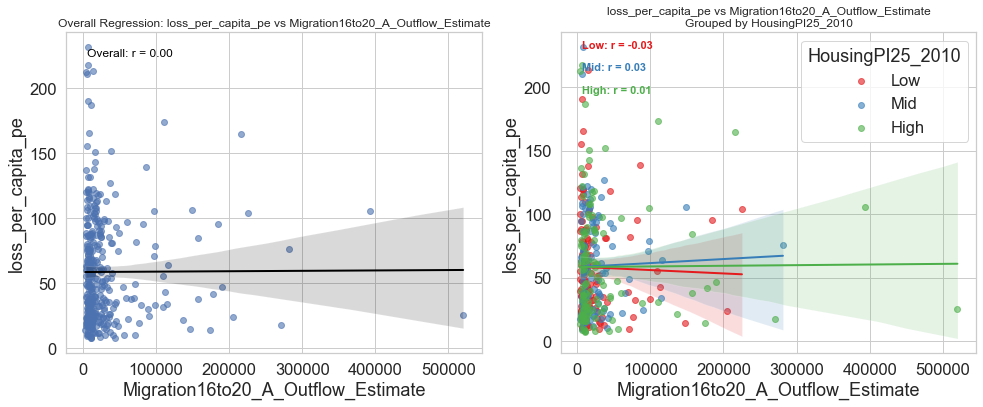

📊 Plot ID 55: X = Migration16to20_A_Outflow_Estimate, Y = loss_per_capita_pe, Z = HousingPI25_2020


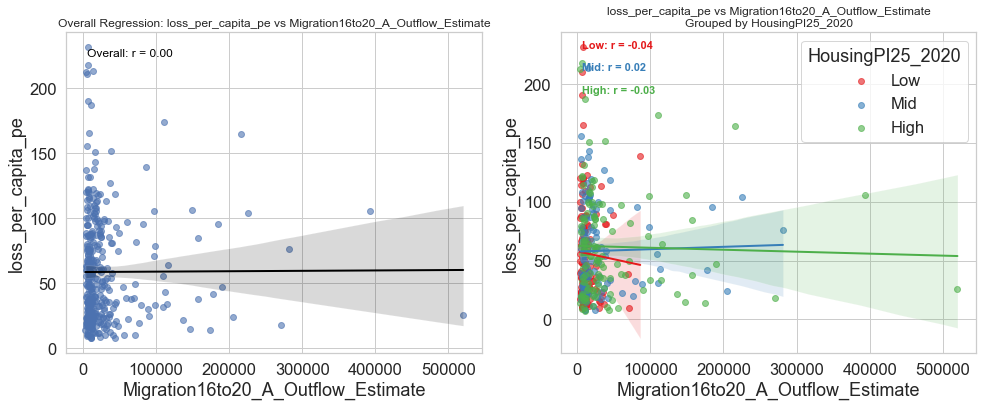

📊 Plot ID 56: X = Migration16to20_A_Outflow_Estimate, Y = loss_per_capita_pe, Z = HousingPI25_2024


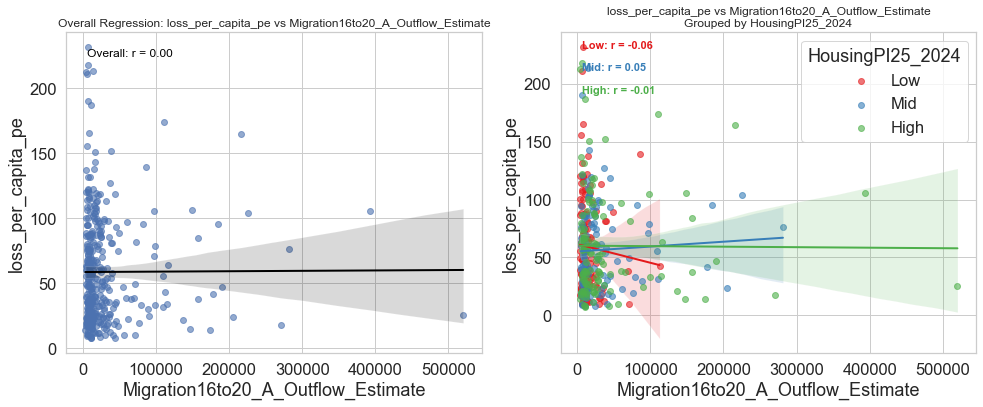

📊 Plot ID 57: X = Migration16to20_A_Outflow_Estimate, Y = loss_per_capita_bldg, Z = loss_per_capita_pe


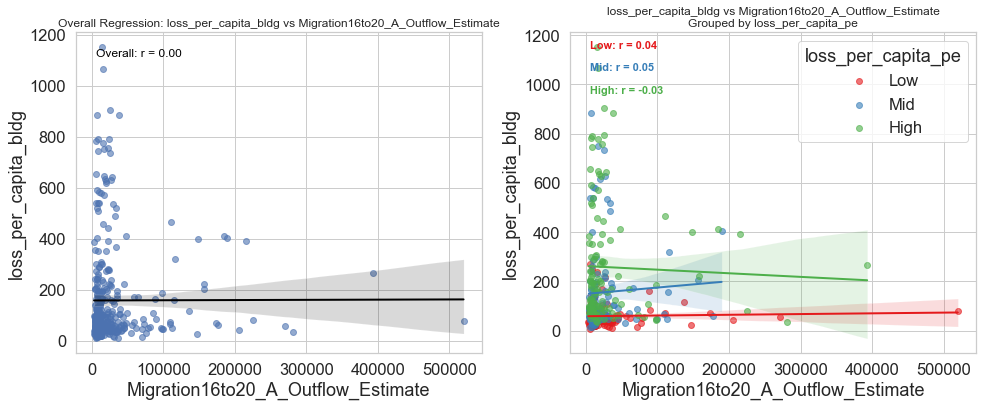

📊 Plot ID 58: X = Migration16to20_A_Outflow_Estimate, Y = loss_per_capita_bldg, Z = Inflow_rate


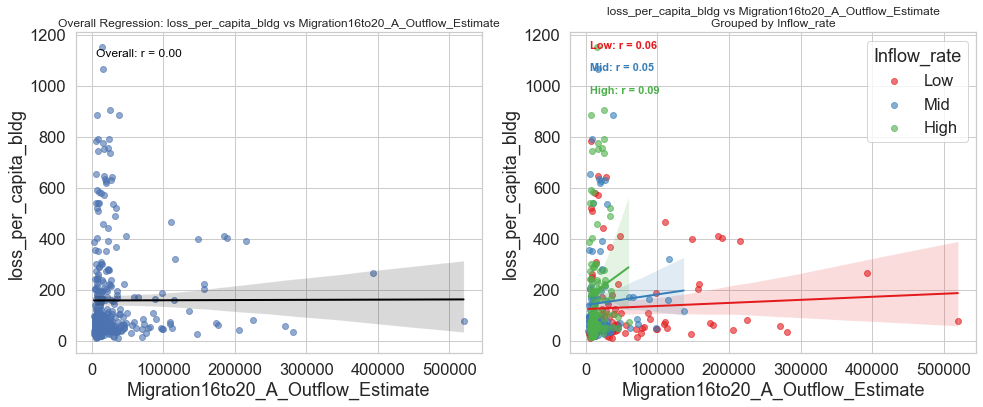

📊 Plot ID 59: X = Migration16to20_A_Outflow_Estimate, Y = loss_per_capita_bldg, Z = Outflow_rate


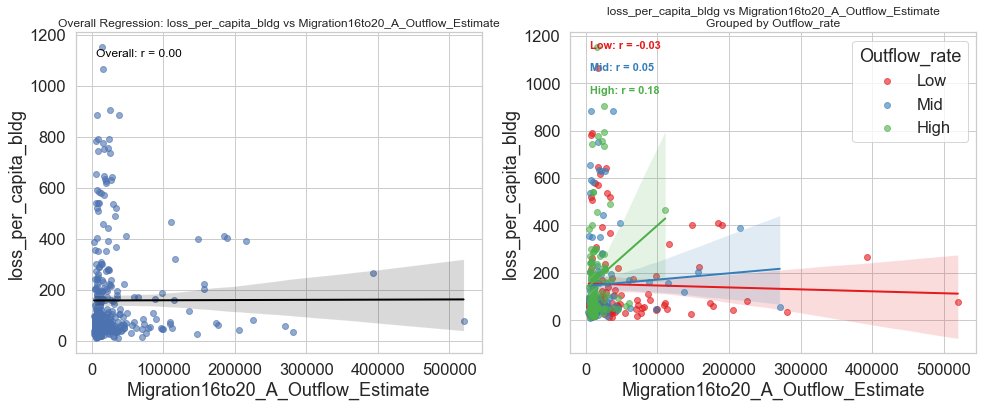

📊 Plot ID 60: X = Migration16to20_A_Outflow_Estimate, Y = loss_per_capita_bldg, Z = HousingPI25_2000


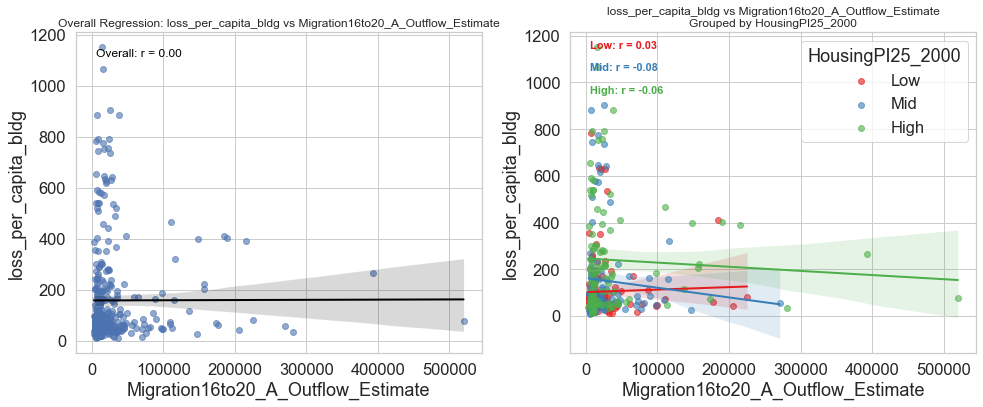

📊 Plot ID 61: X = Migration16to20_A_Outflow_Estimate, Y = loss_per_capita_bldg, Z = HousingPI25_2010


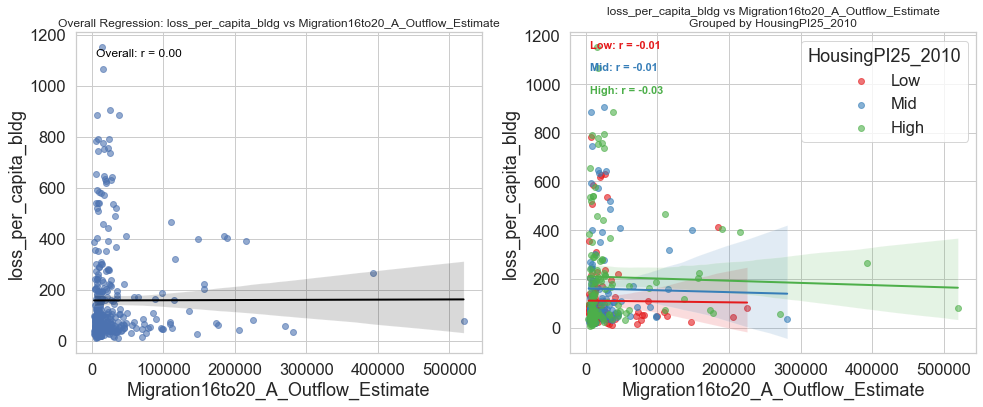

📊 Plot ID 62: X = Migration16to20_A_Outflow_Estimate, Y = loss_per_capita_bldg, Z = HousingPI25_2020


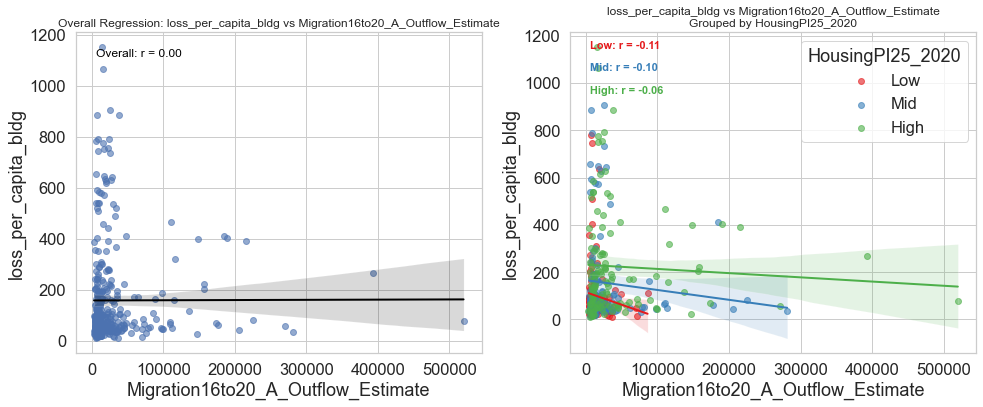

📊 Plot ID 63: X = Migration16to20_A_Outflow_Estimate, Y = loss_per_capita_bldg, Z = HousingPI25_2024


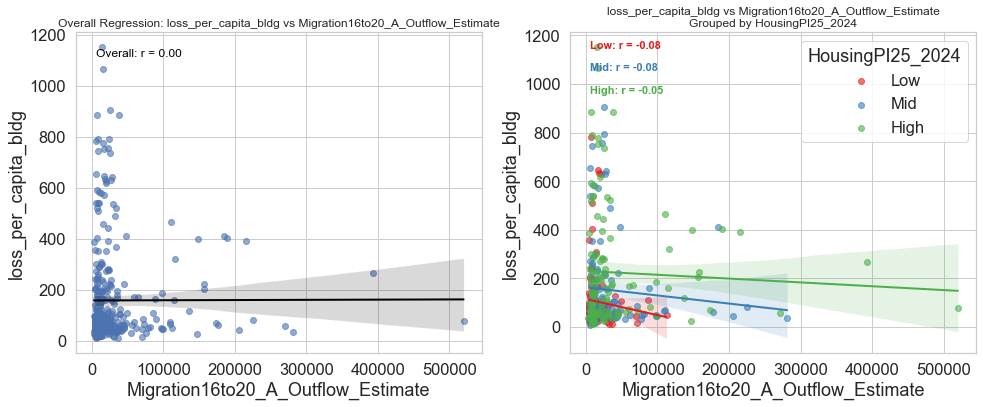

📊 Plot ID 64: X = Migration16to20_A_Outflow_Estimate, Y = Outflow_rate, Z = loss_per_capita_pe


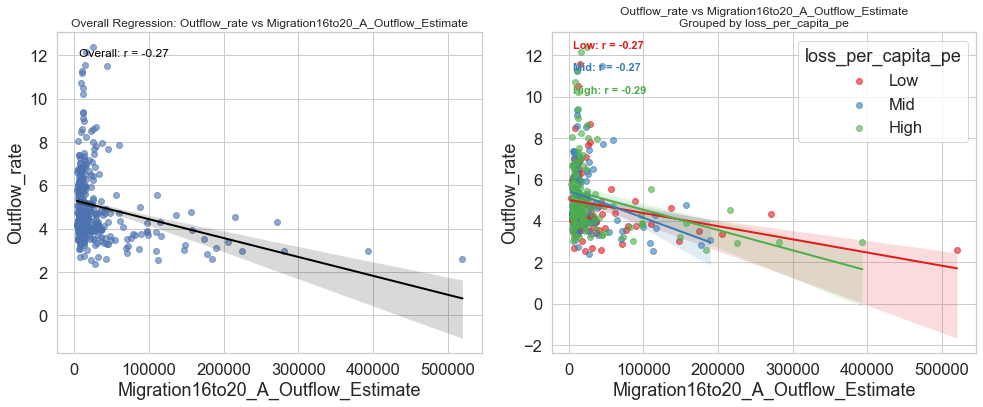

📊 Plot ID 65: X = Migration16to20_A_Outflow_Estimate, Y = Outflow_rate, Z = loss_per_capita_bldg


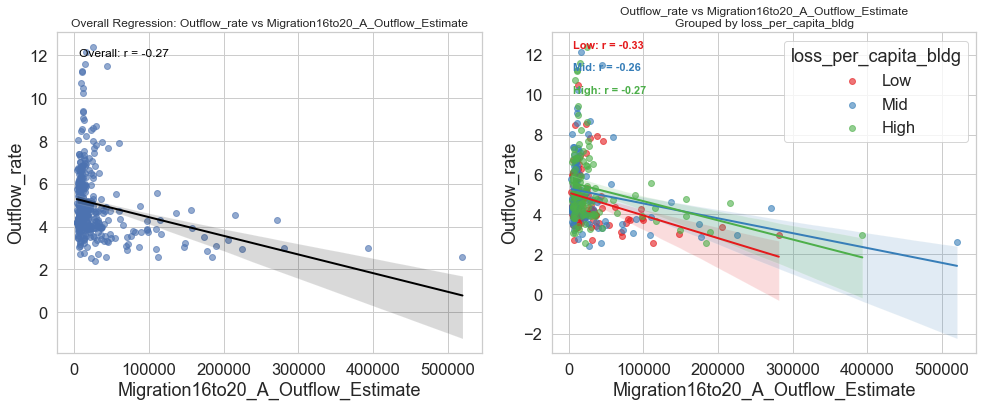

📊 Plot ID 66: X = Migration16to20_A_Outflow_Estimate, Y = Outflow_rate, Z = Inflow_rate


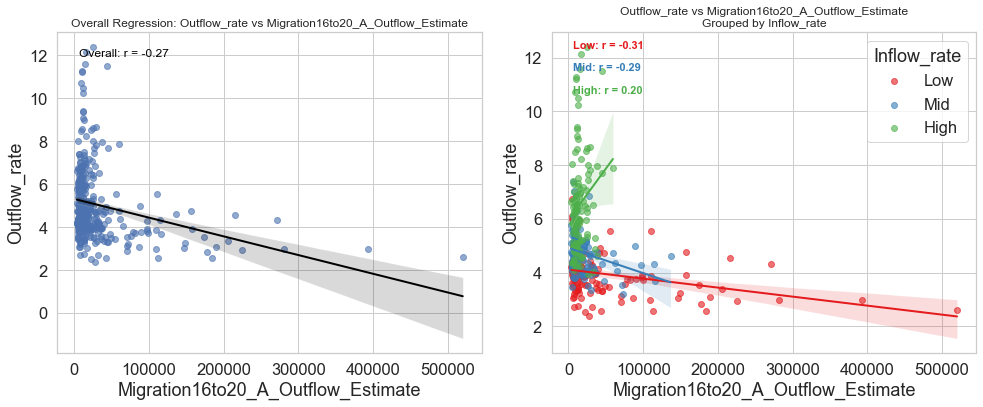

📊 Plot ID 67: X = Migration16to20_A_Outflow_Estimate, Y = Outflow_rate, Z = HousingPI25_2000


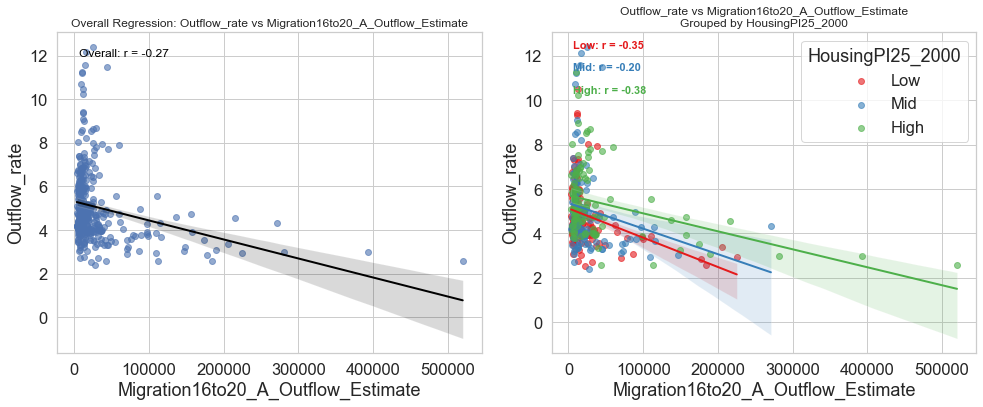

📊 Plot ID 68: X = Migration16to20_A_Outflow_Estimate, Y = Outflow_rate, Z = HousingPI25_2010


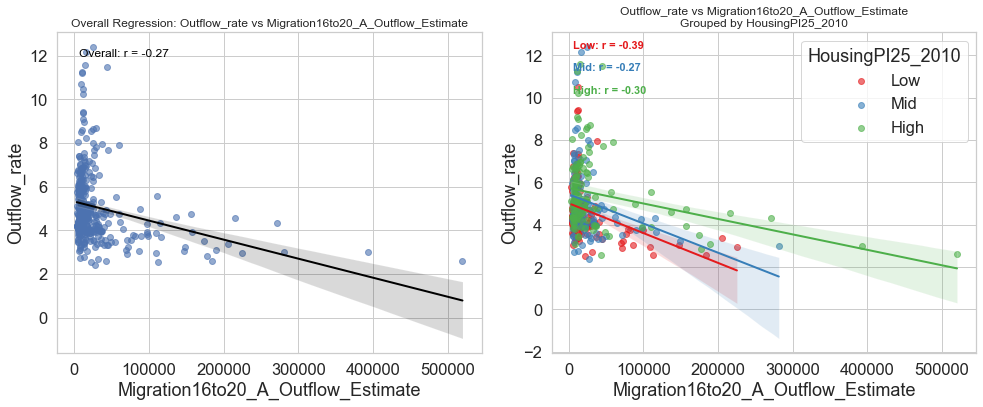

📊 Plot ID 69: X = Migration16to20_A_Outflow_Estimate, Y = Outflow_rate, Z = HousingPI25_2020


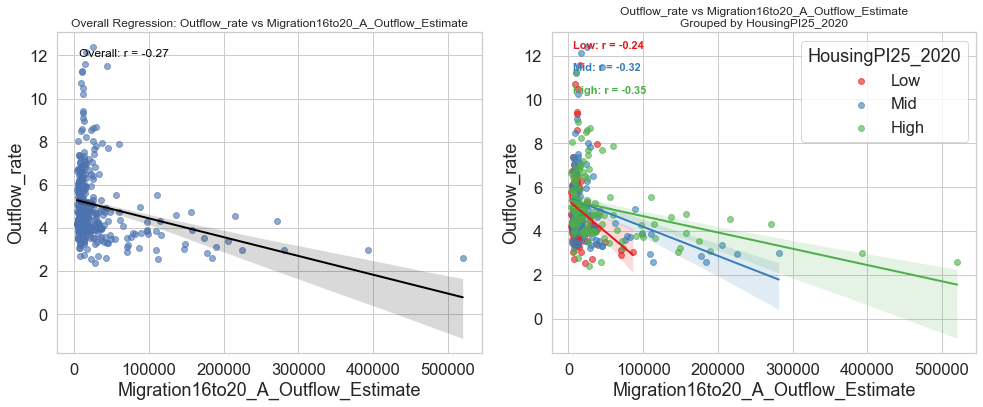

📊 Plot ID 70: X = Migration16to20_A_Outflow_Estimate, Y = Outflow_rate, Z = HousingPI25_2024


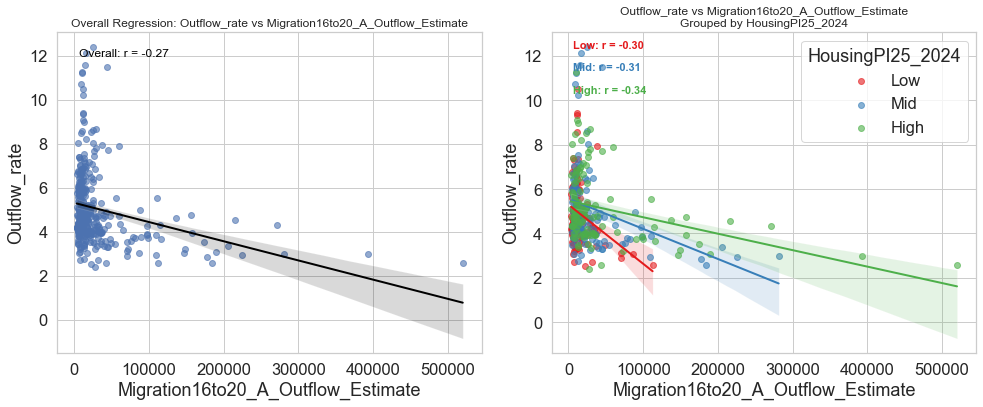

📊 Plot ID 71: X = HousingPI25_2000, Y = loss_per_capita_pe, Z = loss_per_capita_bldg


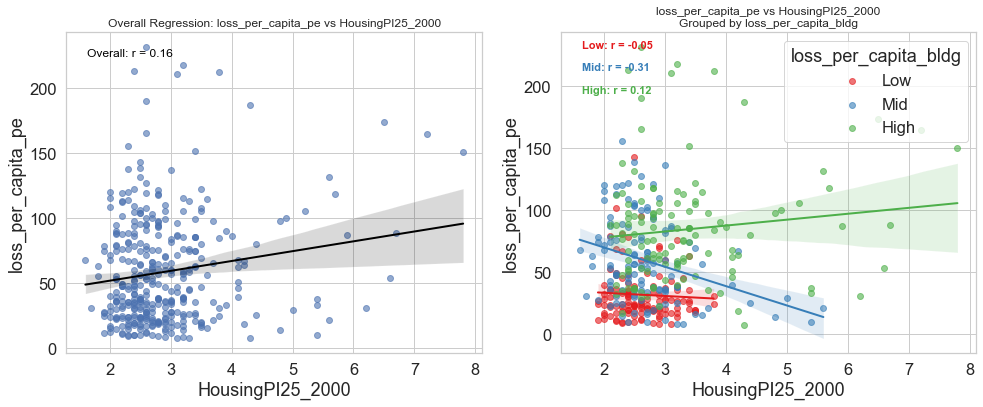

📊 Plot ID 72: X = HousingPI25_2000, Y = loss_per_capita_pe, Z = Inflow_rate


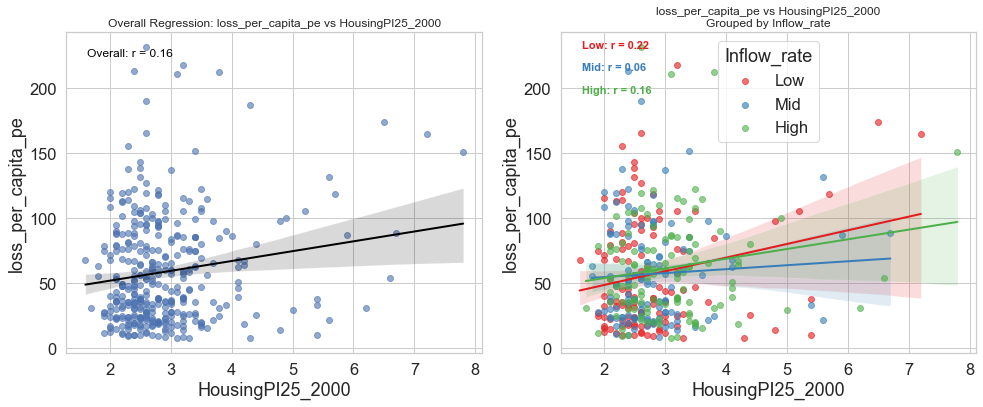

📊 Plot ID 73: X = HousingPI25_2000, Y = loss_per_capita_pe, Z = Outflow_rate


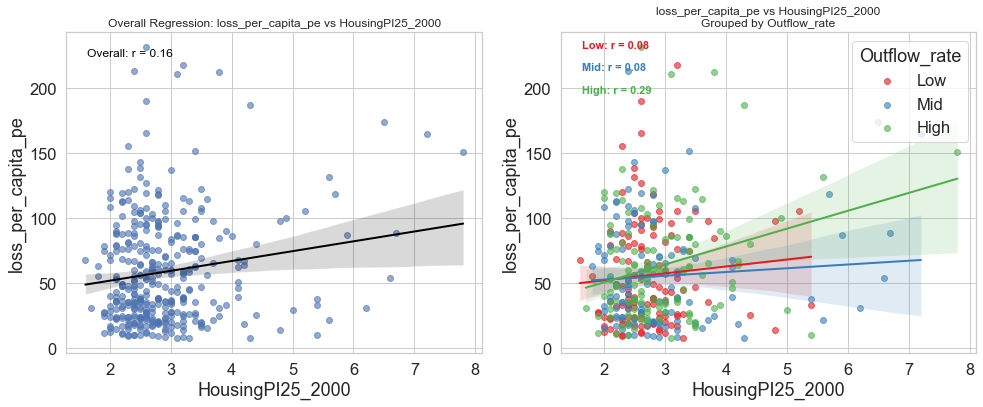

📊 Plot ID 74: X = HousingPI25_2000, Y = loss_per_capita_pe, Z = Migration16to20_A_Outflow_Estimate


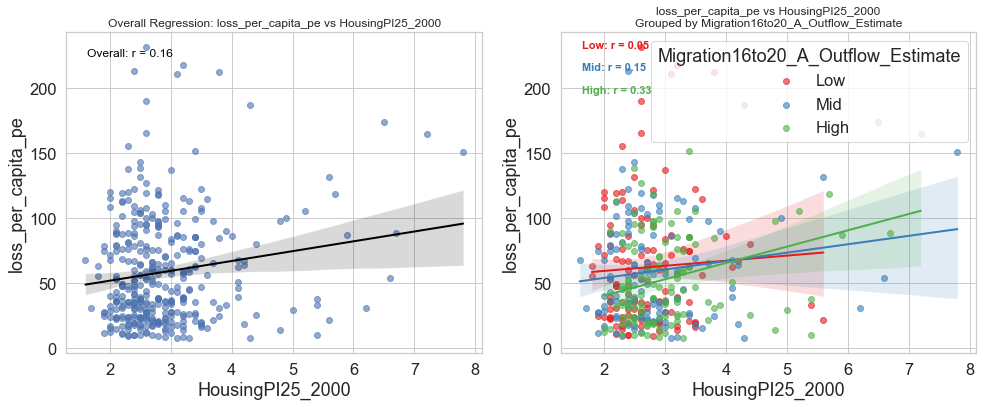

📊 Plot ID 75: X = HousingPI25_2000, Y = loss_per_capita_pe, Z = HousingPI25_2010


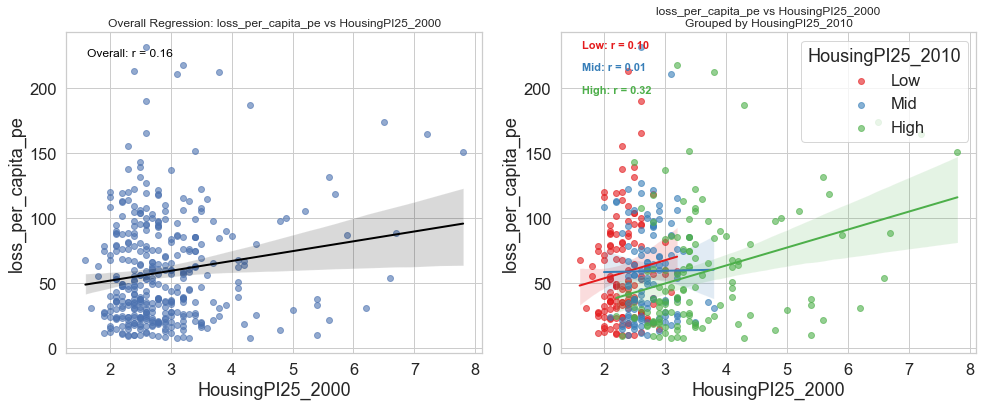

📊 Plot ID 76: X = HousingPI25_2000, Y = loss_per_capita_pe, Z = HousingPI25_2020


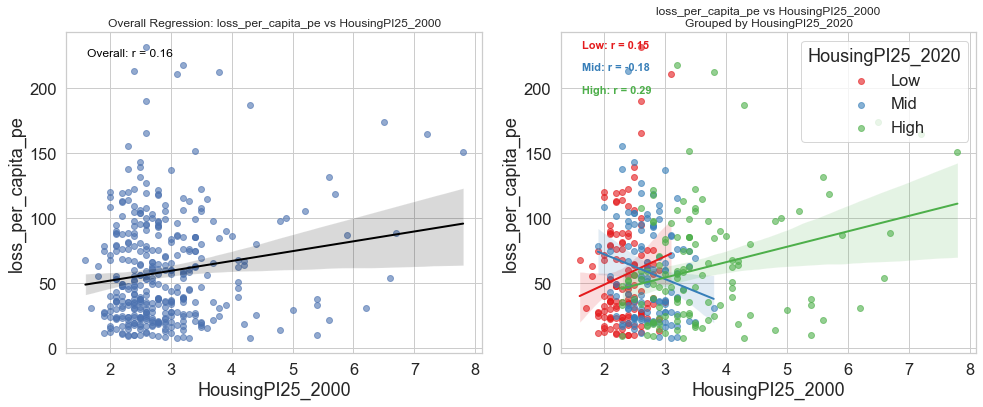

📊 Plot ID 77: X = HousingPI25_2000, Y = loss_per_capita_pe, Z = HousingPI25_2024


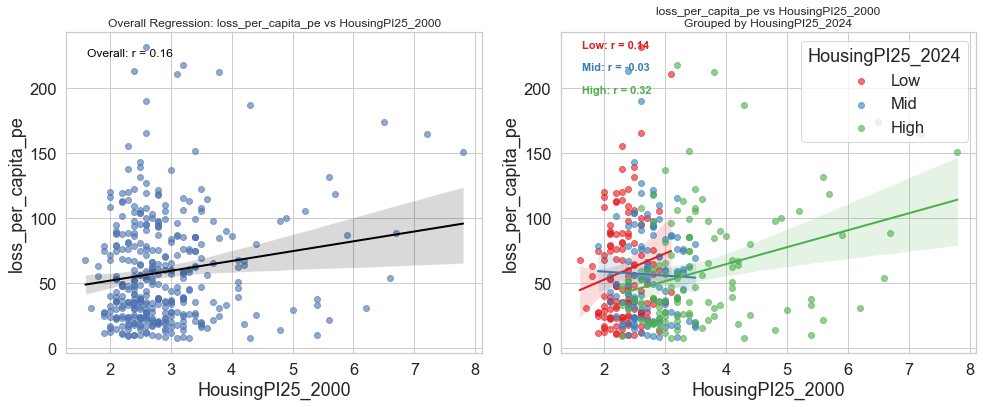

📊 Plot ID 78: X = HousingPI25_2000, Y = loss_per_capita_bldg, Z = loss_per_capita_pe


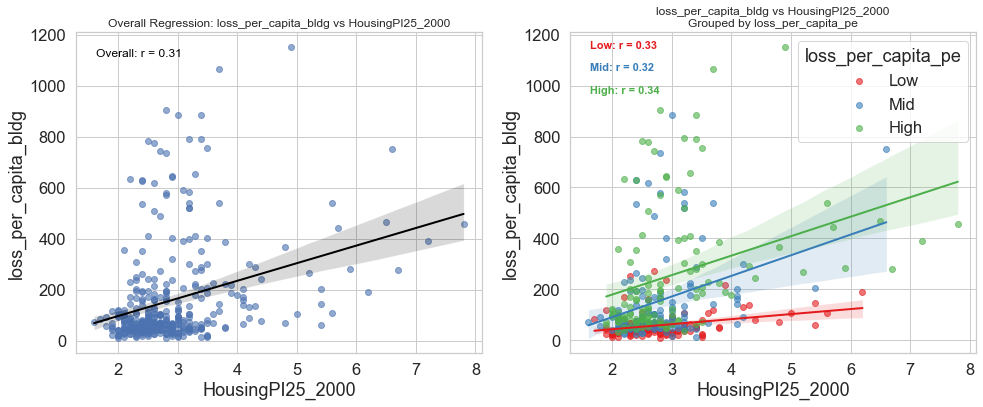

📊 Plot ID 79: X = HousingPI25_2000, Y = loss_per_capita_bldg, Z = Inflow_rate


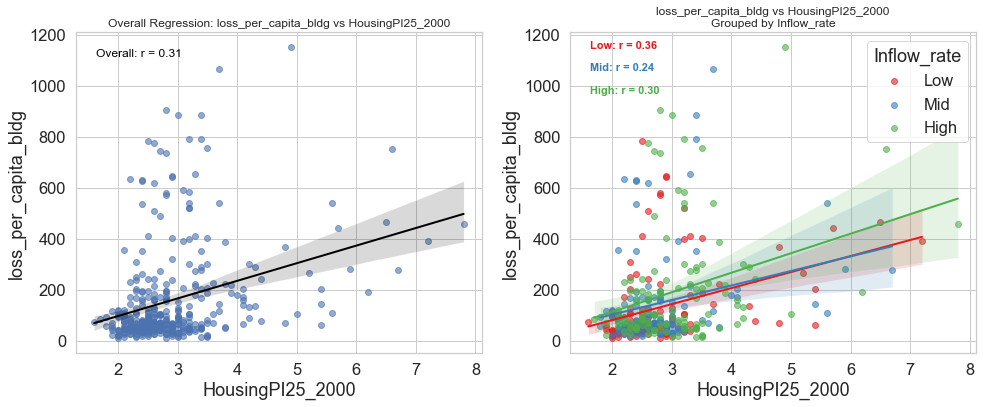

📊 Plot ID 80: X = HousingPI25_2000, Y = loss_per_capita_bldg, Z = Outflow_rate


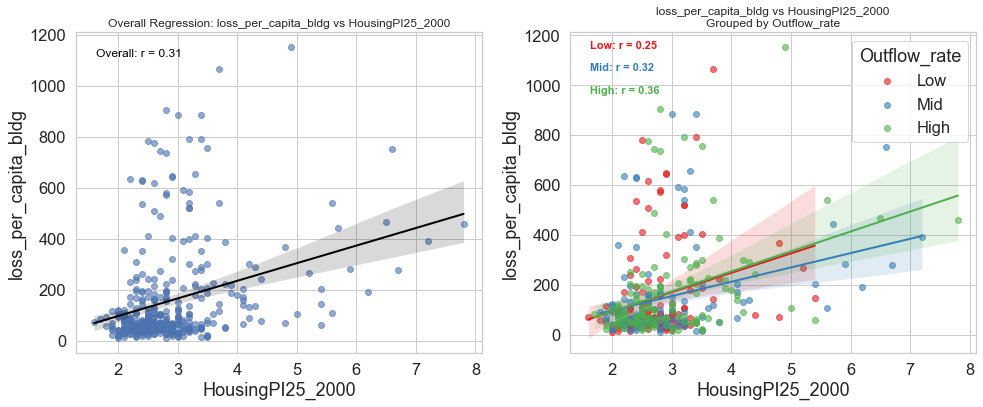

📊 Plot ID 81: X = HousingPI25_2000, Y = loss_per_capita_bldg, Z = Migration16to20_A_Outflow_Estimate


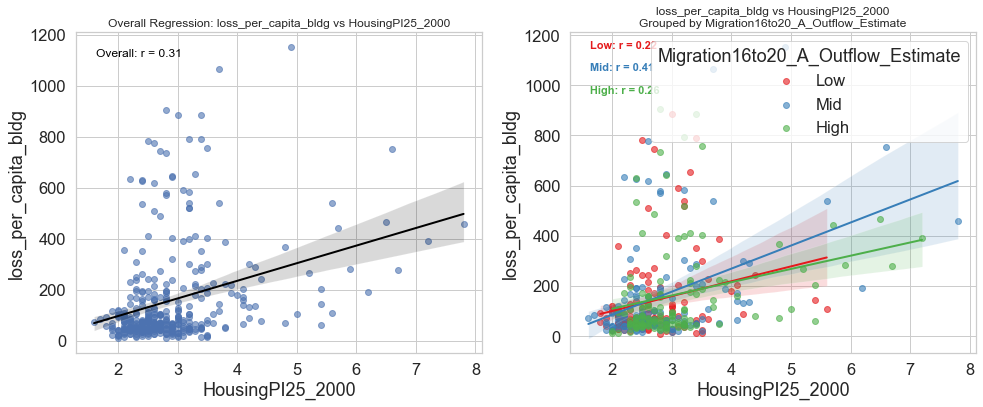

📊 Plot ID 82: X = HousingPI25_2000, Y = loss_per_capita_bldg, Z = HousingPI25_2010


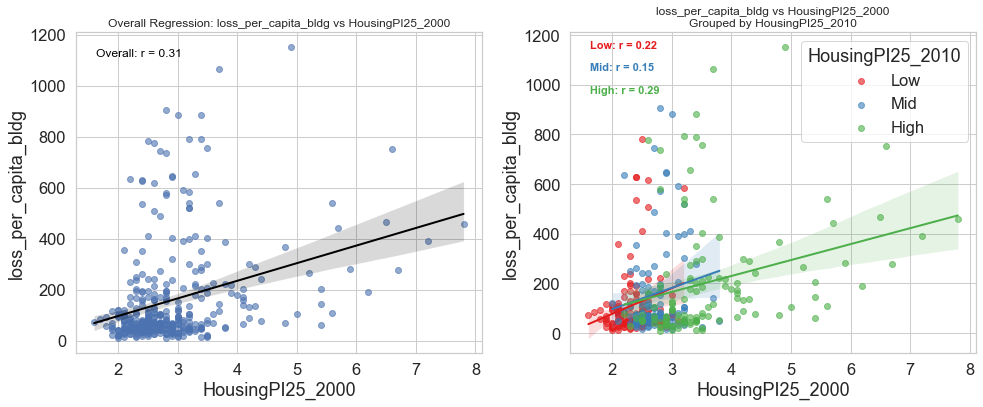

📊 Plot ID 83: X = HousingPI25_2000, Y = loss_per_capita_bldg, Z = HousingPI25_2020


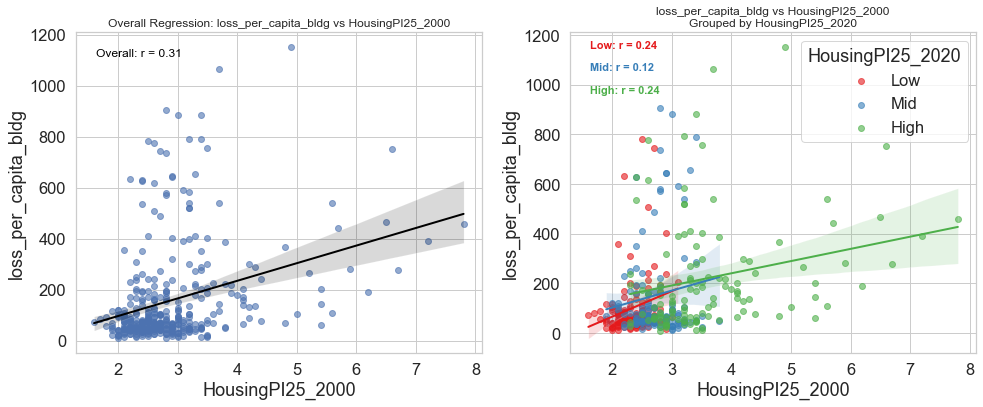

📊 Plot ID 84: X = HousingPI25_2000, Y = loss_per_capita_bldg, Z = HousingPI25_2024


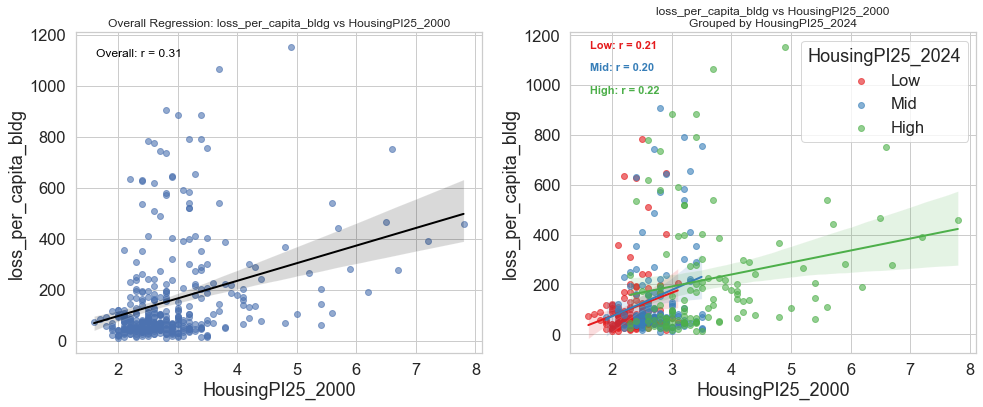

📊 Plot ID 85: X = HousingPI25_2000, Y = Inflow_rate, Z = loss_per_capita_pe


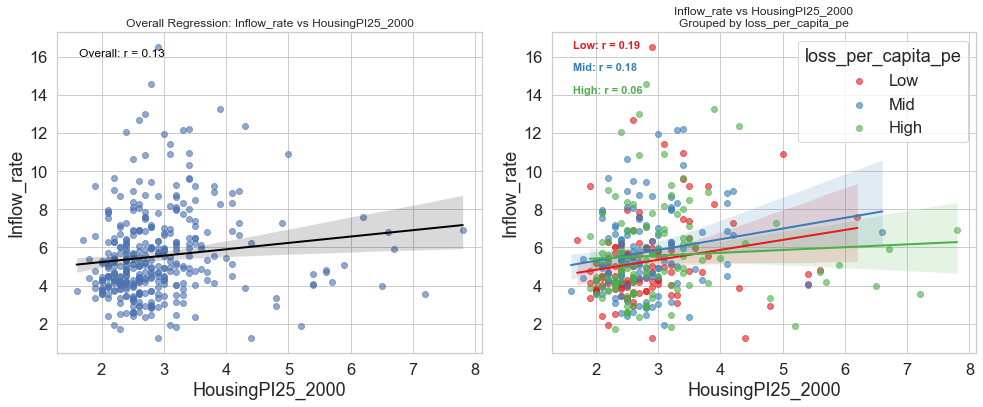

📊 Plot ID 86: X = HousingPI25_2000, Y = Inflow_rate, Z = loss_per_capita_bldg


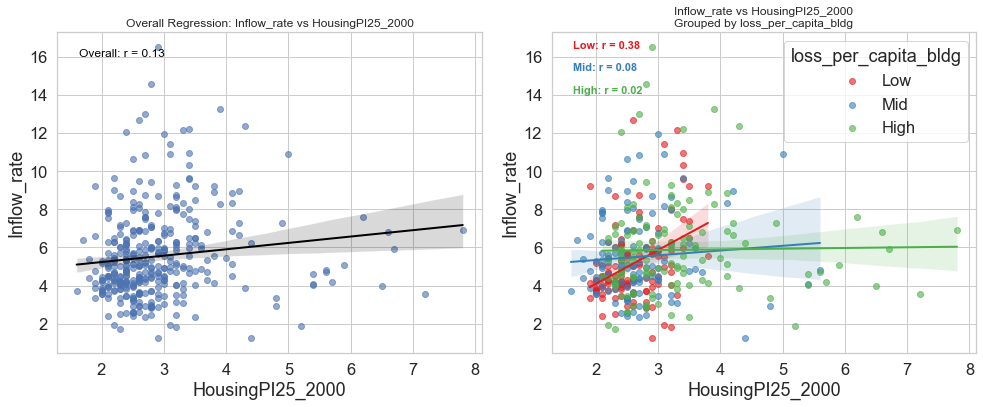

📊 Plot ID 87: X = HousingPI25_2000, Y = Inflow_rate, Z = Outflow_rate


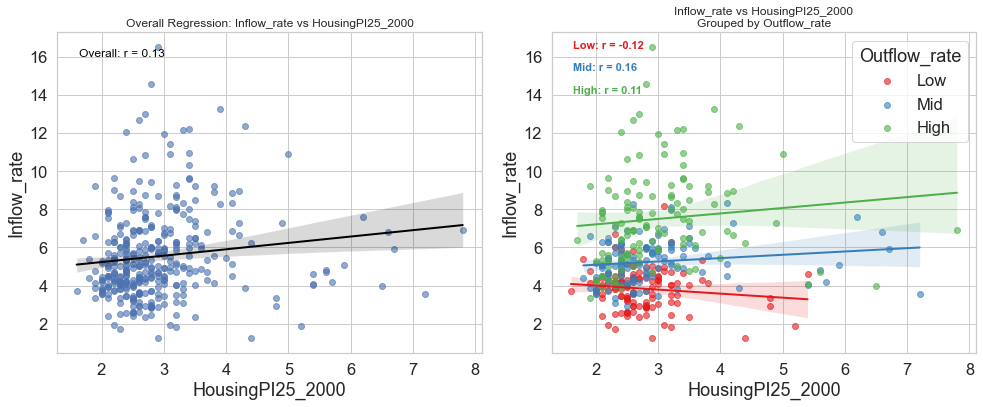

📊 Plot ID 88: X = HousingPI25_2000, Y = Inflow_rate, Z = Migration16to20_A_Outflow_Estimate


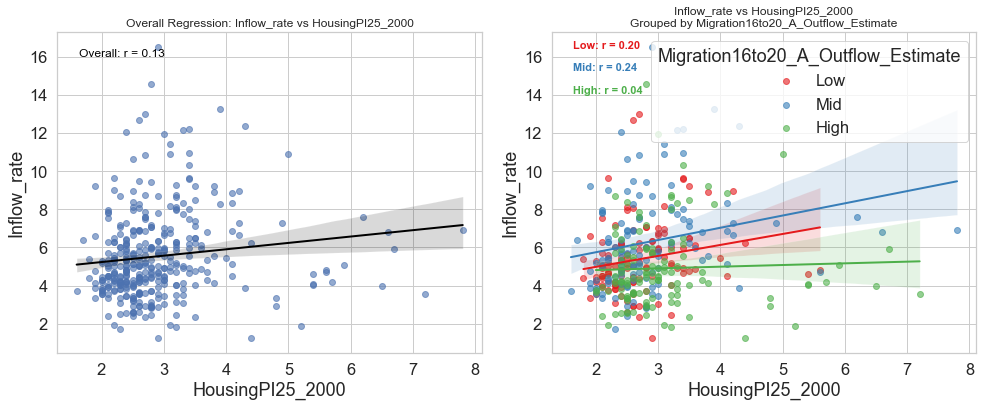

📊 Plot ID 89: X = HousingPI25_2000, Y = Inflow_rate, Z = HousingPI25_2010


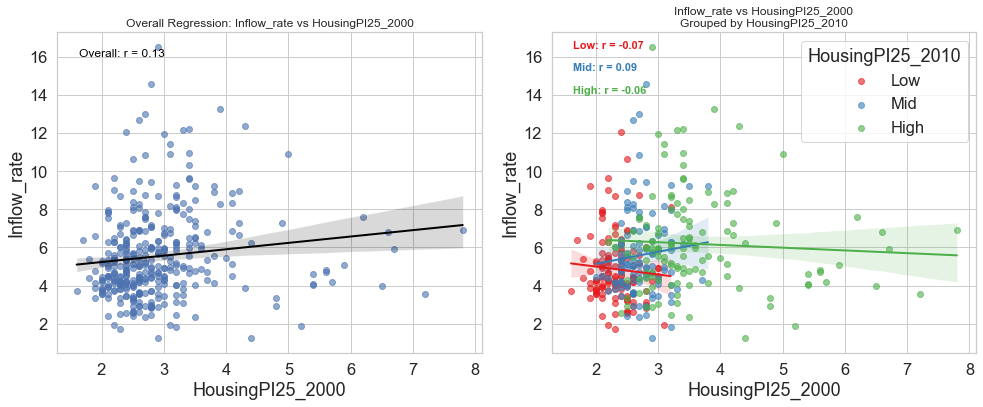

📊 Plot ID 90: X = HousingPI25_2000, Y = Inflow_rate, Z = HousingPI25_2020


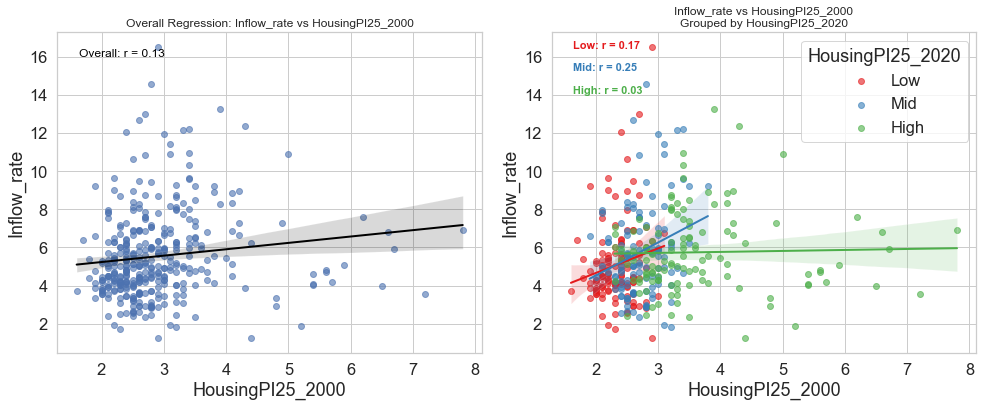

📊 Plot ID 91: X = HousingPI25_2000, Y = Inflow_rate, Z = HousingPI25_2024


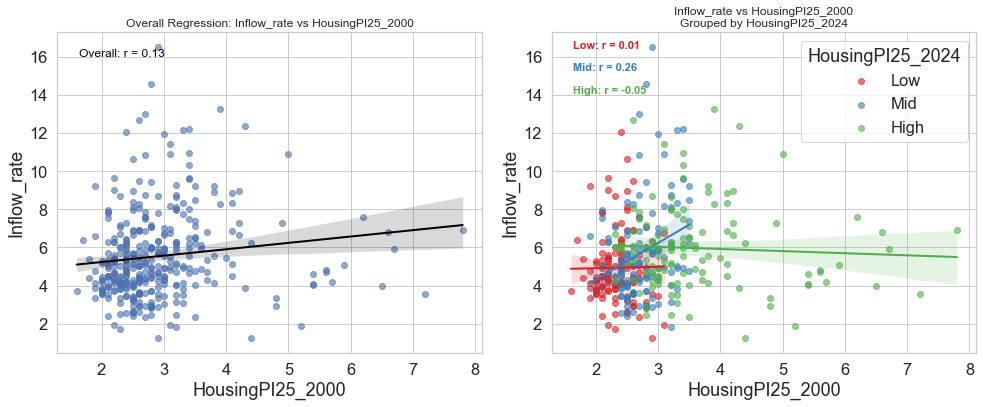

📊 Plot ID 92: X = HousingPI25_2000, Y = Outflow_rate, Z = loss_per_capita_pe


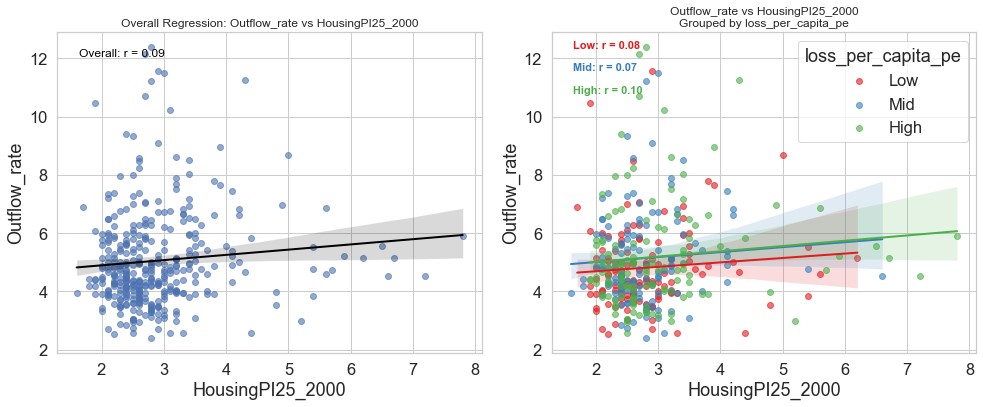

📊 Plot ID 93: X = HousingPI25_2000, Y = Outflow_rate, Z = loss_per_capita_bldg


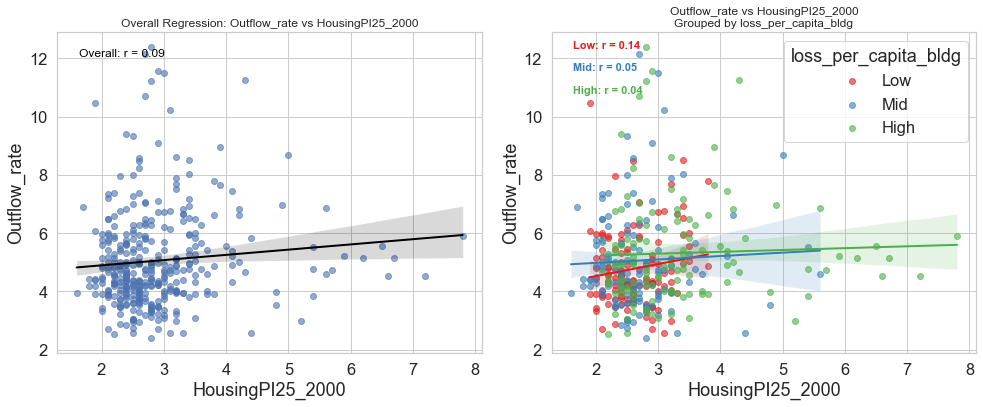

📊 Plot ID 94: X = HousingPI25_2000, Y = Outflow_rate, Z = Inflow_rate


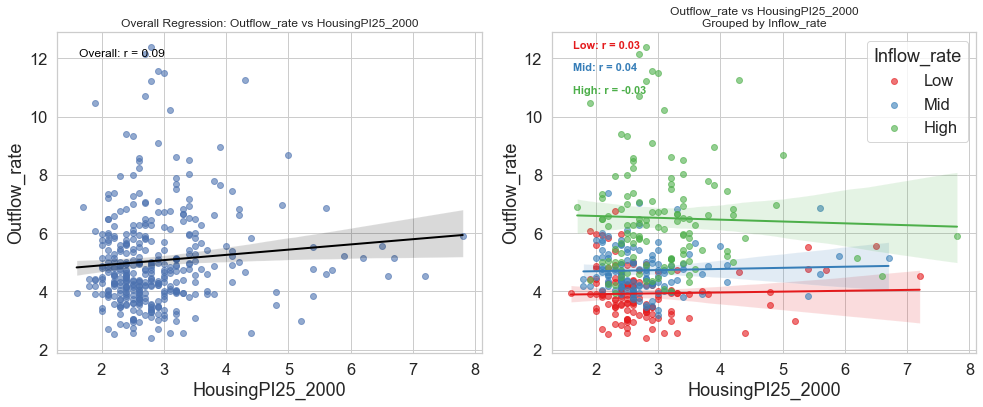

📊 Plot ID 95: X = HousingPI25_2000, Y = Outflow_rate, Z = Migration16to20_A_Outflow_Estimate


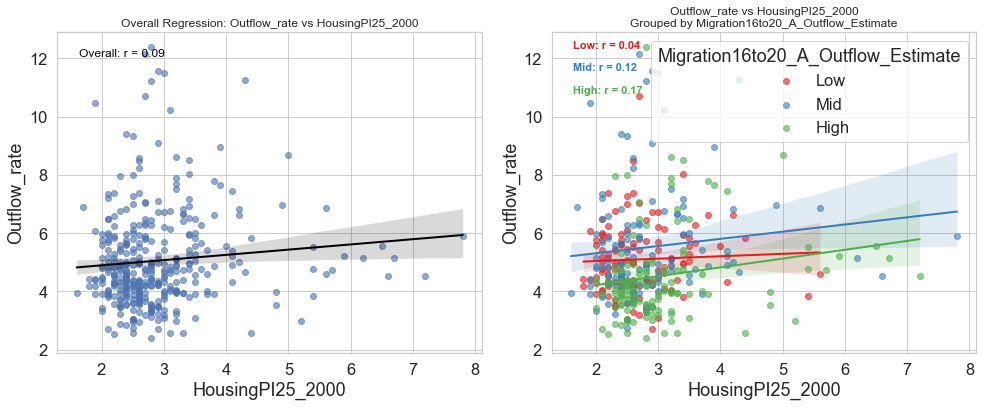

📊 Plot ID 96: X = HousingPI25_2000, Y = Outflow_rate, Z = HousingPI25_2010


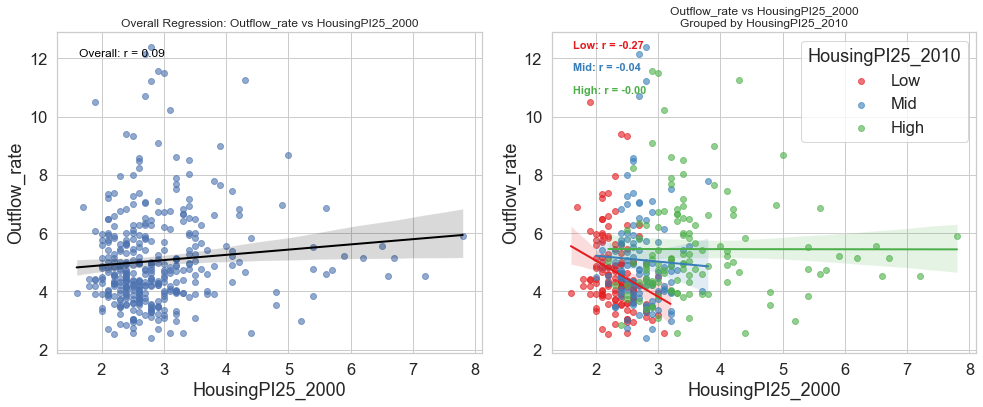

📊 Plot ID 97: X = HousingPI25_2000, Y = Outflow_rate, Z = HousingPI25_2020


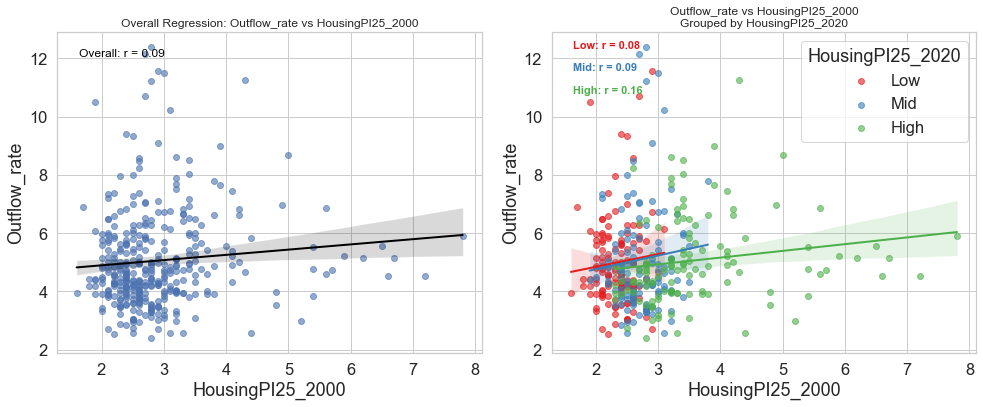

📊 Plot ID 98: X = HousingPI25_2000, Y = Outflow_rate, Z = HousingPI25_2024


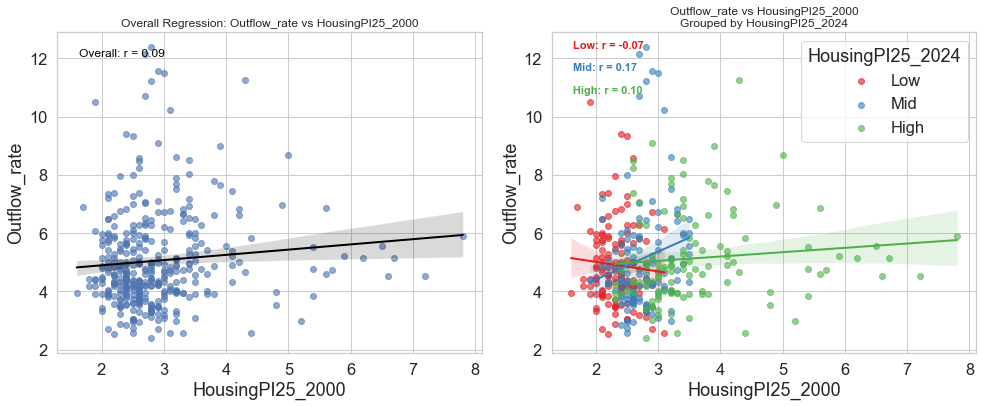

📊 Plot ID 99: X = HousingPI25_2000, Y = Migration16to20_A_Outflow_Estimate, Z = loss_per_capita_pe


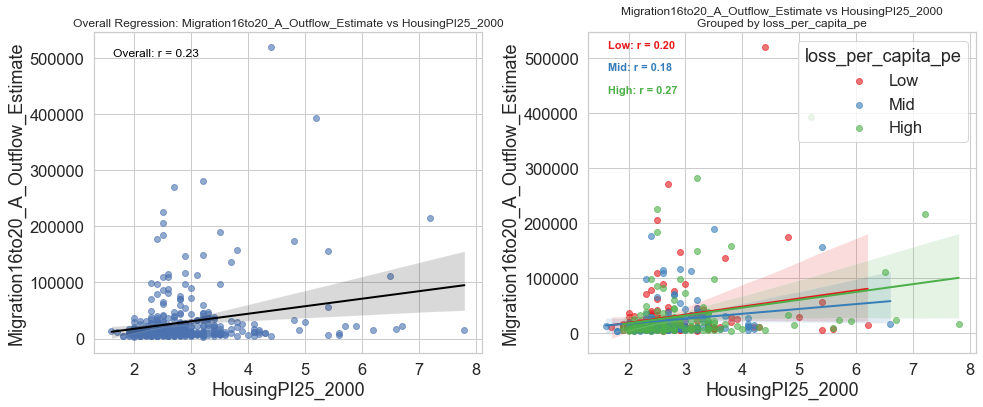

📊 Plot ID 100: X = HousingPI25_2000, Y = Migration16to20_A_Outflow_Estimate, Z = loss_per_capita_bldg


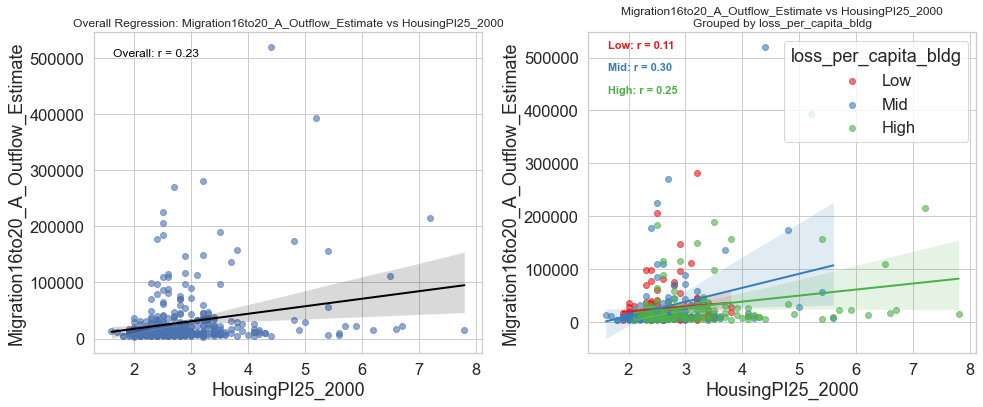

📊 Plot ID 101: X = HousingPI25_2000, Y = Migration16to20_A_Outflow_Estimate, Z = Inflow_rate


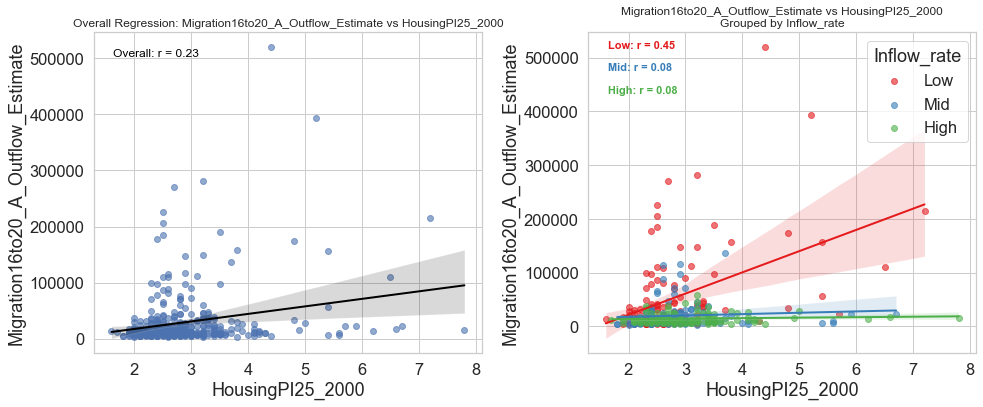

📊 Plot ID 102: X = HousingPI25_2000, Y = Migration16to20_A_Outflow_Estimate, Z = Outflow_rate


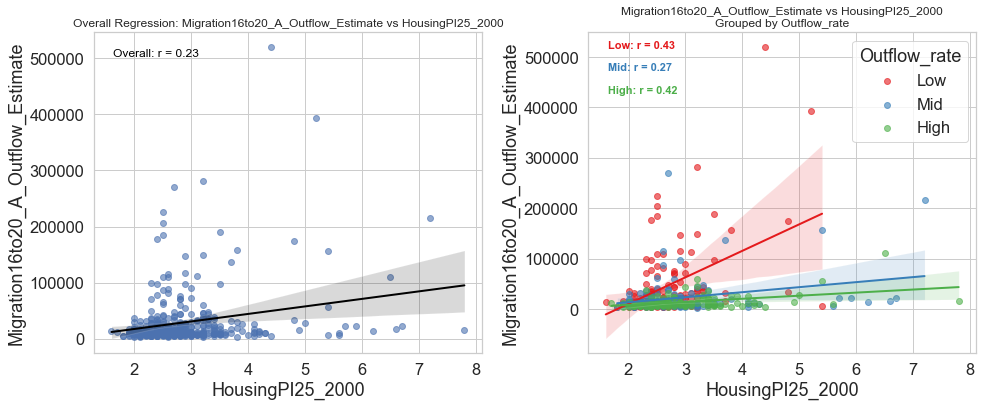

📊 Plot ID 103: X = HousingPI25_2000, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2010


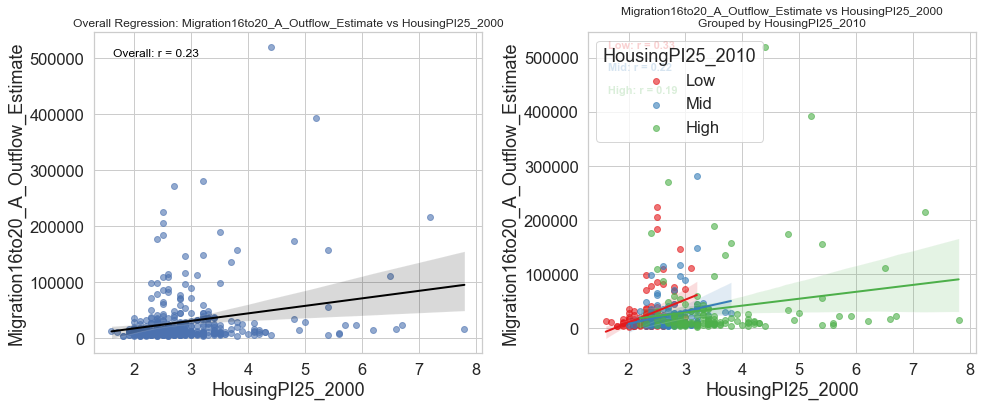

📊 Plot ID 104: X = HousingPI25_2000, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2020


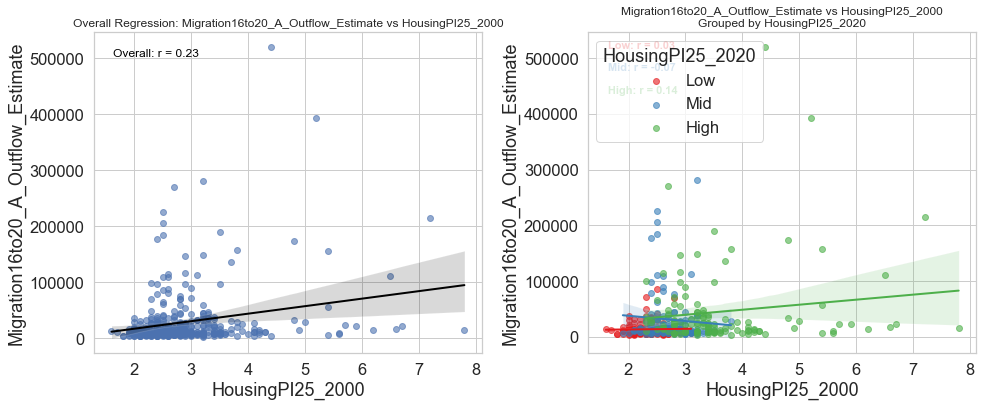

📊 Plot ID 105: X = HousingPI25_2000, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2024


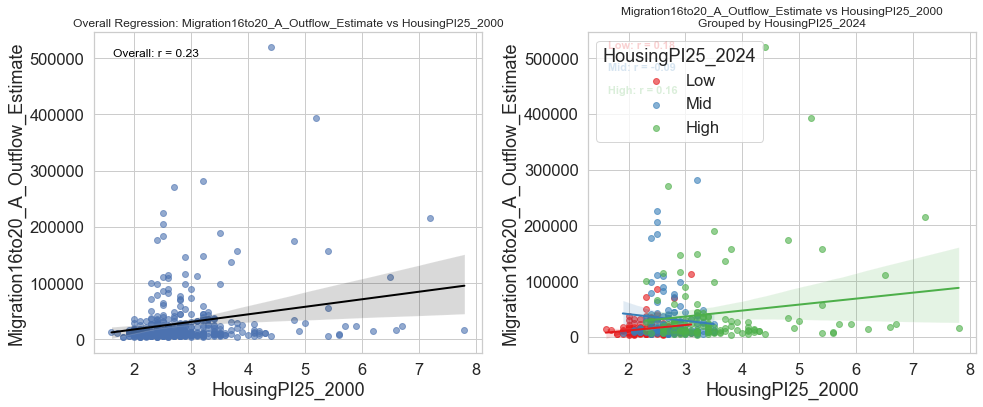

📊 Plot ID 106: X = HousingPI25_2000, Y = HousingPI25_2010, Z = loss_per_capita_pe


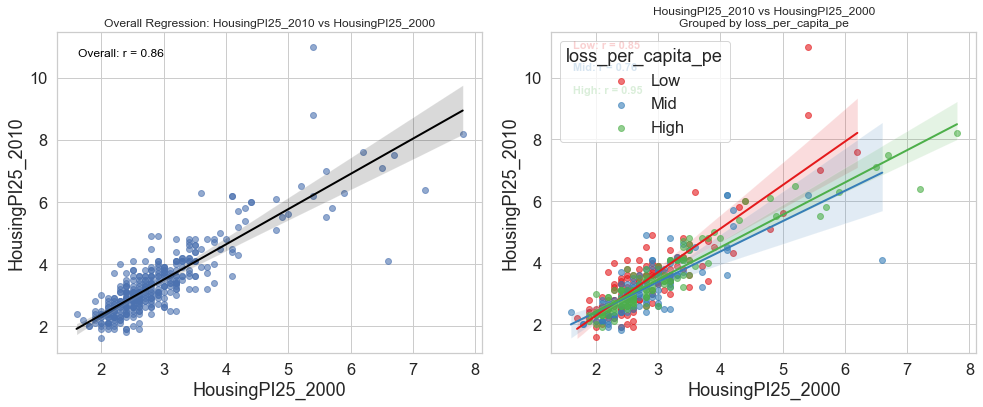

📊 Plot ID 107: X = HousingPI25_2000, Y = HousingPI25_2010, Z = loss_per_capita_bldg


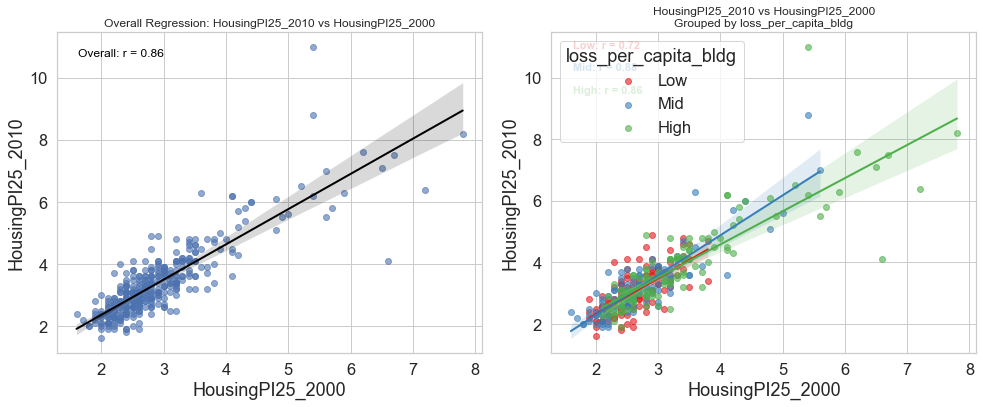

📊 Plot ID 108: X = HousingPI25_2000, Y = HousingPI25_2010, Z = Inflow_rate


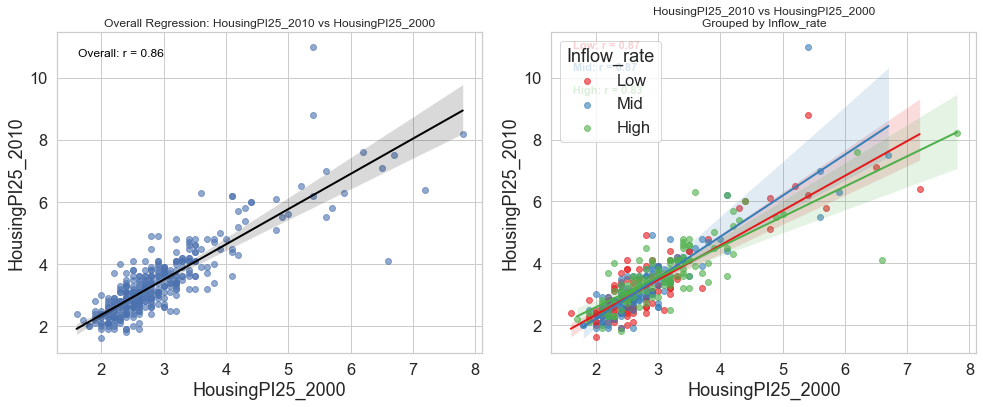

📊 Plot ID 109: X = HousingPI25_2000, Y = HousingPI25_2010, Z = Outflow_rate


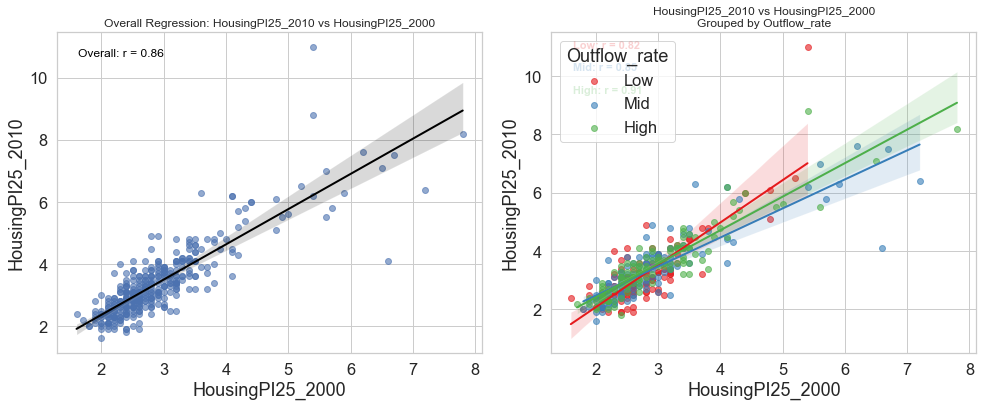

📊 Plot ID 110: X = HousingPI25_2000, Y = HousingPI25_2010, Z = Migration16to20_A_Outflow_Estimate


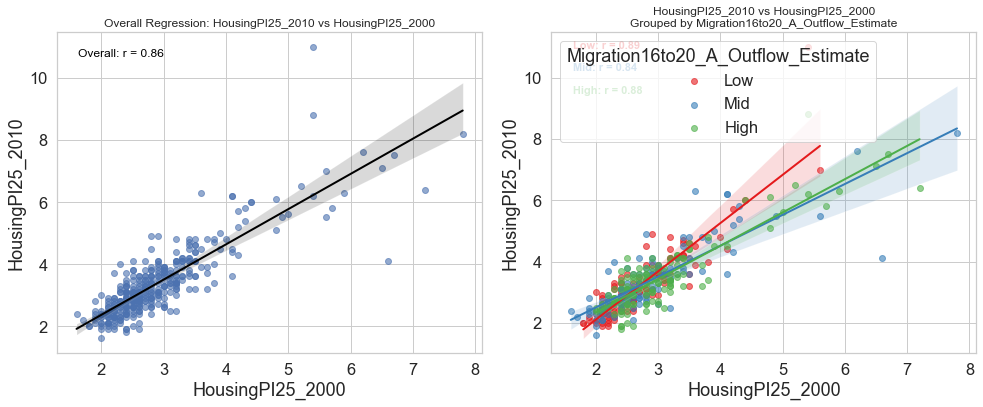

📊 Plot ID 111: X = HousingPI25_2000, Y = HousingPI25_2010, Z = HousingPI25_2020


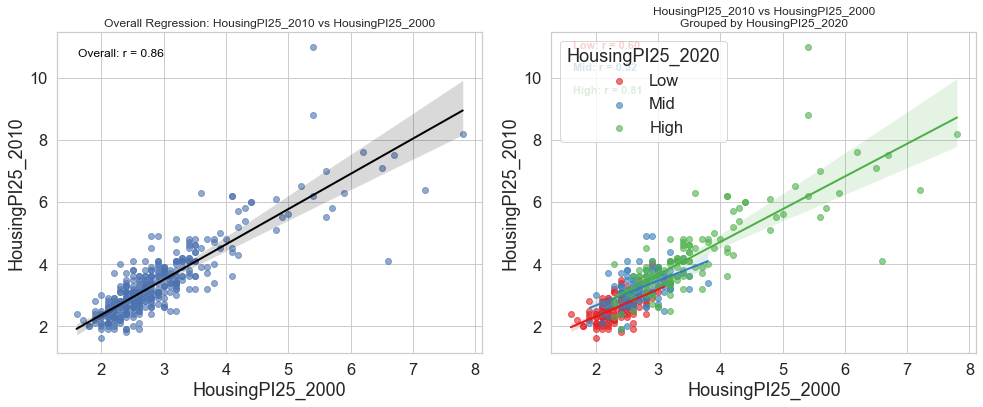

📊 Plot ID 112: X = HousingPI25_2000, Y = HousingPI25_2010, Z = HousingPI25_2024


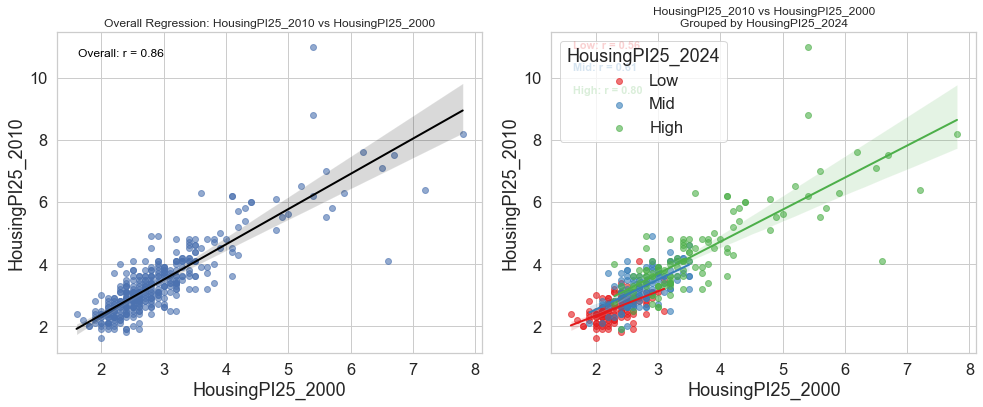

📊 Plot ID 113: X = HousingPI25_2000, Y = HousingPI25_2020, Z = loss_per_capita_pe


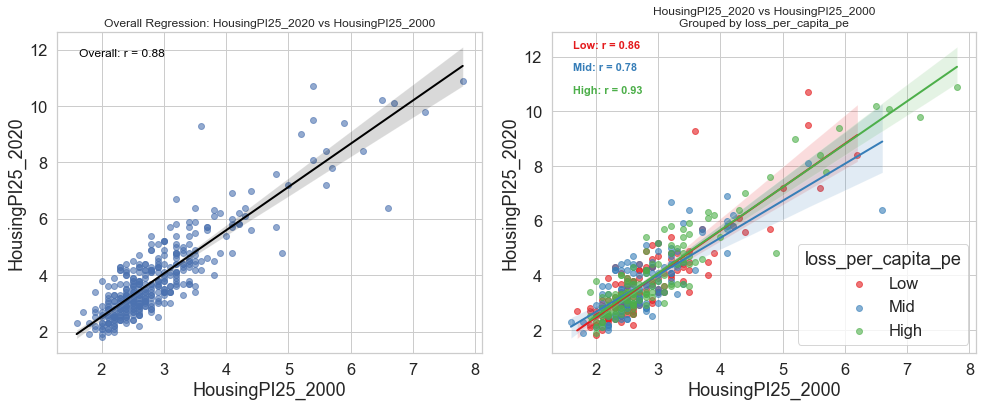

📊 Plot ID 114: X = HousingPI25_2000, Y = HousingPI25_2020, Z = loss_per_capita_bldg


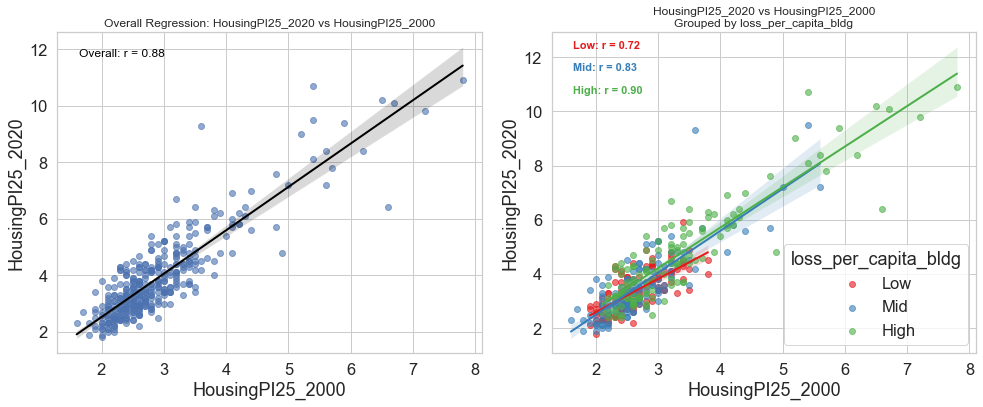

📊 Plot ID 115: X = HousingPI25_2000, Y = HousingPI25_2020, Z = Inflow_rate


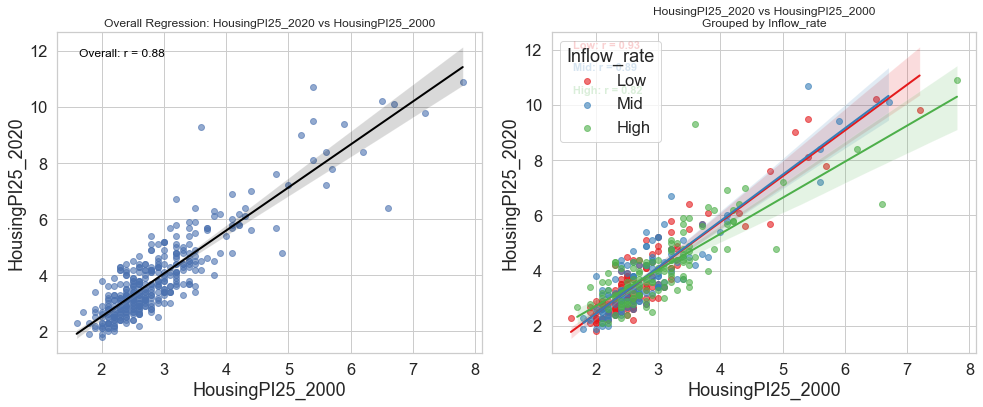

📊 Plot ID 116: X = HousingPI25_2000, Y = HousingPI25_2020, Z = Outflow_rate


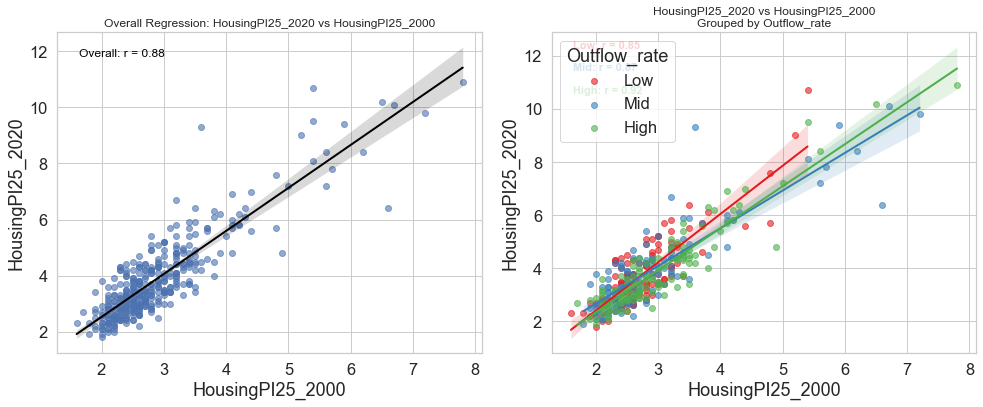

📊 Plot ID 117: X = HousingPI25_2000, Y = HousingPI25_2020, Z = Migration16to20_A_Outflow_Estimate


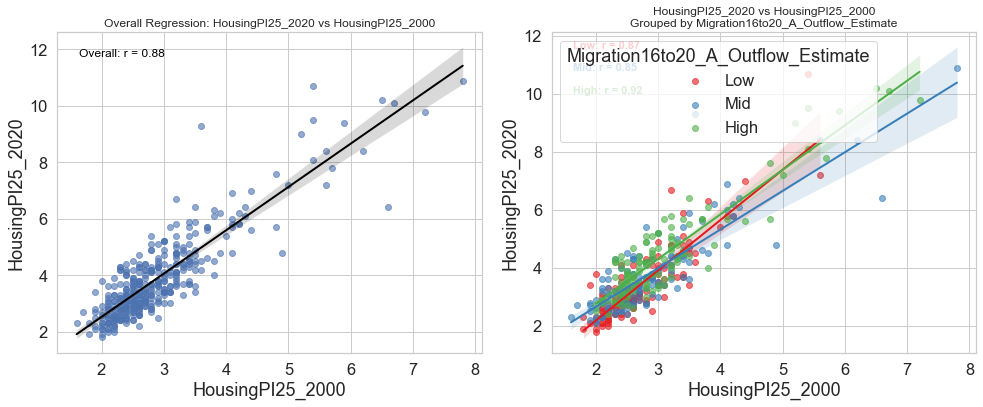

📊 Plot ID 118: X = HousingPI25_2000, Y = HousingPI25_2020, Z = HousingPI25_2010


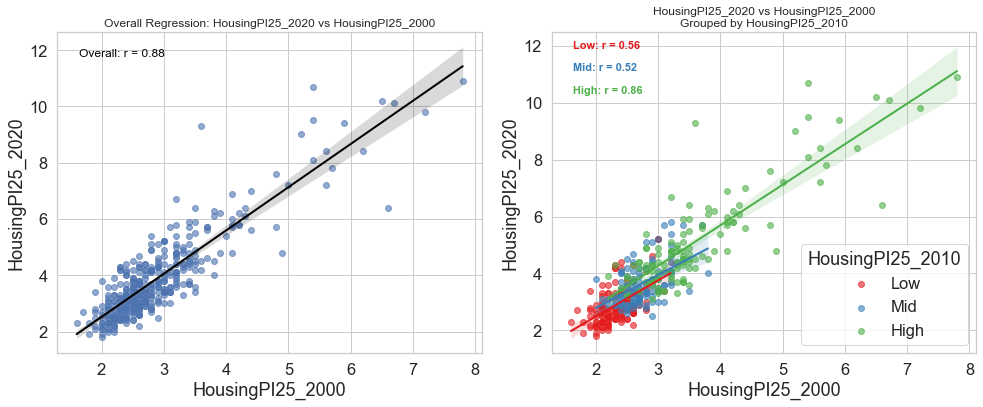

📊 Plot ID 119: X = HousingPI25_2000, Y = HousingPI25_2020, Z = HousingPI25_2024


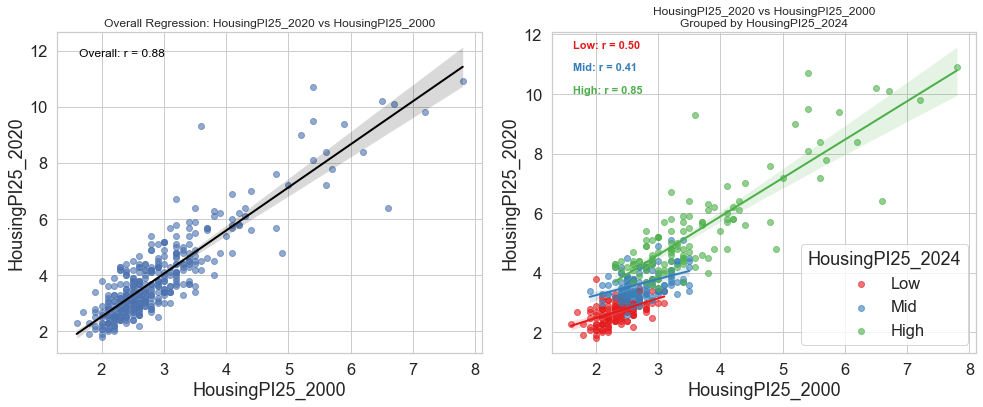

📊 Plot ID 120: X = HousingPI25_2000, Y = HousingPI25_2024, Z = loss_per_capita_pe


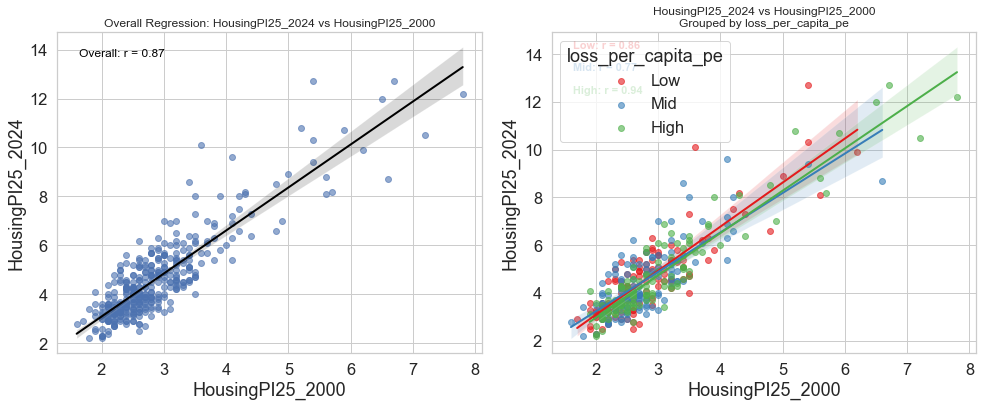

📊 Plot ID 121: X = HousingPI25_2000, Y = HousingPI25_2024, Z = loss_per_capita_bldg


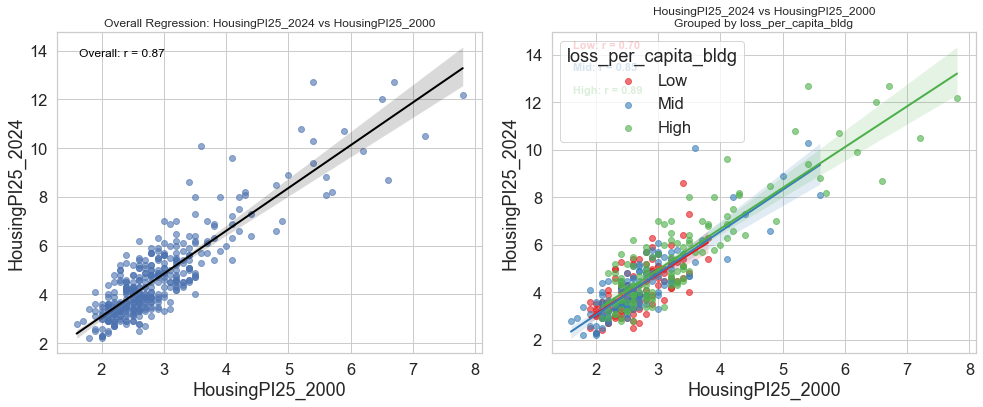

📊 Plot ID 122: X = HousingPI25_2000, Y = HousingPI25_2024, Z = Inflow_rate


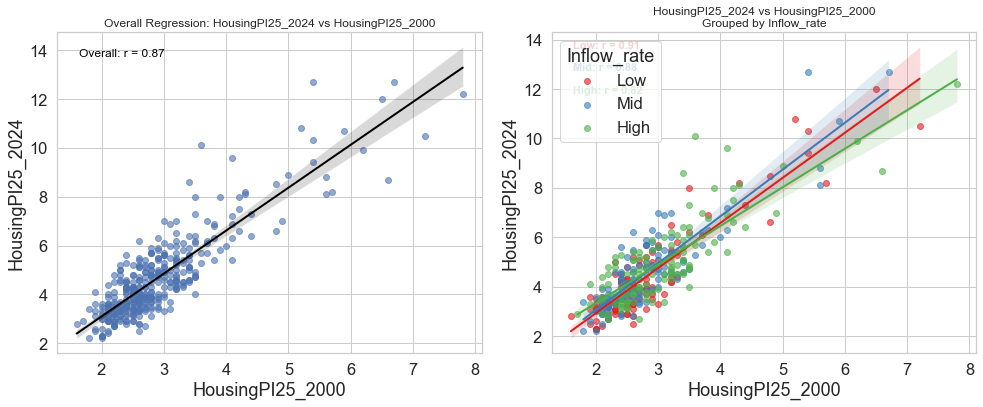

📊 Plot ID 123: X = HousingPI25_2000, Y = HousingPI25_2024, Z = Outflow_rate


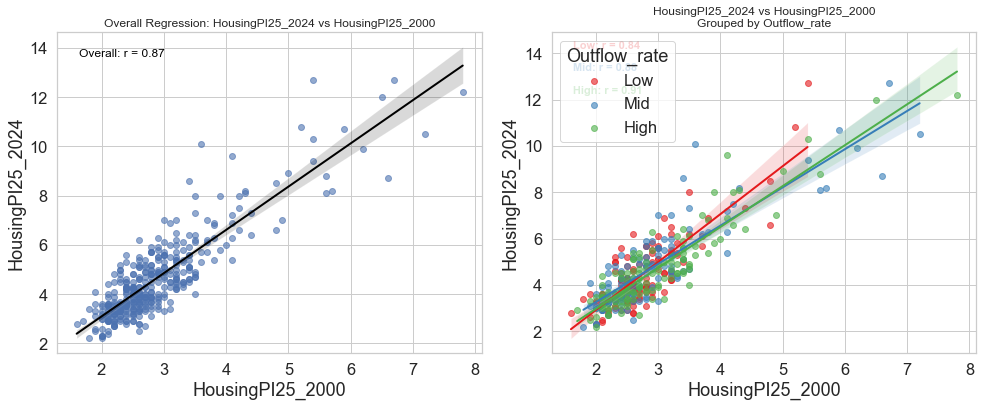

📊 Plot ID 124: X = HousingPI25_2000, Y = HousingPI25_2024, Z = Migration16to20_A_Outflow_Estimate


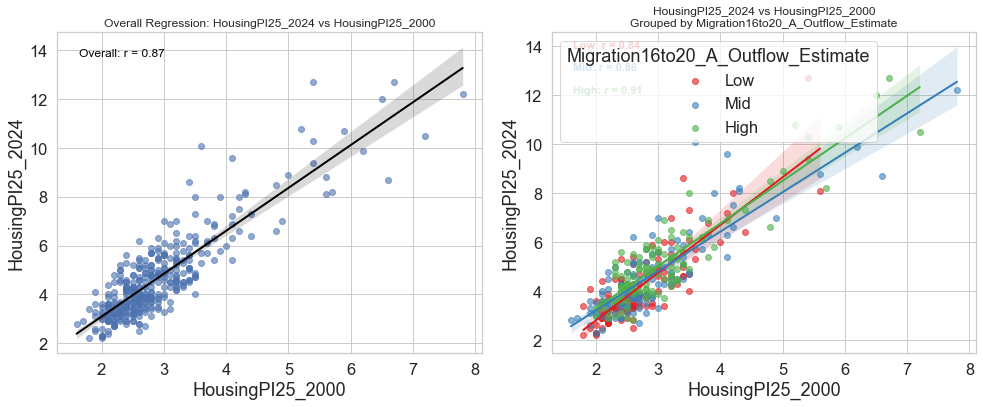

📊 Plot ID 125: X = HousingPI25_2000, Y = HousingPI25_2024, Z = HousingPI25_2010


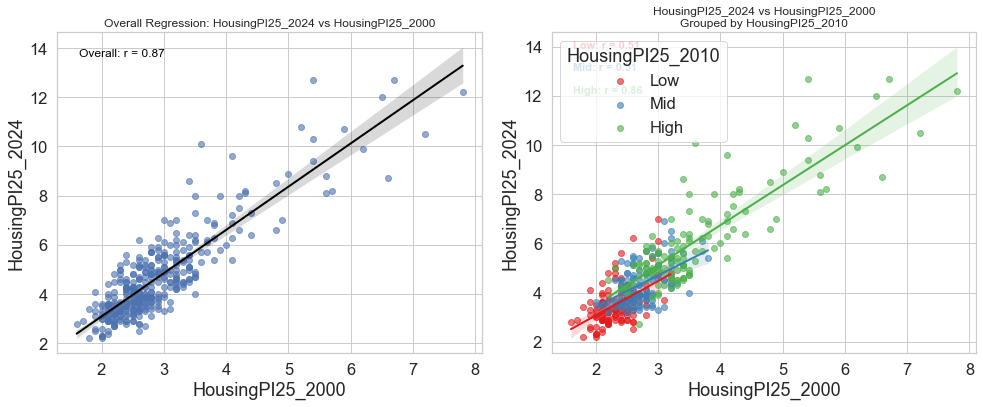

📊 Plot ID 126: X = HousingPI25_2000, Y = HousingPI25_2024, Z = HousingPI25_2020


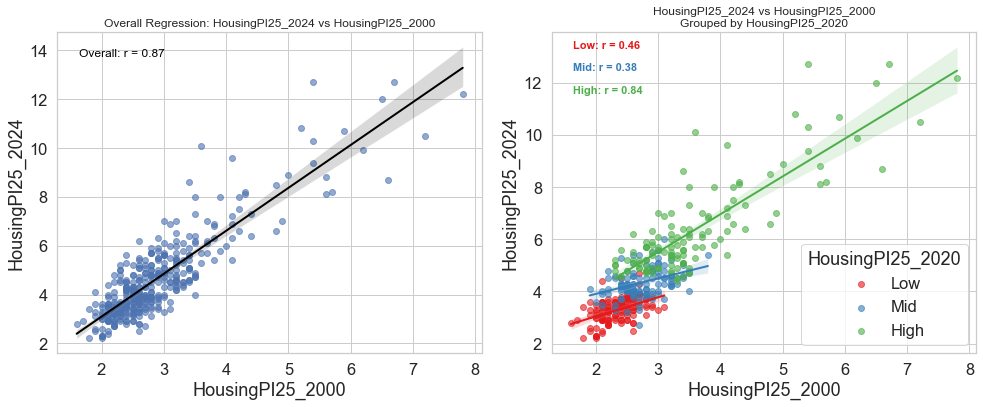

📊 Plot ID 127: X = HousingPI25_2010, Y = loss_per_capita_pe, Z = loss_per_capita_bldg


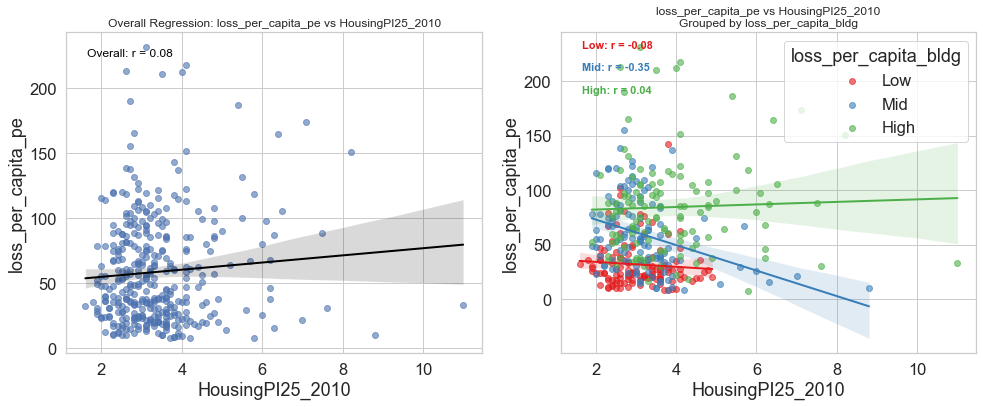

📊 Plot ID 128: X = HousingPI25_2010, Y = loss_per_capita_pe, Z = Inflow_rate


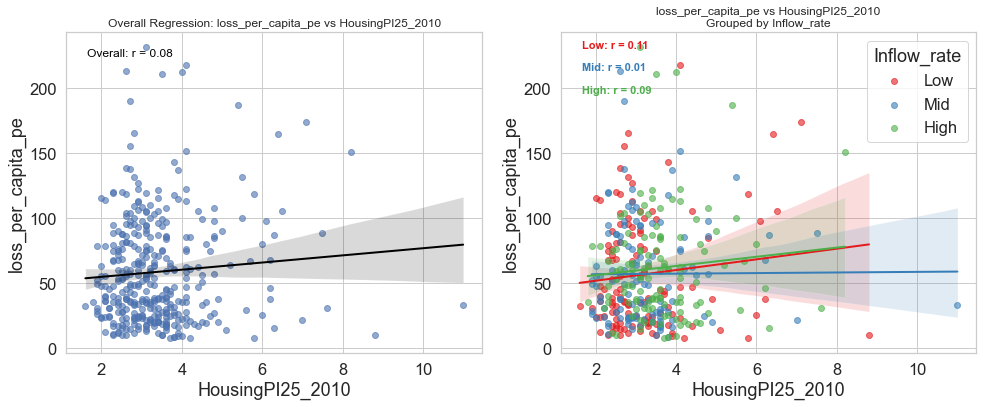

📊 Plot ID 129: X = HousingPI25_2010, Y = loss_per_capita_pe, Z = Outflow_rate


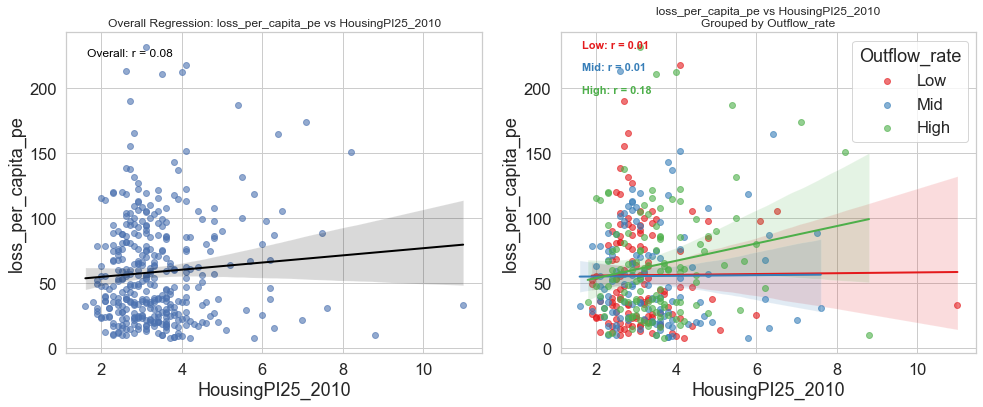

📊 Plot ID 130: X = HousingPI25_2010, Y = loss_per_capita_pe, Z = Migration16to20_A_Outflow_Estimate


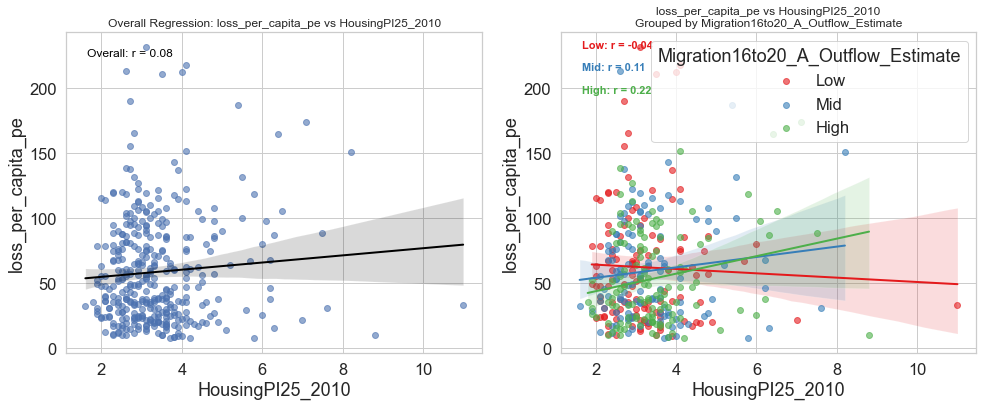

📊 Plot ID 131: X = HousingPI25_2010, Y = loss_per_capita_pe, Z = HousingPI25_2000


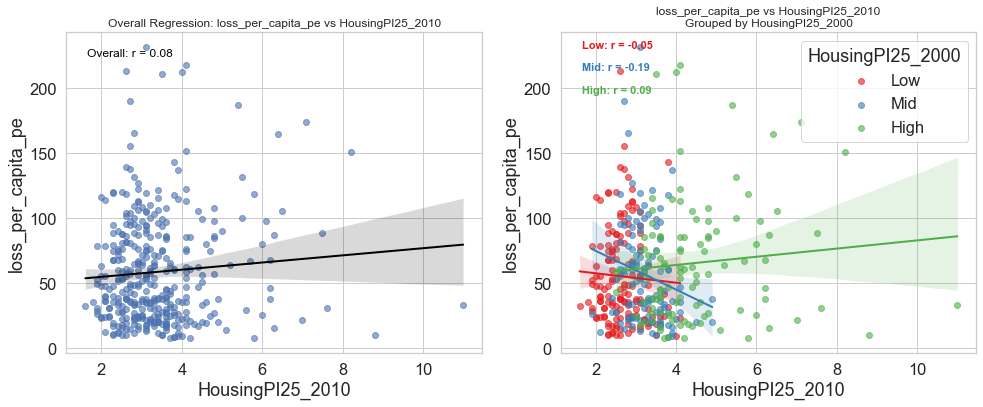

📊 Plot ID 132: X = HousingPI25_2010, Y = loss_per_capita_pe, Z = HousingPI25_2020


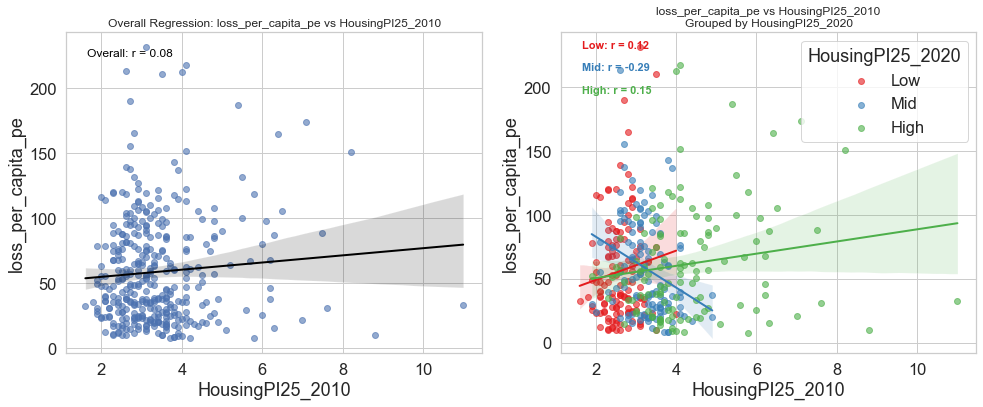

📊 Plot ID 133: X = HousingPI25_2010, Y = loss_per_capita_pe, Z = HousingPI25_2024


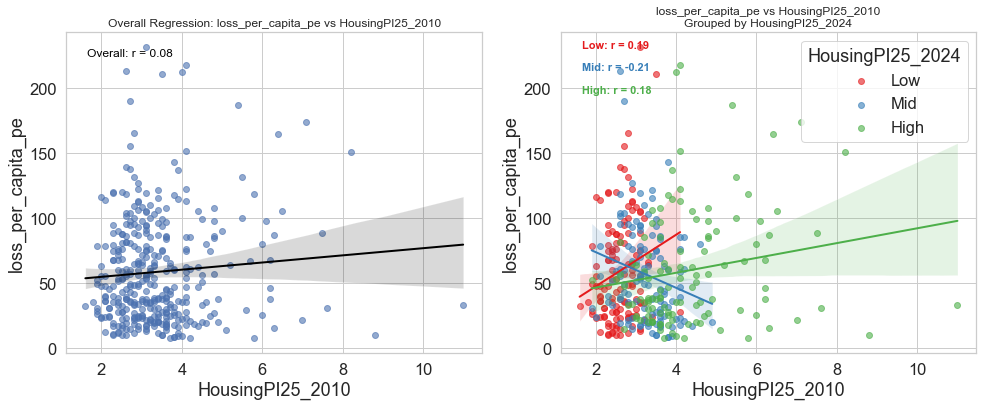

📊 Plot ID 134: X = HousingPI25_2010, Y = loss_per_capita_bldg, Z = loss_per_capita_pe


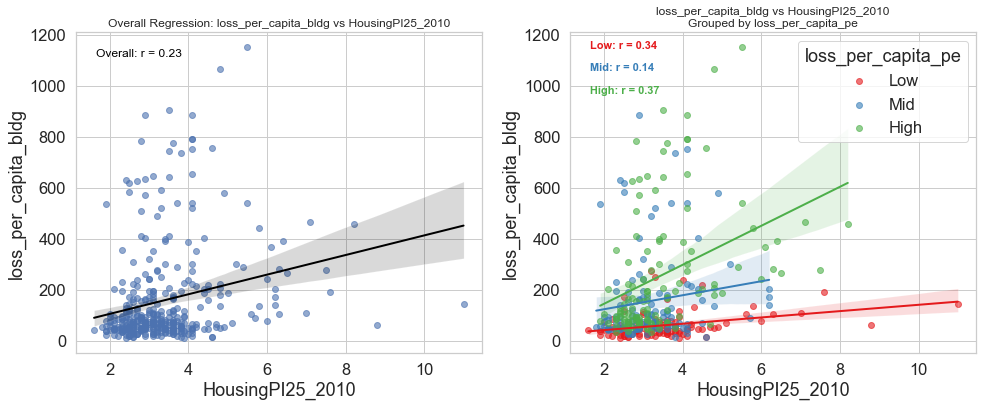

📊 Plot ID 135: X = HousingPI25_2010, Y = loss_per_capita_bldg, Z = Inflow_rate


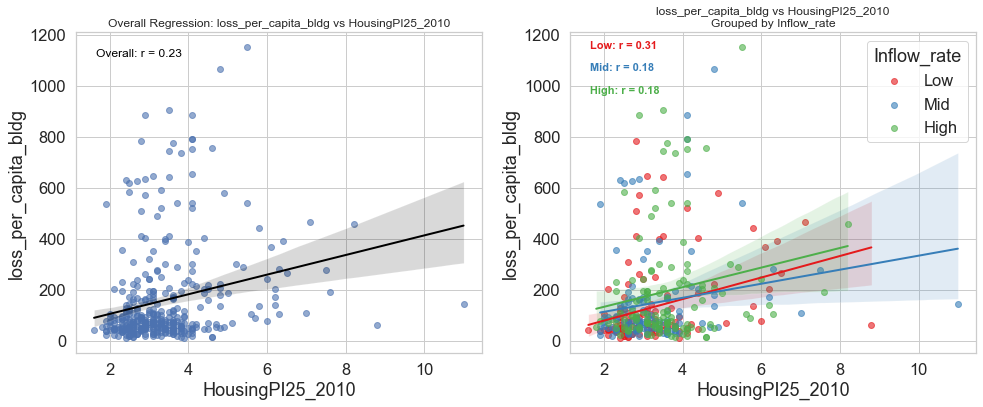

📊 Plot ID 136: X = HousingPI25_2010, Y = loss_per_capita_bldg, Z = Outflow_rate


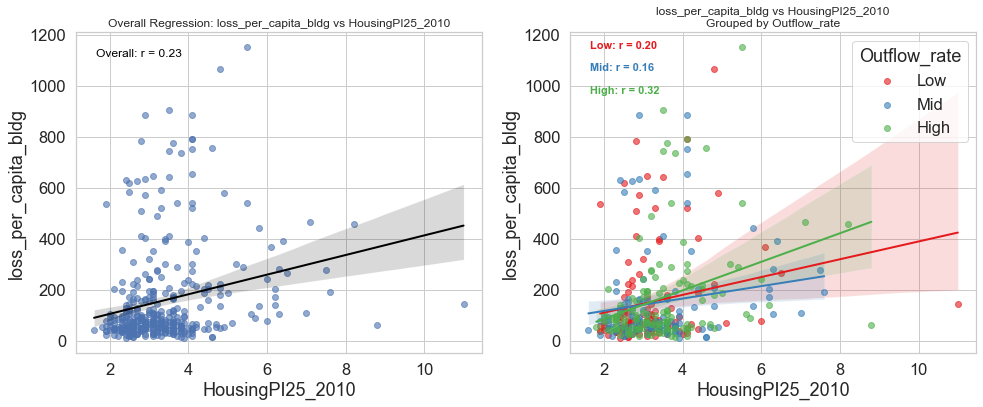

📊 Plot ID 137: X = HousingPI25_2010, Y = loss_per_capita_bldg, Z = Migration16to20_A_Outflow_Estimate


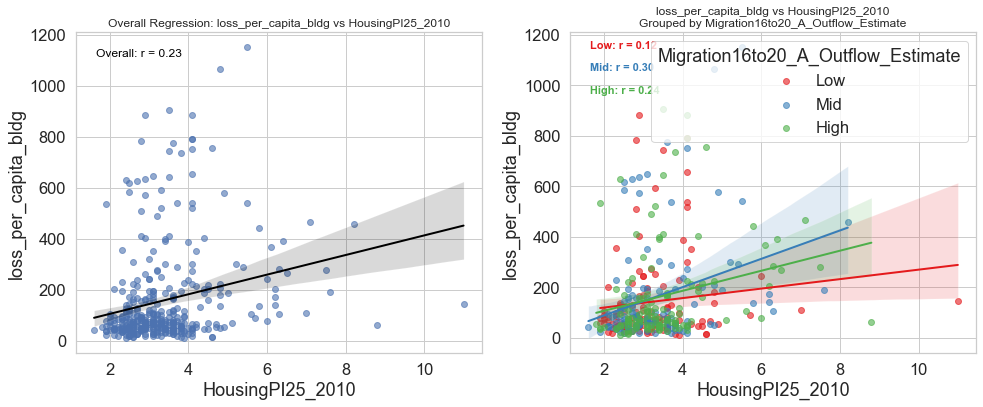

📊 Plot ID 138: X = HousingPI25_2010, Y = loss_per_capita_bldg, Z = HousingPI25_2000


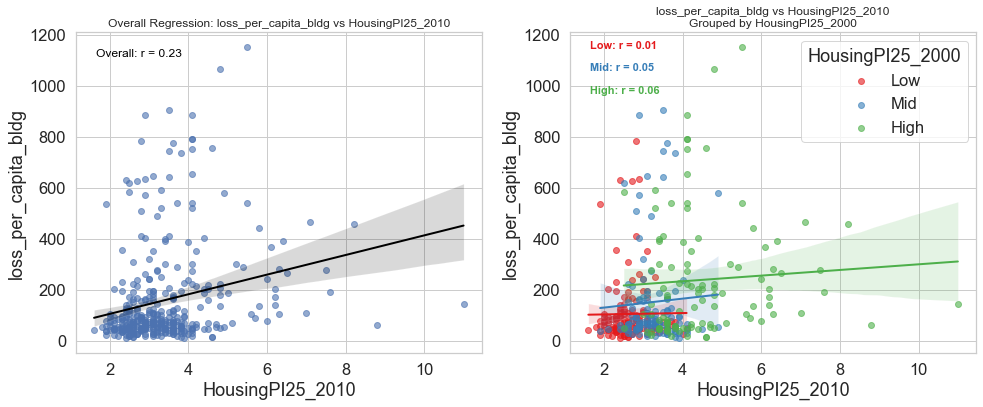

📊 Plot ID 139: X = HousingPI25_2010, Y = loss_per_capita_bldg, Z = HousingPI25_2020


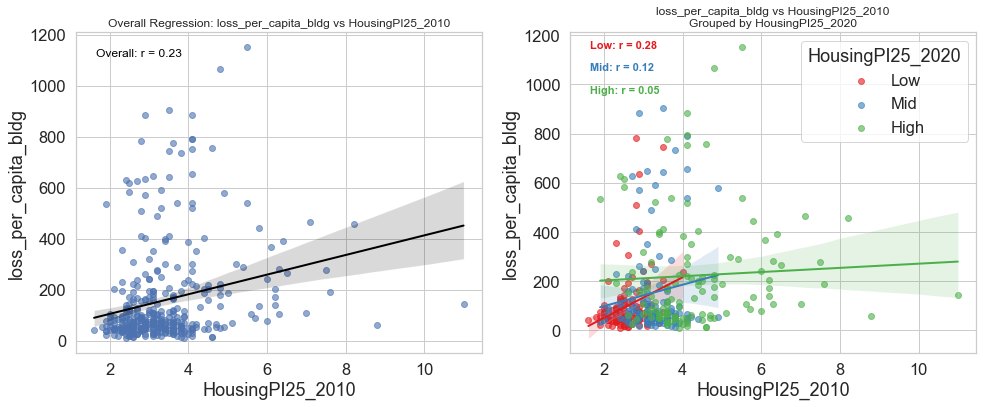

📊 Plot ID 140: X = HousingPI25_2010, Y = loss_per_capita_bldg, Z = HousingPI25_2024


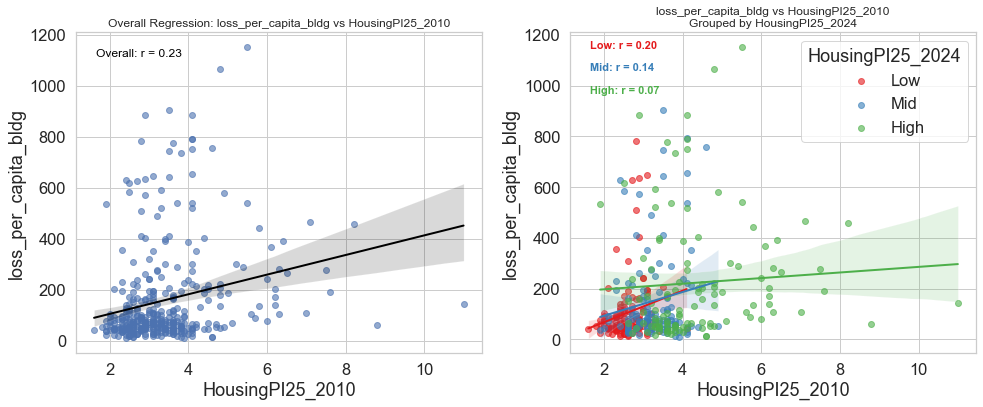

📊 Plot ID 141: X = HousingPI25_2010, Y = Inflow_rate, Z = loss_per_capita_pe


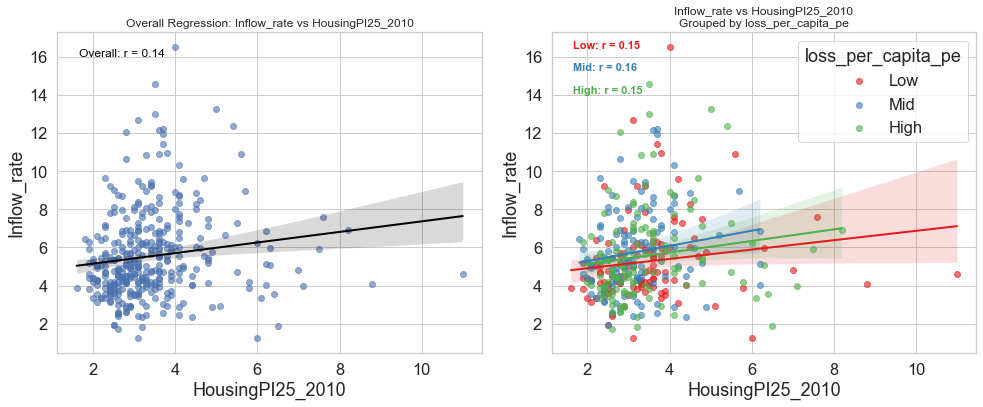

📊 Plot ID 142: X = HousingPI25_2010, Y = Inflow_rate, Z = loss_per_capita_bldg


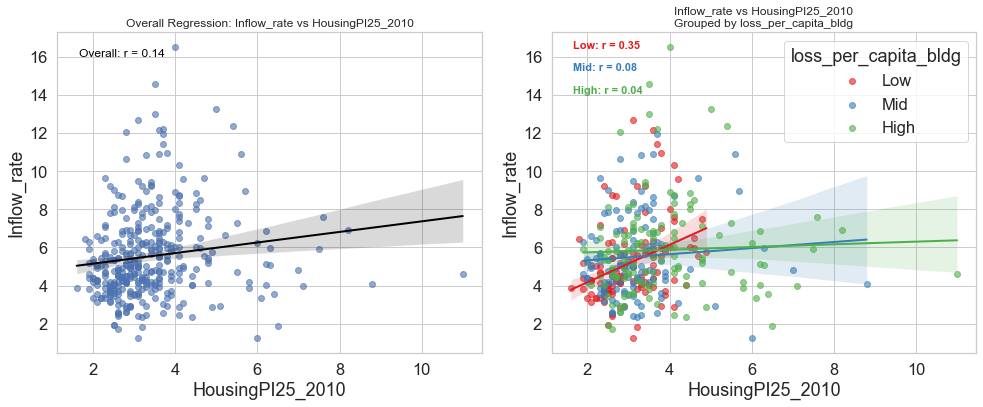

📊 Plot ID 143: X = HousingPI25_2010, Y = Inflow_rate, Z = Outflow_rate


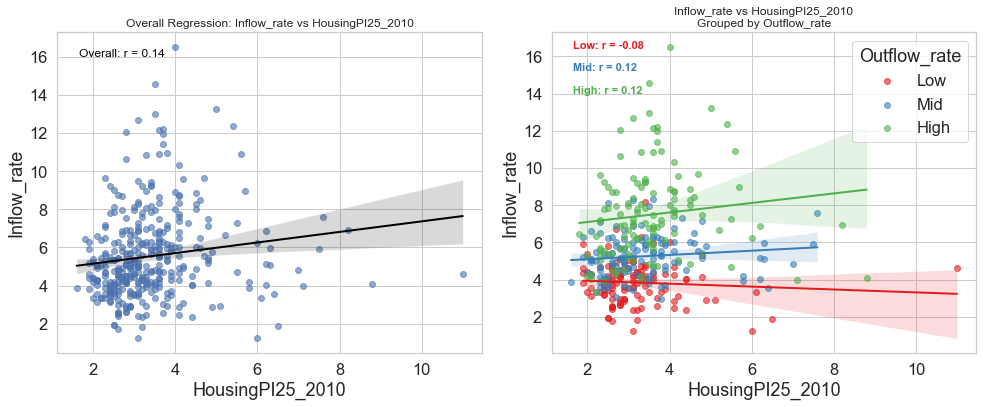

📊 Plot ID 144: X = HousingPI25_2010, Y = Inflow_rate, Z = Migration16to20_A_Outflow_Estimate


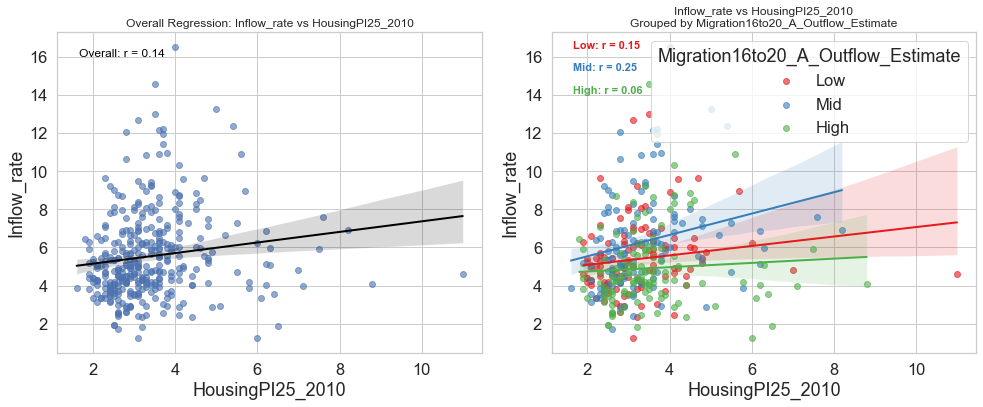

📊 Plot ID 145: X = HousingPI25_2010, Y = Inflow_rate, Z = HousingPI25_2000


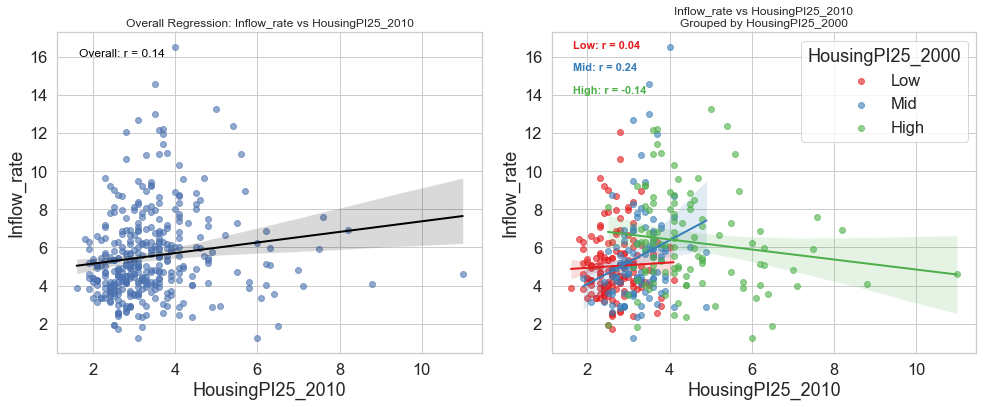

📊 Plot ID 146: X = HousingPI25_2010, Y = Inflow_rate, Z = HousingPI25_2020


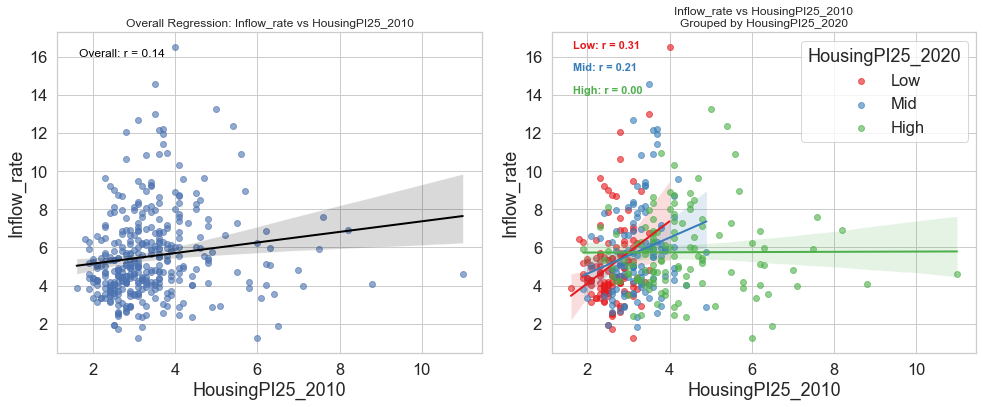

📊 Plot ID 147: X = HousingPI25_2010, Y = Inflow_rate, Z = HousingPI25_2024


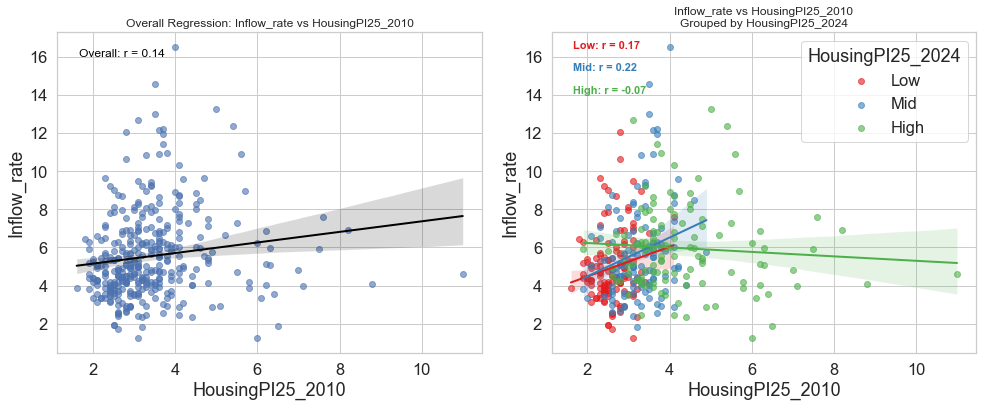

📊 Plot ID 148: X = HousingPI25_2010, Y = Outflow_rate, Z = loss_per_capita_pe


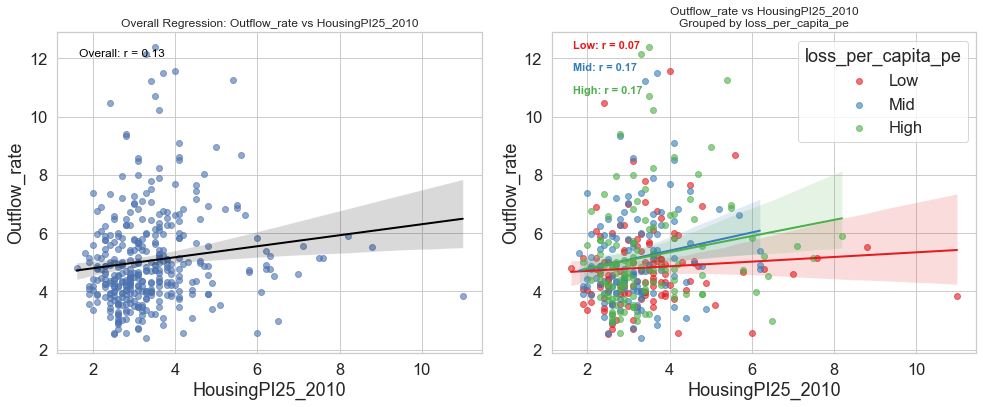

📊 Plot ID 149: X = HousingPI25_2010, Y = Outflow_rate, Z = loss_per_capita_bldg


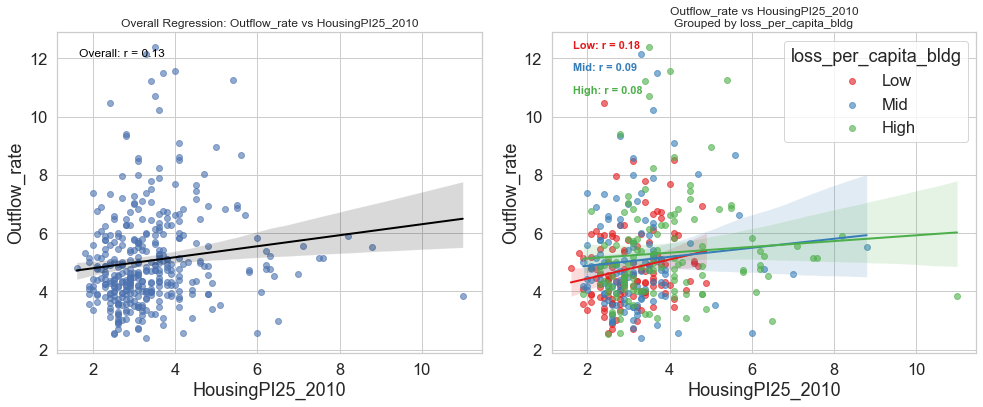

📊 Plot ID 150: X = HousingPI25_2010, Y = Outflow_rate, Z = Inflow_rate


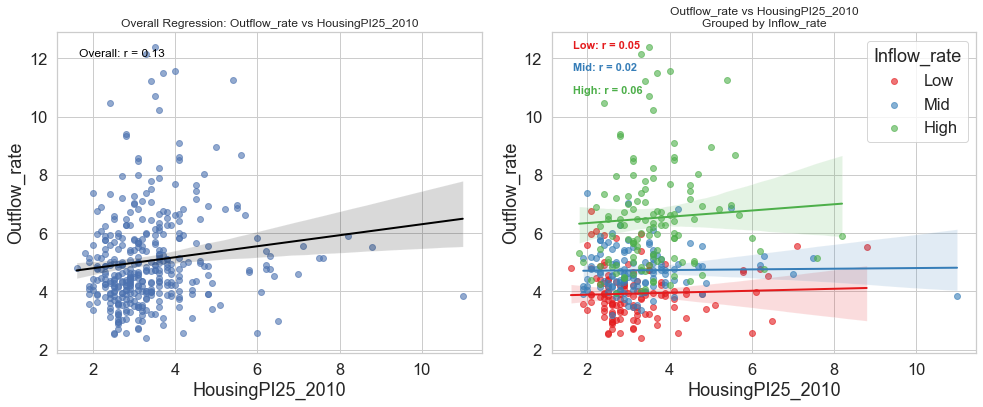

📊 Plot ID 151: X = HousingPI25_2010, Y = Outflow_rate, Z = Migration16to20_A_Outflow_Estimate


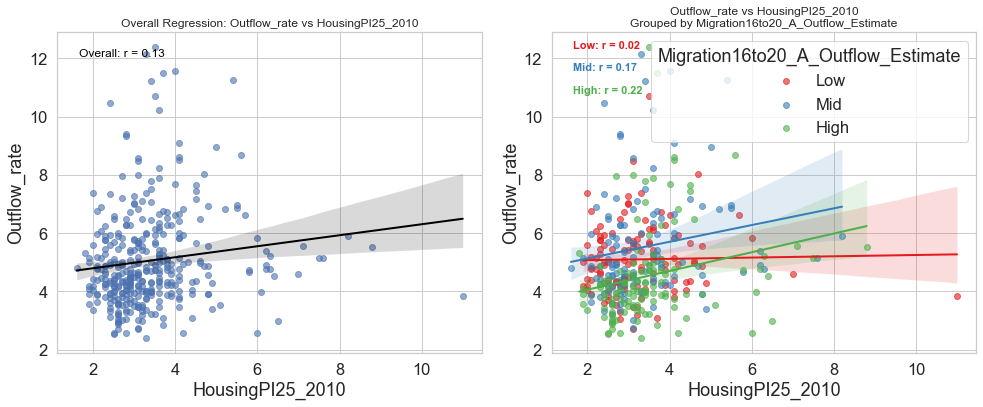

📊 Plot ID 152: X = HousingPI25_2010, Y = Outflow_rate, Z = HousingPI25_2000


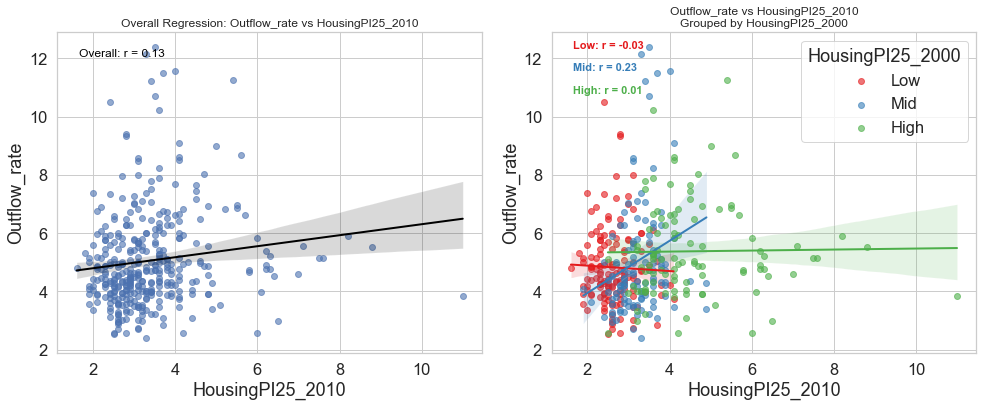

📊 Plot ID 153: X = HousingPI25_2010, Y = Outflow_rate, Z = HousingPI25_2020


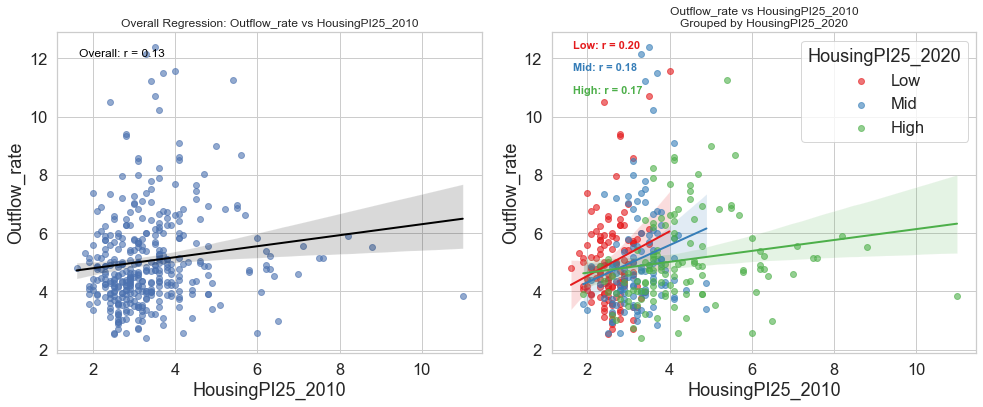

📊 Plot ID 154: X = HousingPI25_2010, Y = Outflow_rate, Z = HousingPI25_2024


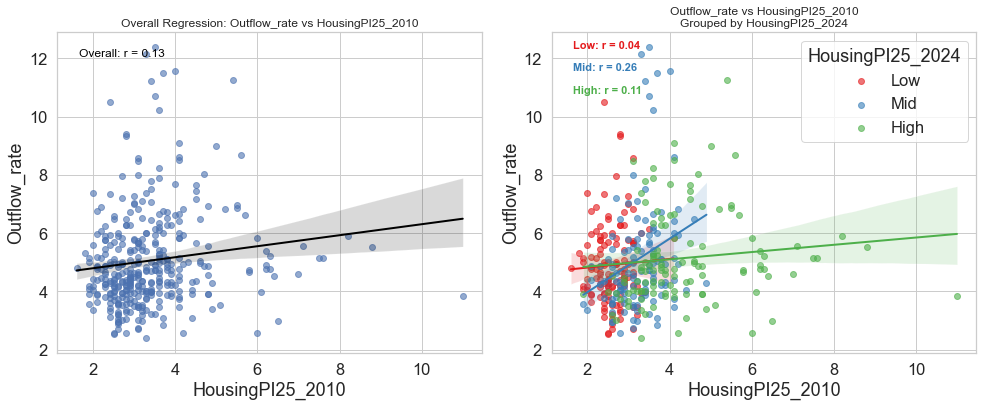

📊 Plot ID 155: X = HousingPI25_2010, Y = Migration16to20_A_Outflow_Estimate, Z = loss_per_capita_pe


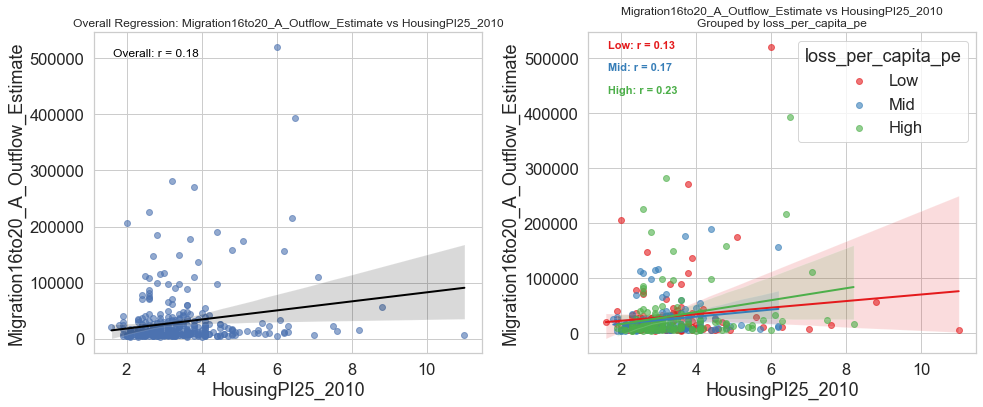

📊 Plot ID 156: X = HousingPI25_2010, Y = Migration16to20_A_Outflow_Estimate, Z = loss_per_capita_bldg


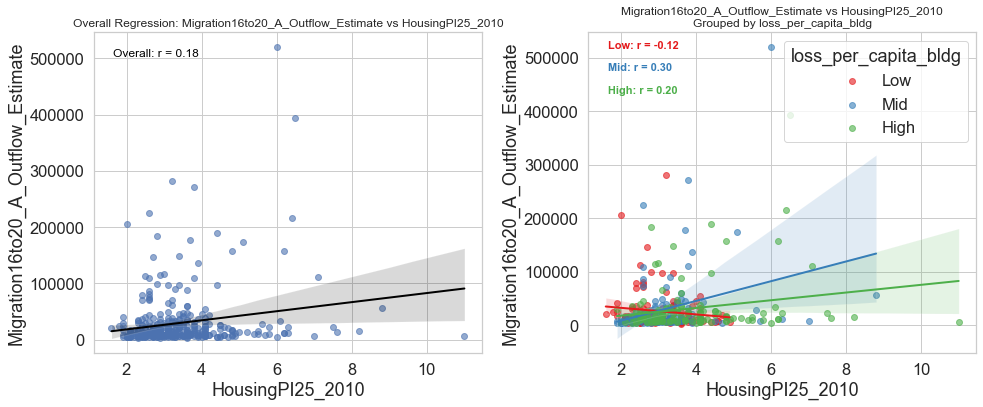

📊 Plot ID 157: X = HousingPI25_2010, Y = Migration16to20_A_Outflow_Estimate, Z = Inflow_rate


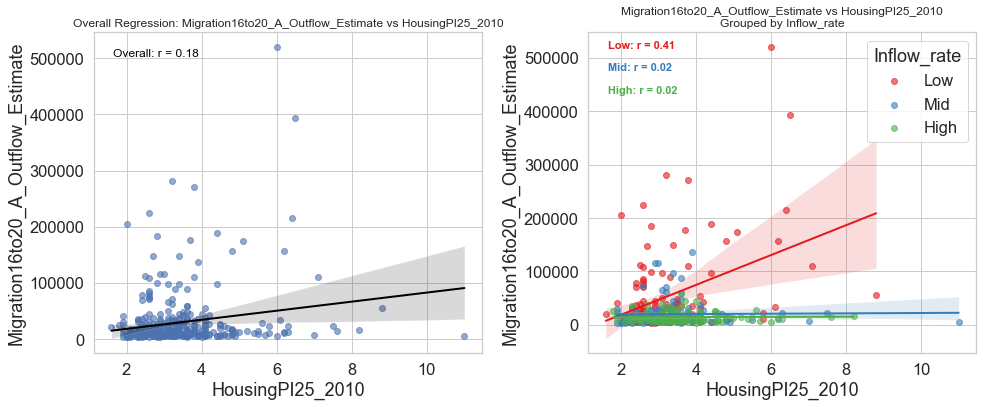

📊 Plot ID 158: X = HousingPI25_2010, Y = Migration16to20_A_Outflow_Estimate, Z = Outflow_rate


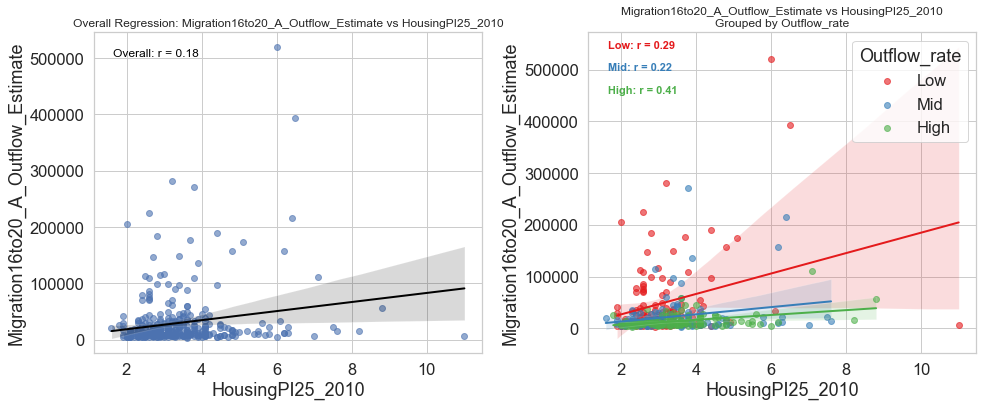

📊 Plot ID 159: X = HousingPI25_2010, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2000


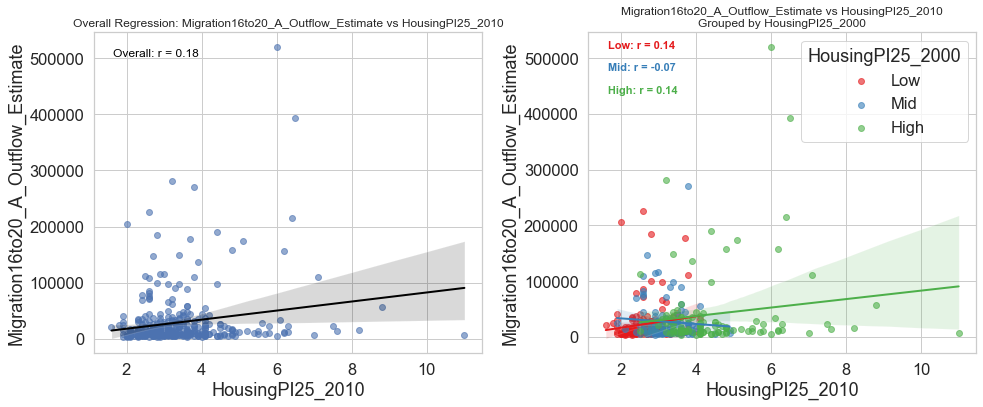

📊 Plot ID 160: X = HousingPI25_2010, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2020


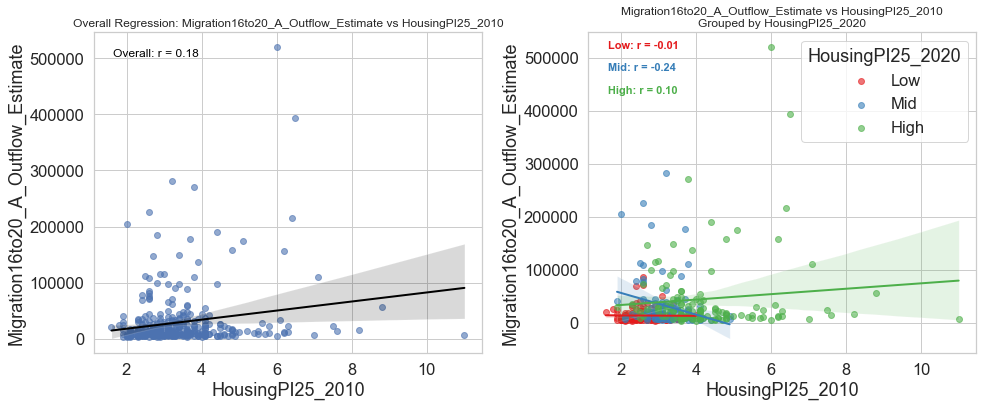

📊 Plot ID 161: X = HousingPI25_2010, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2024


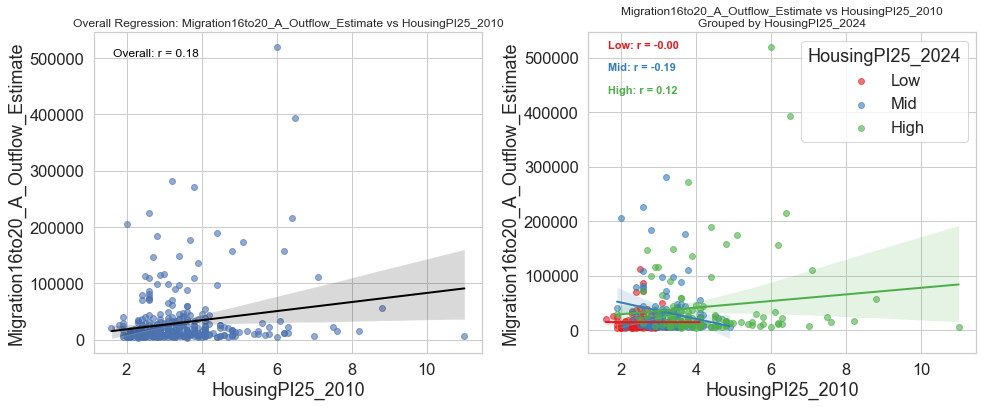

📊 Plot ID 162: X = HousingPI25_2010, Y = HousingPI25_2020, Z = loss_per_capita_pe


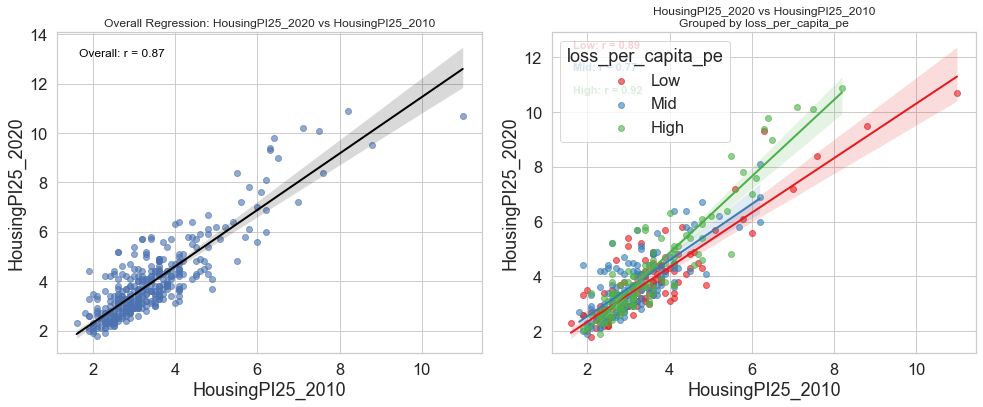

📊 Plot ID 163: X = HousingPI25_2010, Y = HousingPI25_2020, Z = loss_per_capita_bldg


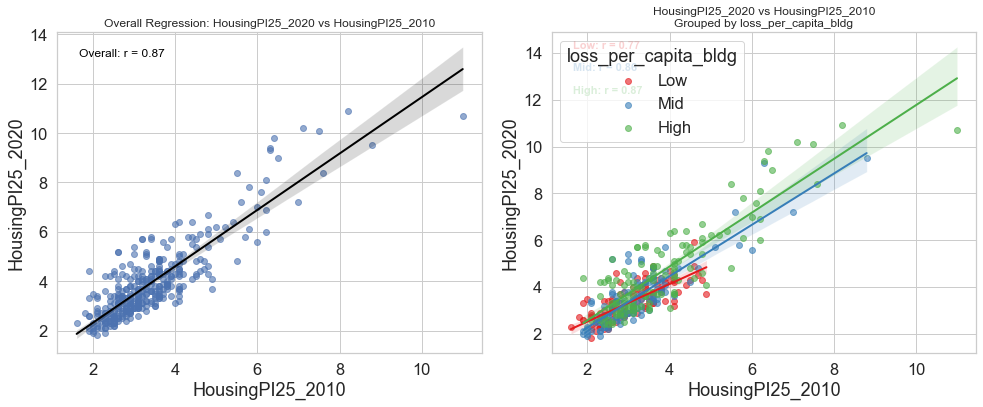

📊 Plot ID 164: X = HousingPI25_2010, Y = HousingPI25_2020, Z = Inflow_rate


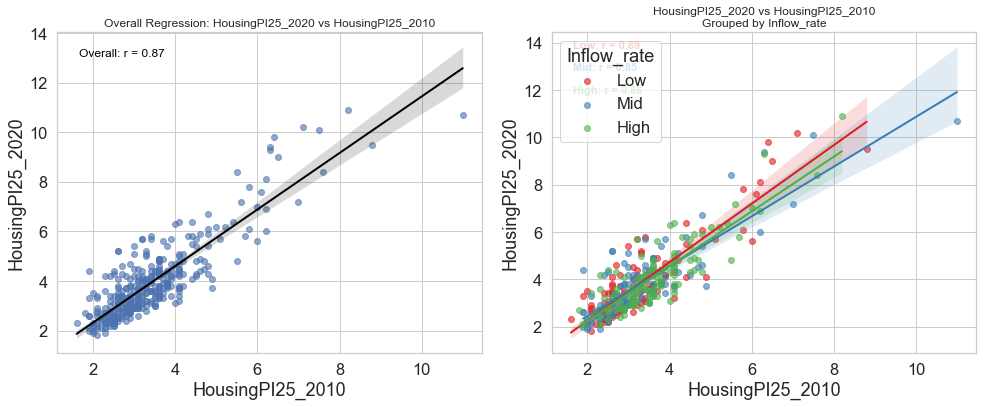

📊 Plot ID 165: X = HousingPI25_2010, Y = HousingPI25_2020, Z = Outflow_rate


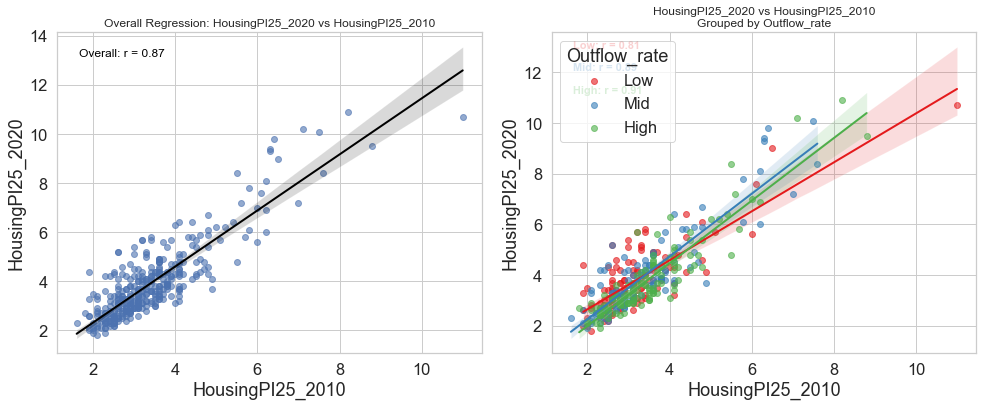

📊 Plot ID 166: X = HousingPI25_2010, Y = HousingPI25_2020, Z = Migration16to20_A_Outflow_Estimate


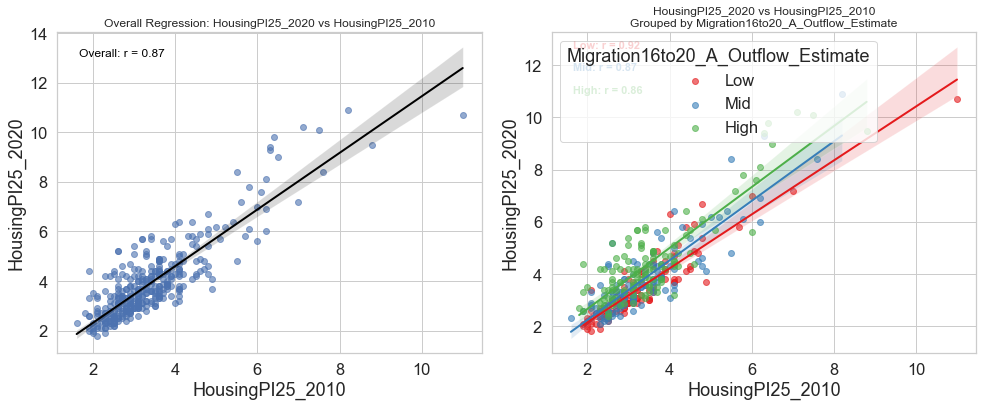

📊 Plot ID 167: X = HousingPI25_2010, Y = HousingPI25_2020, Z = HousingPI25_2000


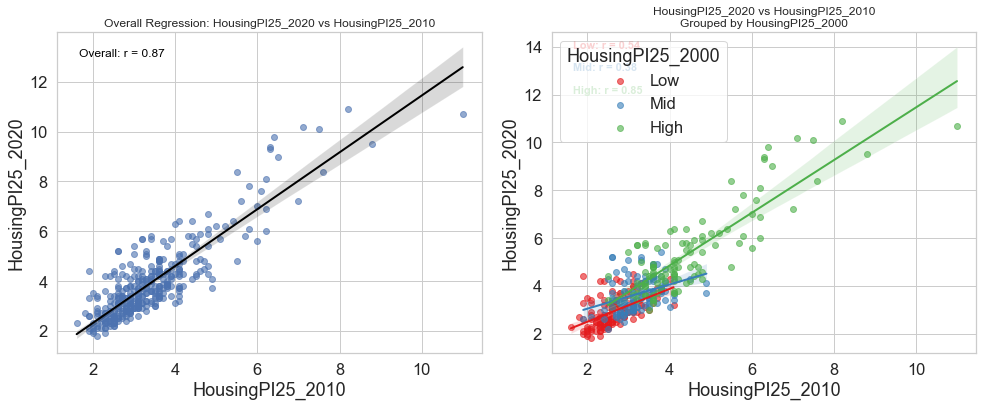

📊 Plot ID 168: X = HousingPI25_2010, Y = HousingPI25_2020, Z = HousingPI25_2024


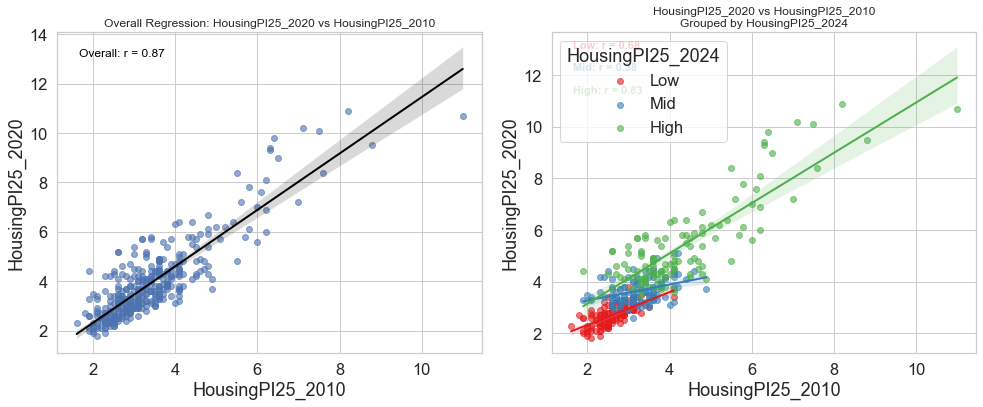

📊 Plot ID 169: X = HousingPI25_2010, Y = HousingPI25_2024, Z = loss_per_capita_pe


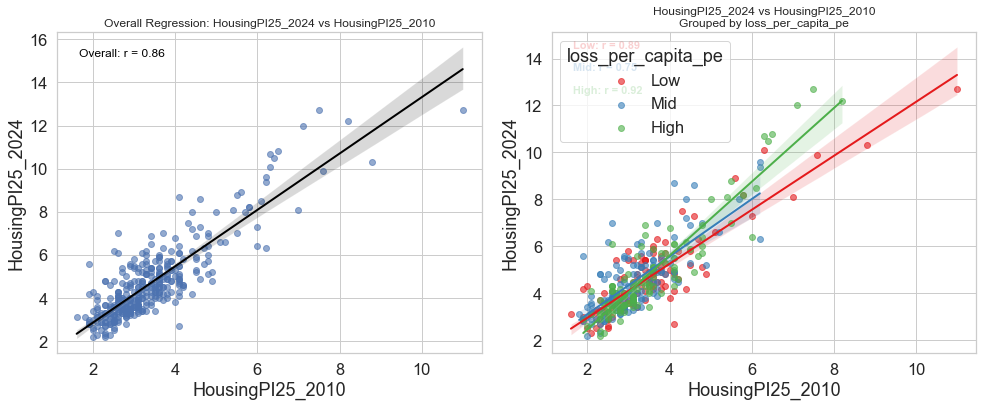

📊 Plot ID 170: X = HousingPI25_2010, Y = HousingPI25_2024, Z = loss_per_capita_bldg


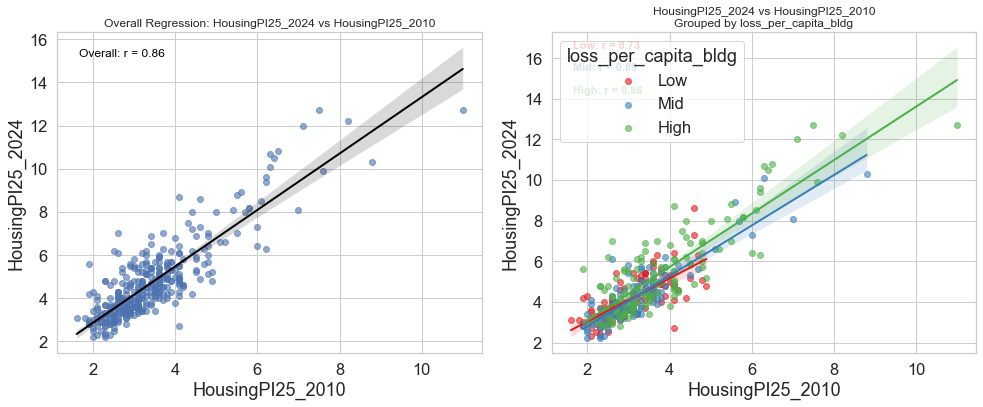

📊 Plot ID 171: X = HousingPI25_2010, Y = HousingPI25_2024, Z = Inflow_rate


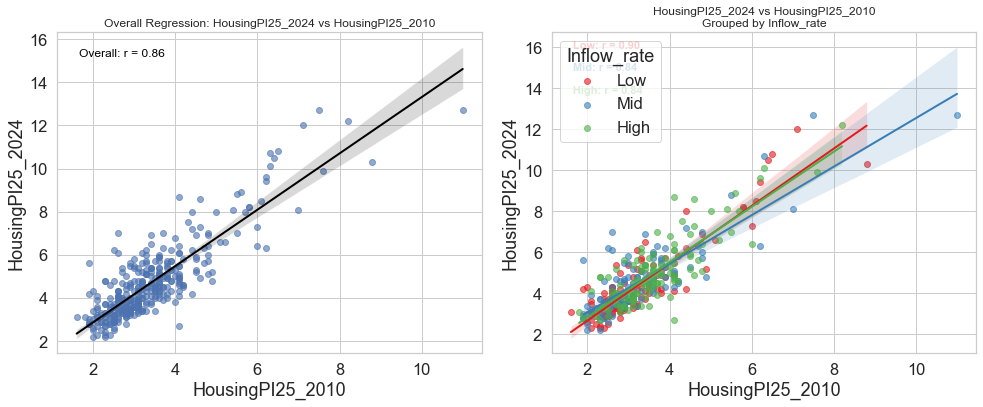

📊 Plot ID 172: X = HousingPI25_2010, Y = HousingPI25_2024, Z = Outflow_rate


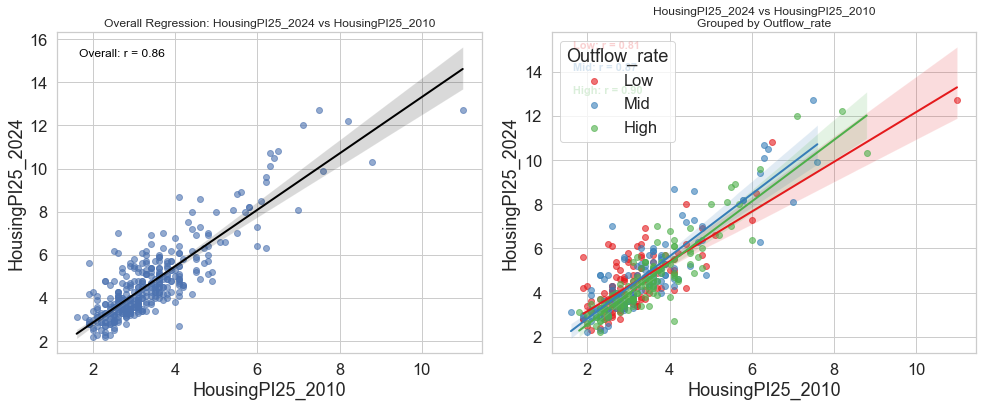

📊 Plot ID 173: X = HousingPI25_2010, Y = HousingPI25_2024, Z = Migration16to20_A_Outflow_Estimate


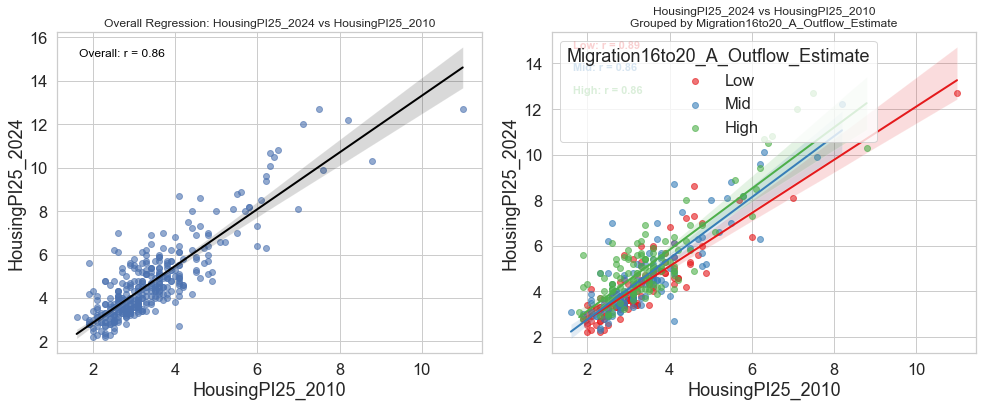

📊 Plot ID 174: X = HousingPI25_2010, Y = HousingPI25_2024, Z = HousingPI25_2000


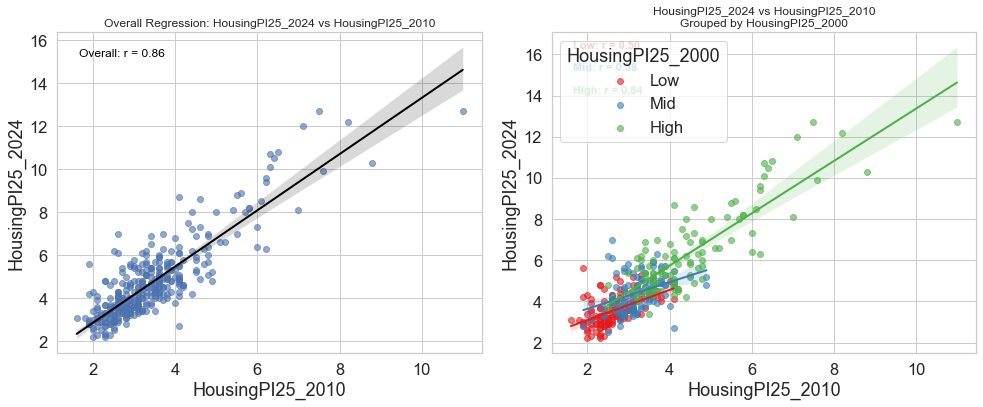

📊 Plot ID 175: X = HousingPI25_2010, Y = HousingPI25_2024, Z = HousingPI25_2020


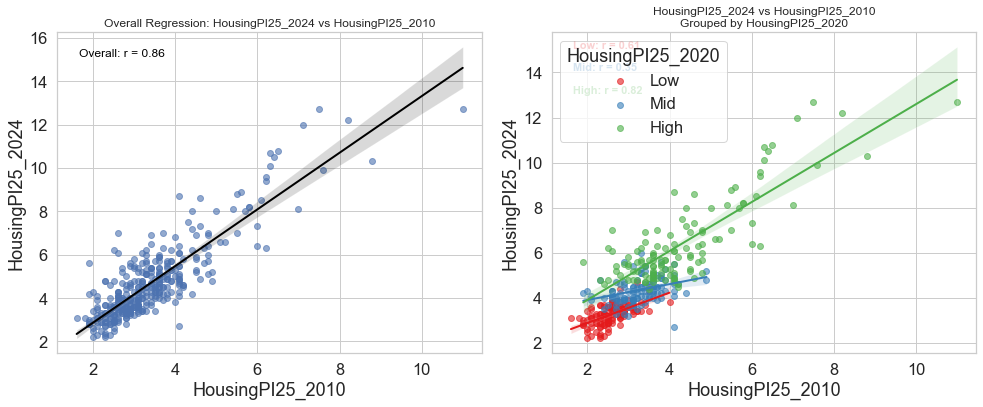

📊 Plot ID 176: X = HousingPI25_2020, Y = loss_per_capita_pe, Z = loss_per_capita_bldg


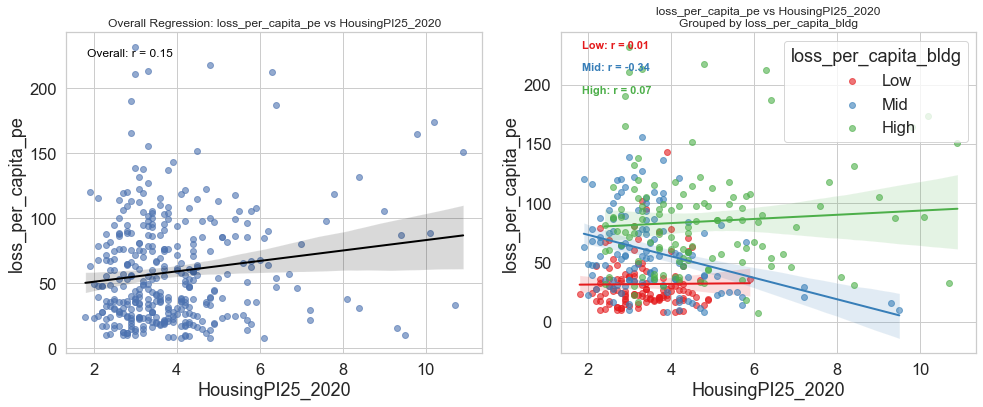

📊 Plot ID 177: X = HousingPI25_2020, Y = loss_per_capita_pe, Z = Inflow_rate


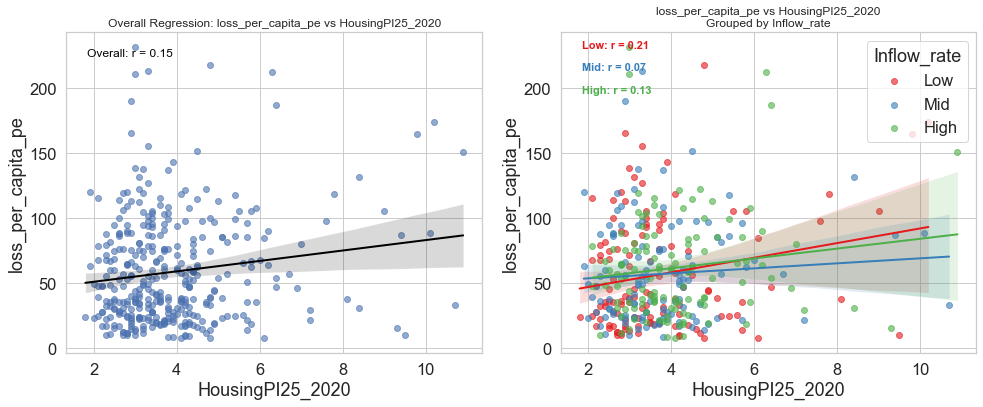

📊 Plot ID 178: X = HousingPI25_2020, Y = loss_per_capita_pe, Z = Outflow_rate


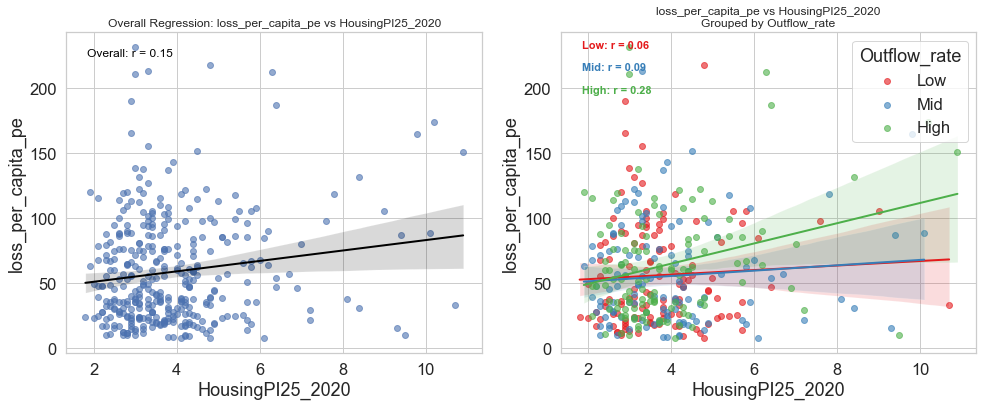

📊 Plot ID 179: X = HousingPI25_2020, Y = loss_per_capita_pe, Z = Migration16to20_A_Outflow_Estimate


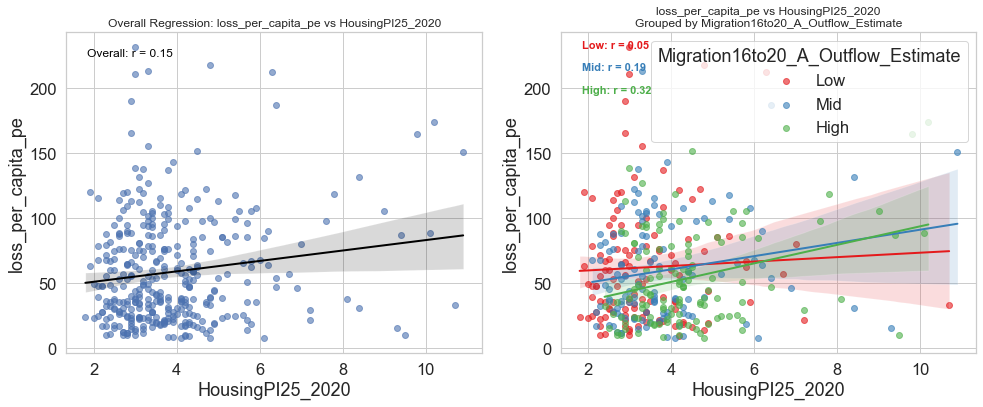

📊 Plot ID 180: X = HousingPI25_2020, Y = loss_per_capita_pe, Z = HousingPI25_2000


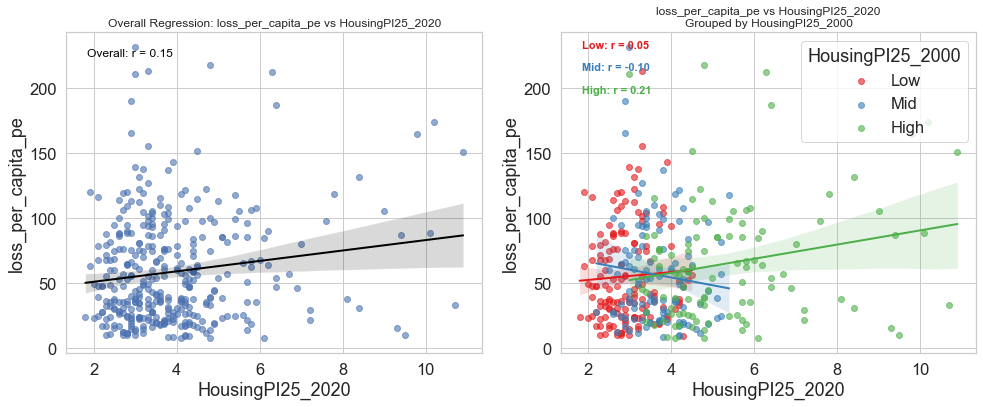

📊 Plot ID 181: X = HousingPI25_2020, Y = loss_per_capita_pe, Z = HousingPI25_2010


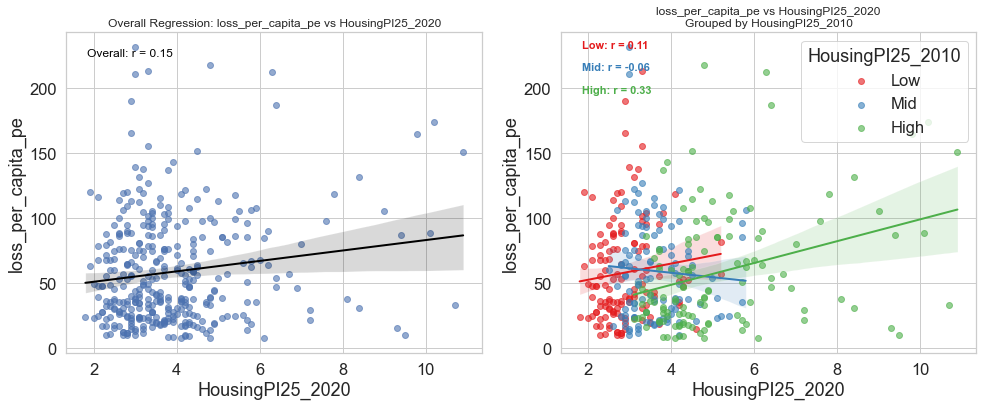

📊 Plot ID 182: X = HousingPI25_2020, Y = loss_per_capita_pe, Z = HousingPI25_2024


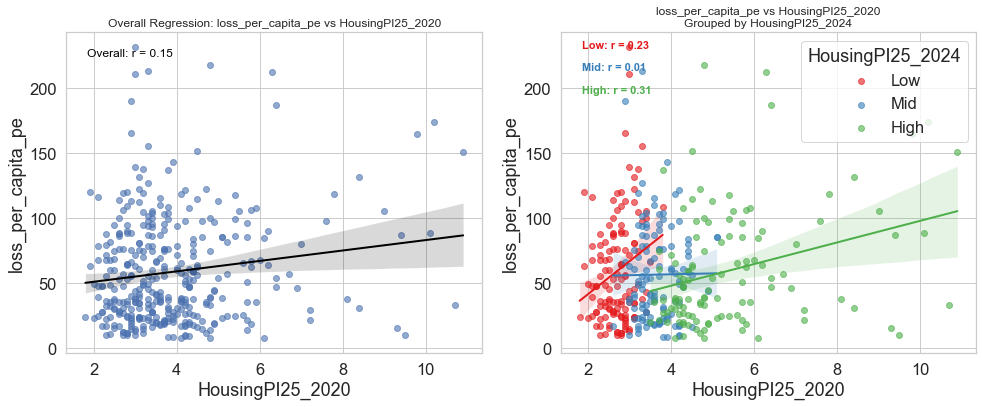

📊 Plot ID 183: X = HousingPI25_2020, Y = loss_per_capita_bldg, Z = loss_per_capita_pe


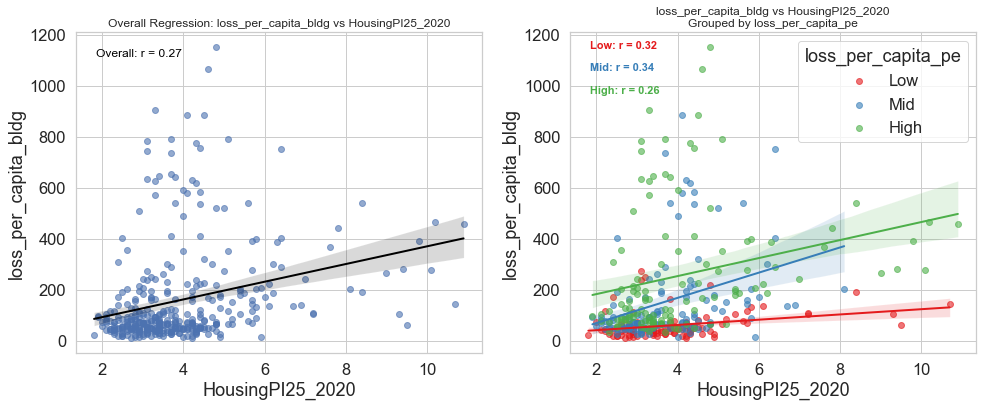

📊 Plot ID 184: X = HousingPI25_2020, Y = loss_per_capita_bldg, Z = Inflow_rate


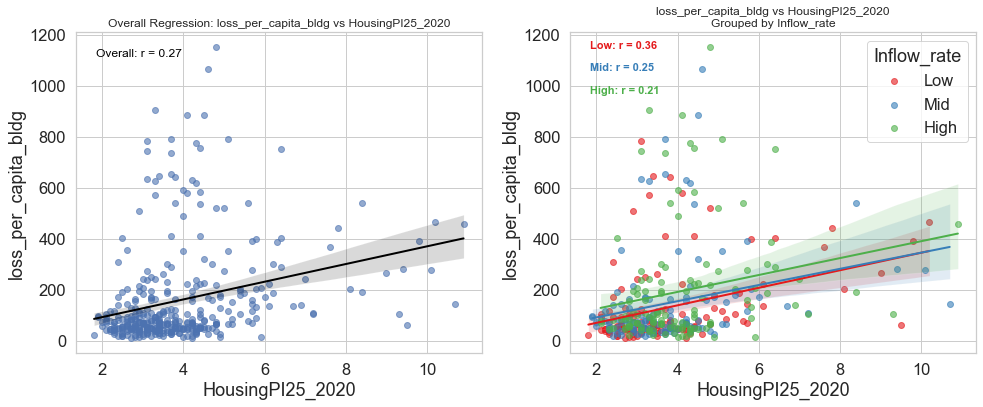

📊 Plot ID 185: X = HousingPI25_2020, Y = loss_per_capita_bldg, Z = Outflow_rate


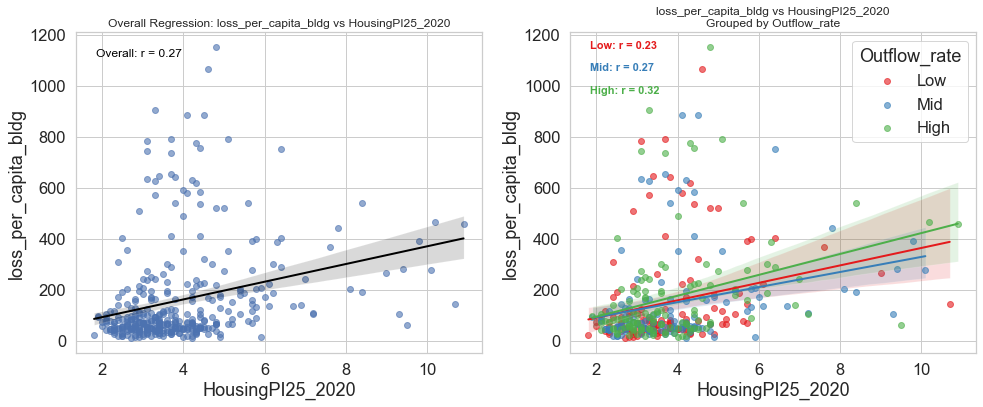

📊 Plot ID 186: X = HousingPI25_2020, Y = loss_per_capita_bldg, Z = Migration16to20_A_Outflow_Estimate


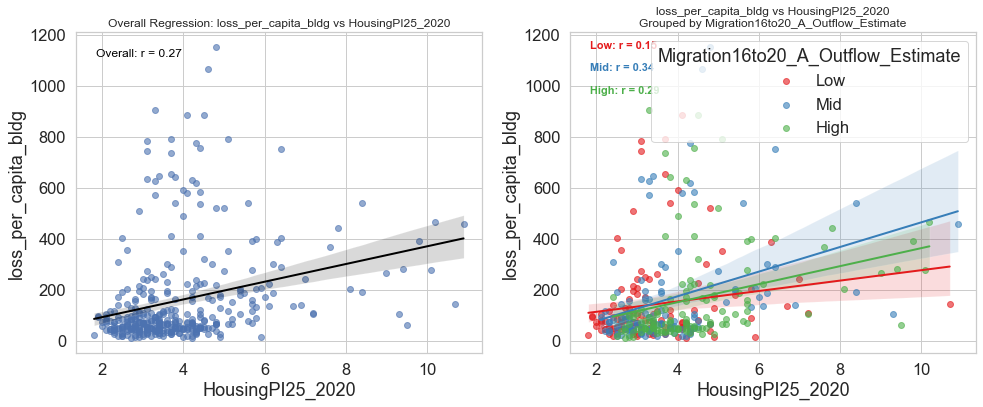

📊 Plot ID 187: X = HousingPI25_2020, Y = loss_per_capita_bldg, Z = HousingPI25_2000


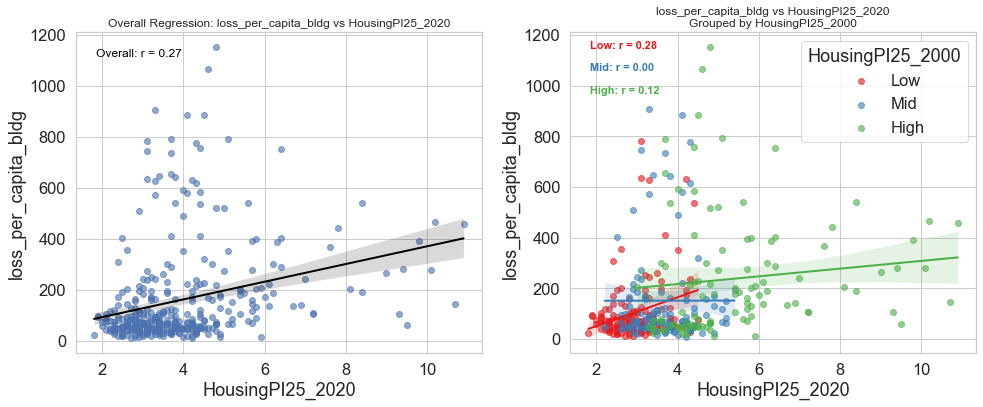

📊 Plot ID 188: X = HousingPI25_2020, Y = loss_per_capita_bldg, Z = HousingPI25_2010


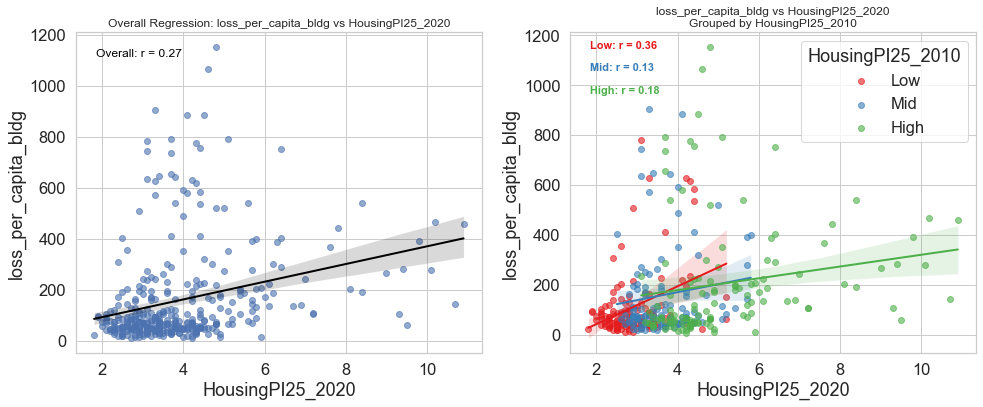

📊 Plot ID 189: X = HousingPI25_2020, Y = loss_per_capita_bldg, Z = HousingPI25_2024


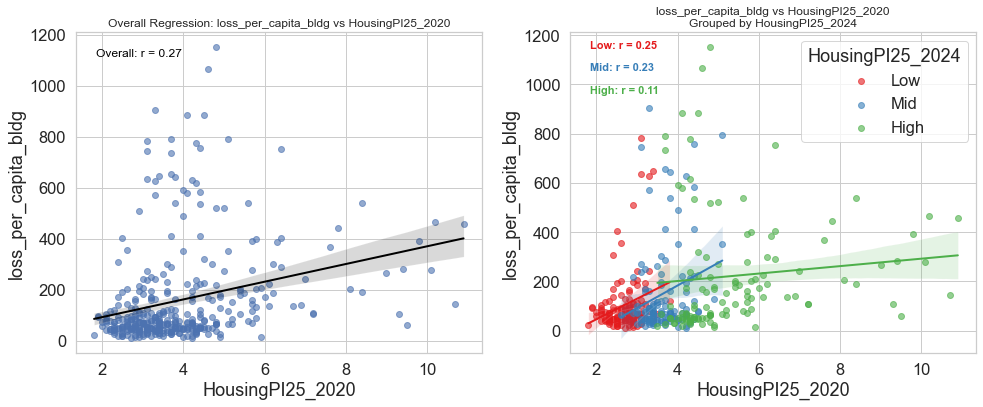

📊 Plot ID 190: X = HousingPI25_2020, Y = Inflow_rate, Z = loss_per_capita_pe


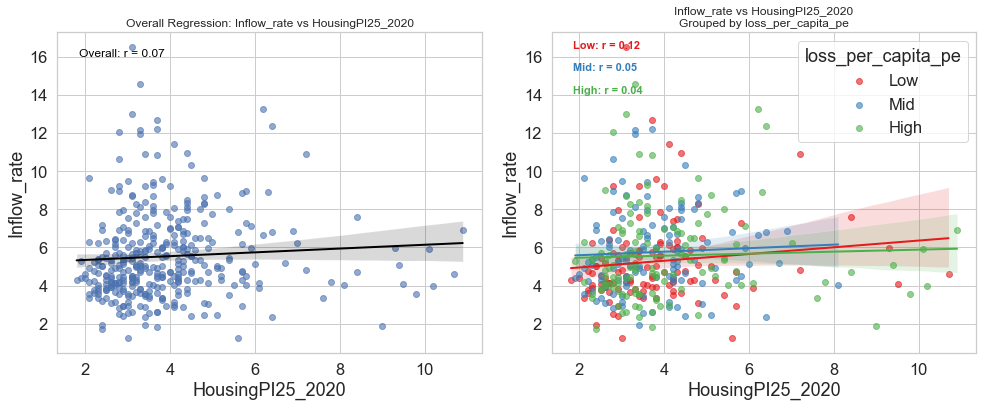

📊 Plot ID 191: X = HousingPI25_2020, Y = Inflow_rate, Z = loss_per_capita_bldg


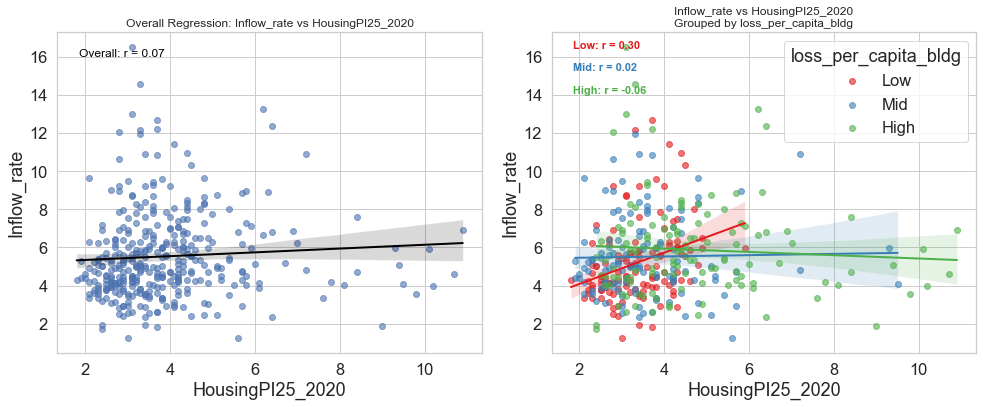

📊 Plot ID 192: X = HousingPI25_2020, Y = Inflow_rate, Z = Outflow_rate


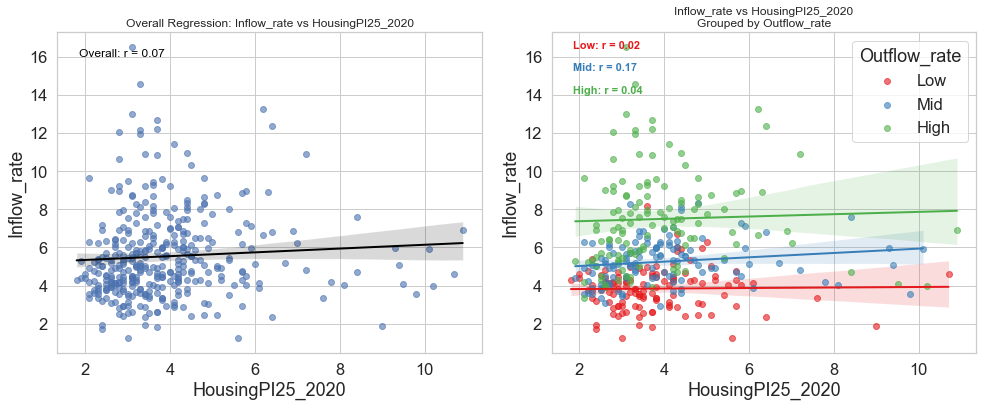

📊 Plot ID 193: X = HousingPI25_2020, Y = Inflow_rate, Z = Migration16to20_A_Outflow_Estimate


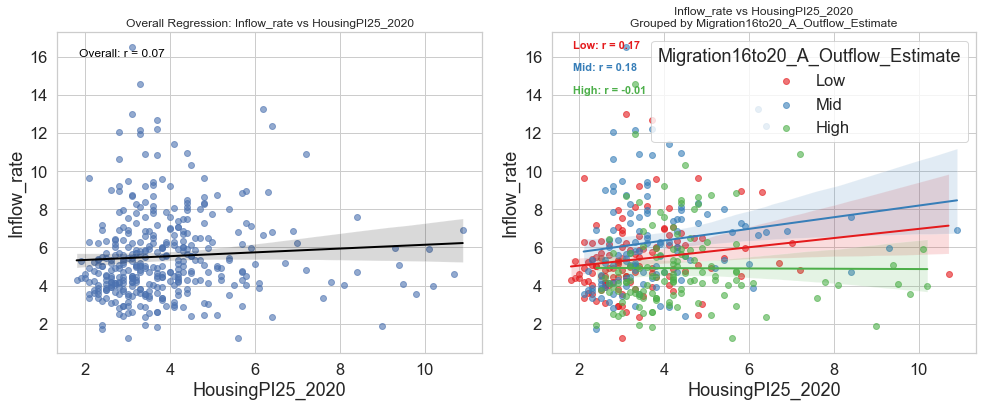

📊 Plot ID 194: X = HousingPI25_2020, Y = Inflow_rate, Z = HousingPI25_2000


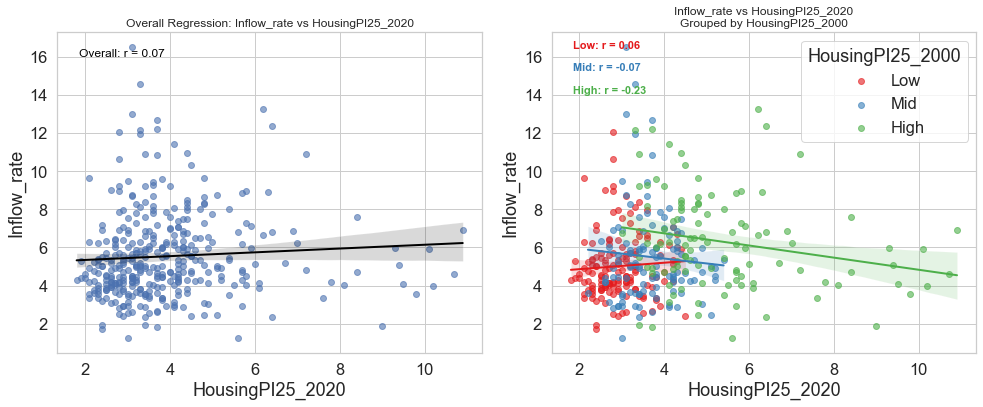

📊 Plot ID 195: X = HousingPI25_2020, Y = Inflow_rate, Z = HousingPI25_2010


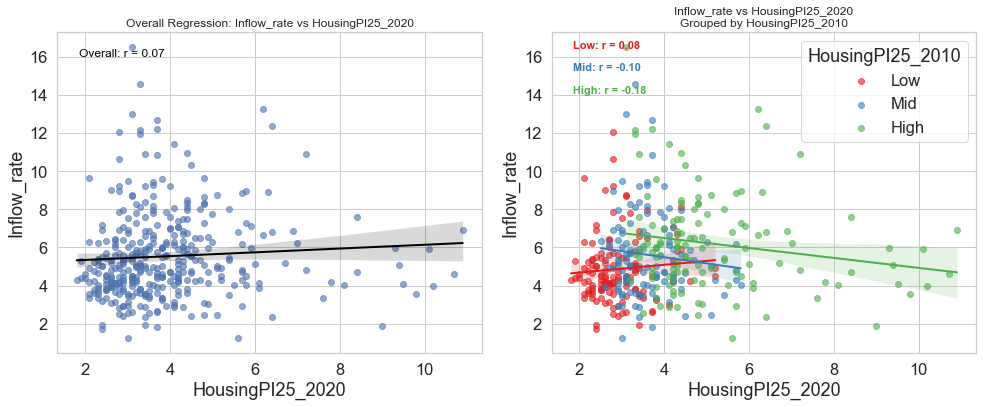

📊 Plot ID 196: X = HousingPI25_2020, Y = Inflow_rate, Z = HousingPI25_2024


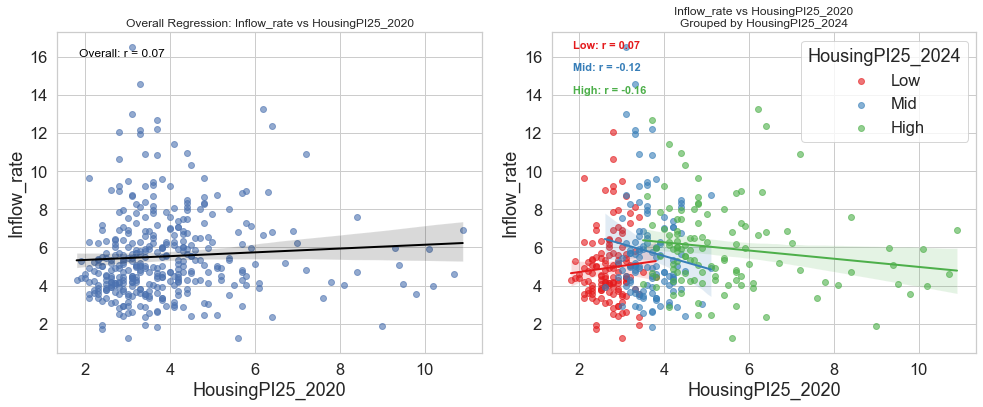

📊 Plot ID 197: X = HousingPI25_2020, Y = Outflow_rate, Z = loss_per_capita_pe


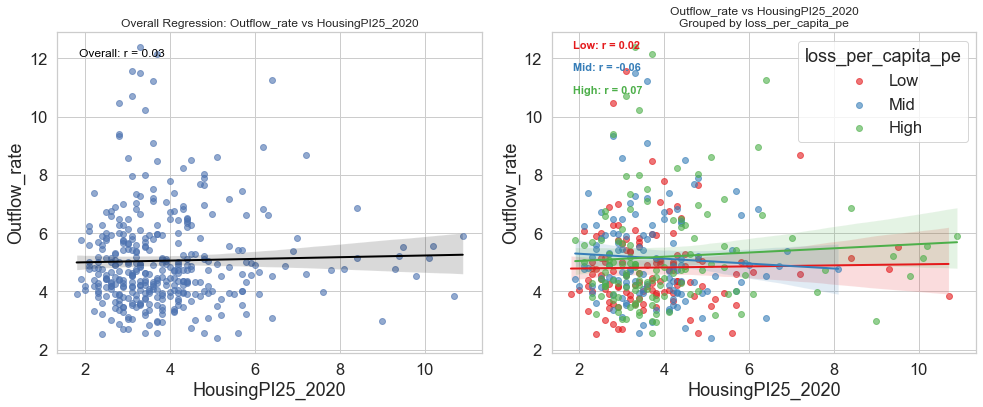

📊 Plot ID 198: X = HousingPI25_2020, Y = Outflow_rate, Z = loss_per_capita_bldg


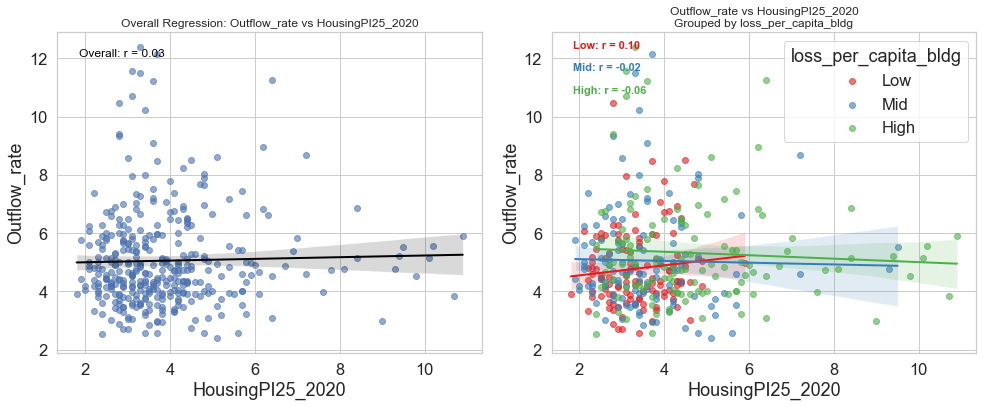

📊 Plot ID 199: X = HousingPI25_2020, Y = Outflow_rate, Z = Inflow_rate


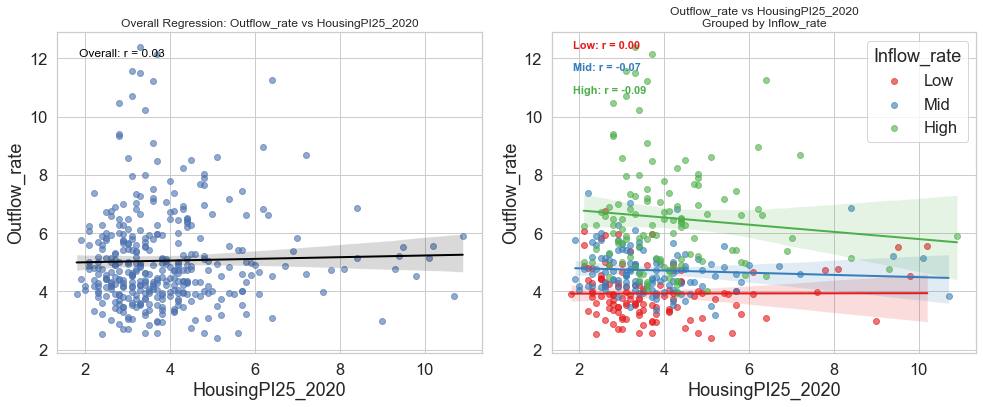

📊 Plot ID 200: X = HousingPI25_2020, Y = Outflow_rate, Z = Migration16to20_A_Outflow_Estimate


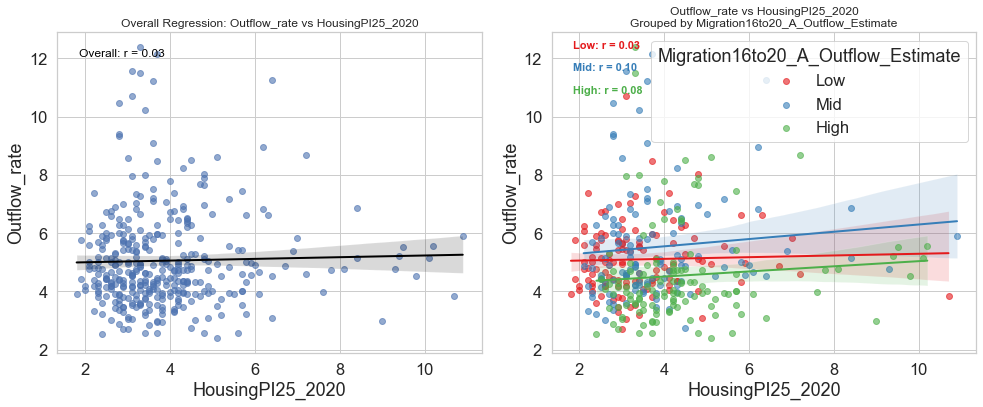

📊 Plot ID 201: X = HousingPI25_2020, Y = Outflow_rate, Z = HousingPI25_2000


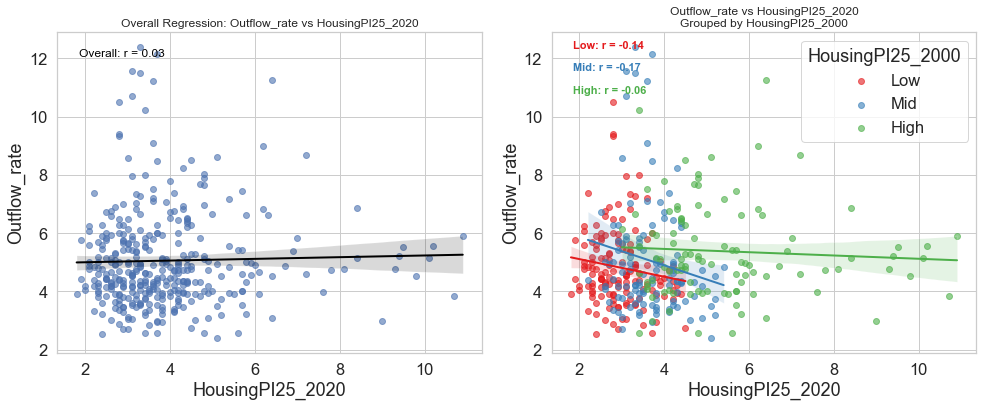

📊 Plot ID 202: X = HousingPI25_2020, Y = Outflow_rate, Z = HousingPI25_2010


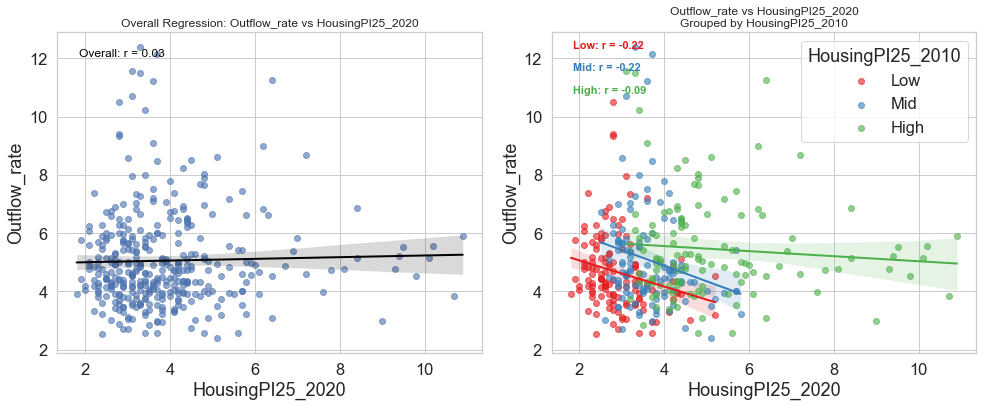

📊 Plot ID 203: X = HousingPI25_2020, Y = Outflow_rate, Z = HousingPI25_2024


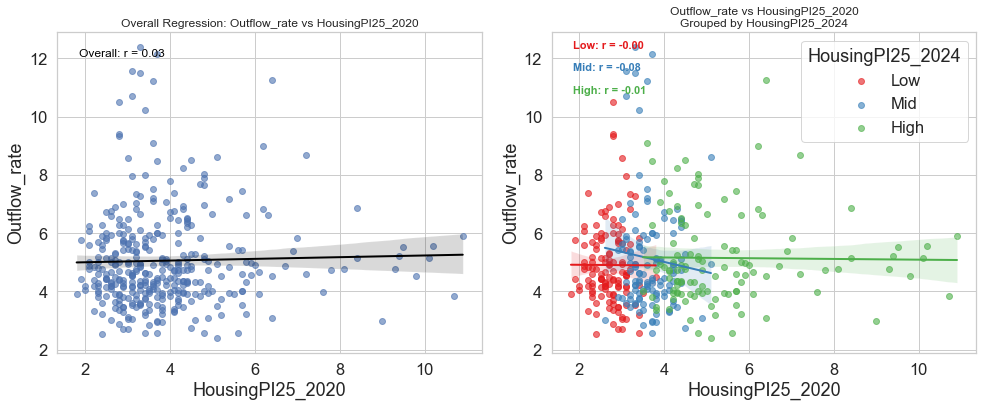

📊 Plot ID 204: X = HousingPI25_2020, Y = Migration16to20_A_Outflow_Estimate, Z = loss_per_capita_pe


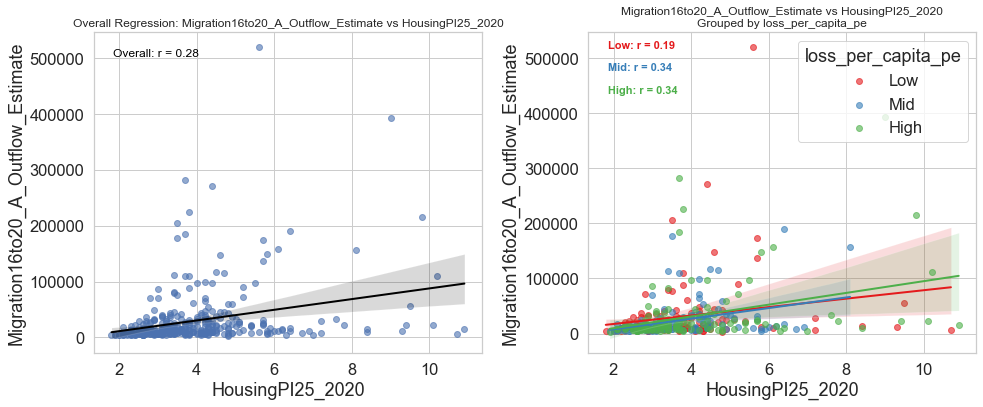

📊 Plot ID 205: X = HousingPI25_2020, Y = Migration16to20_A_Outflow_Estimate, Z = loss_per_capita_bldg


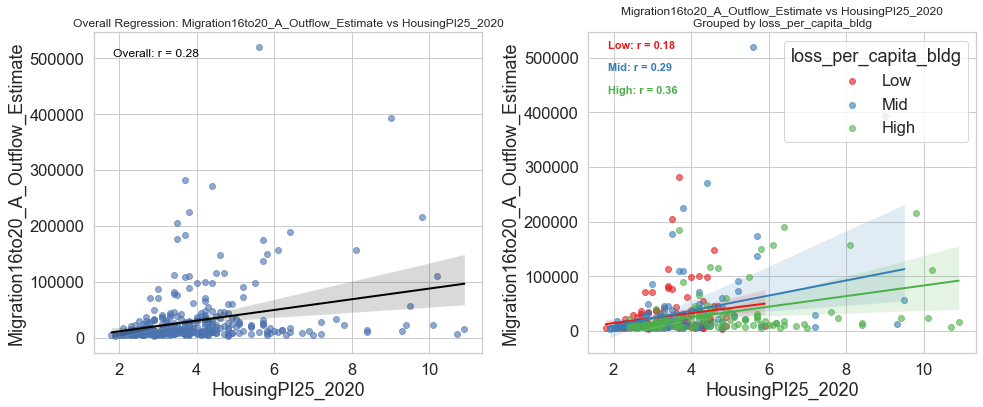

📊 Plot ID 206: X = HousingPI25_2020, Y = Migration16to20_A_Outflow_Estimate, Z = Inflow_rate


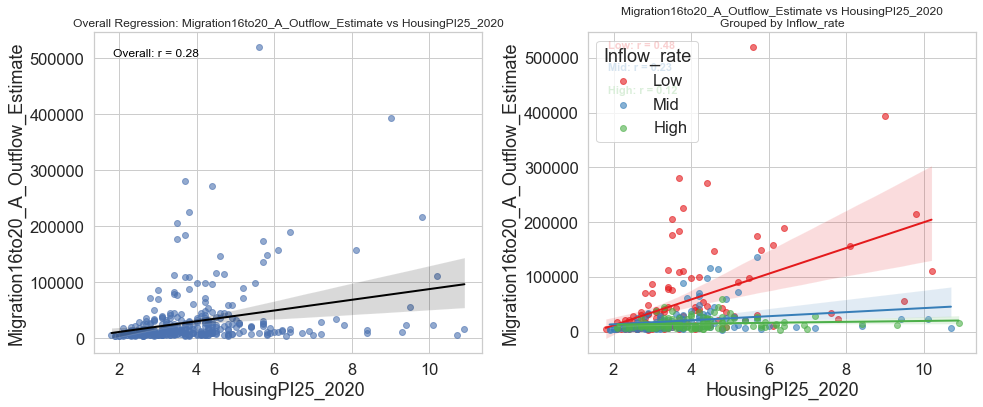

📊 Plot ID 207: X = HousingPI25_2020, Y = Migration16to20_A_Outflow_Estimate, Z = Outflow_rate


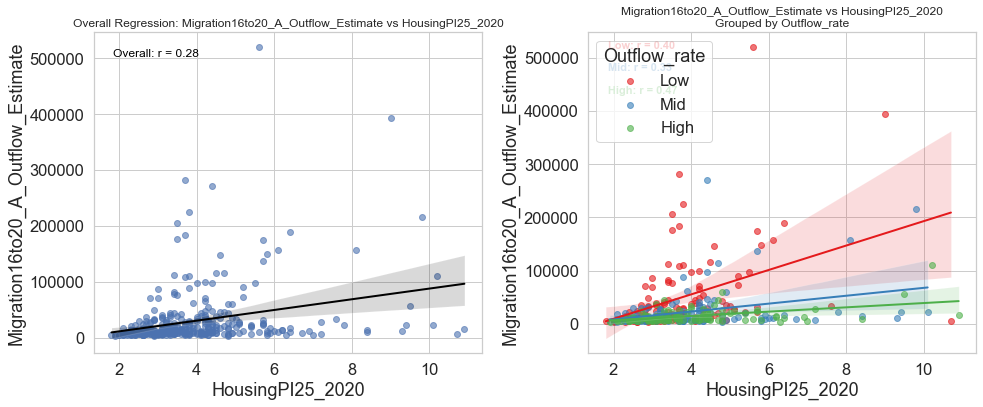

📊 Plot ID 208: X = HousingPI25_2020, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2000


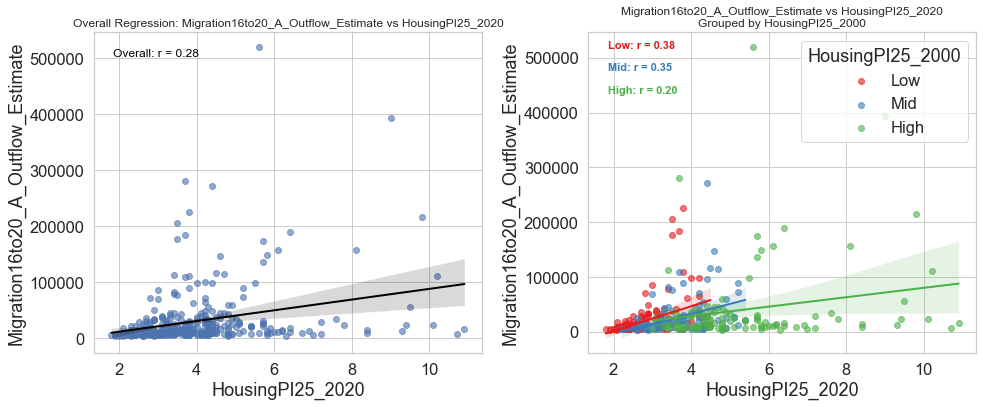

📊 Plot ID 209: X = HousingPI25_2020, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2010


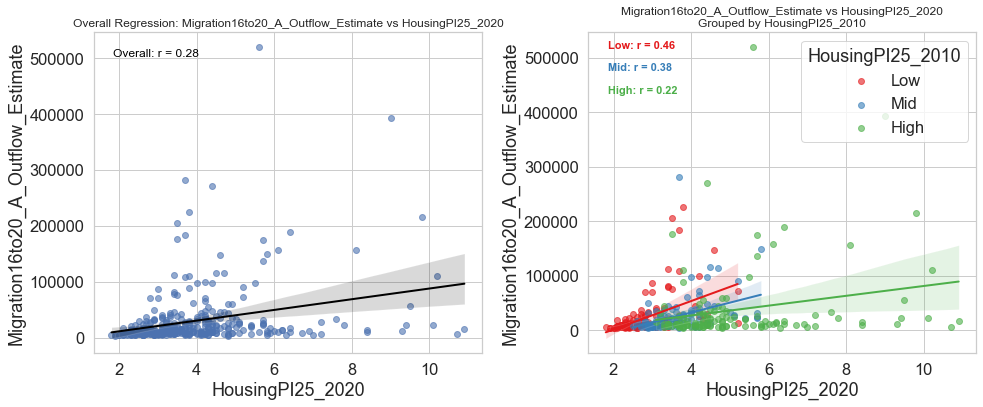

📊 Plot ID 210: X = HousingPI25_2020, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2024


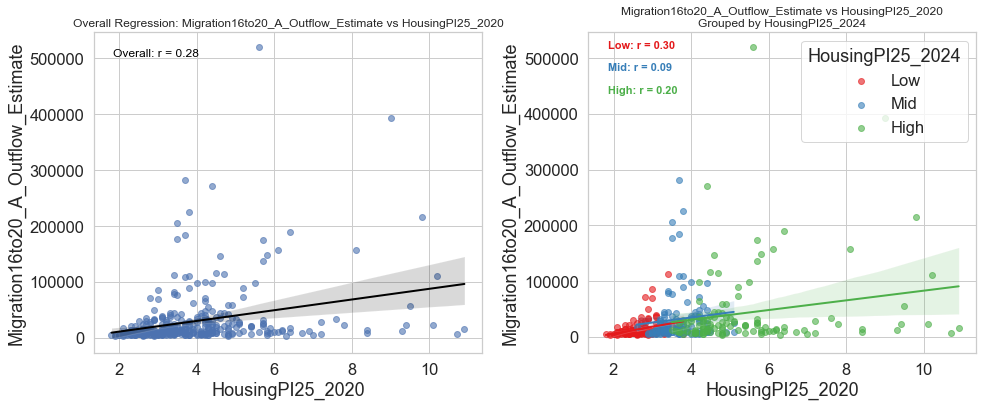

📊 Plot ID 211: X = HousingPI25_2020, Y = HousingPI25_2024, Z = loss_per_capita_pe


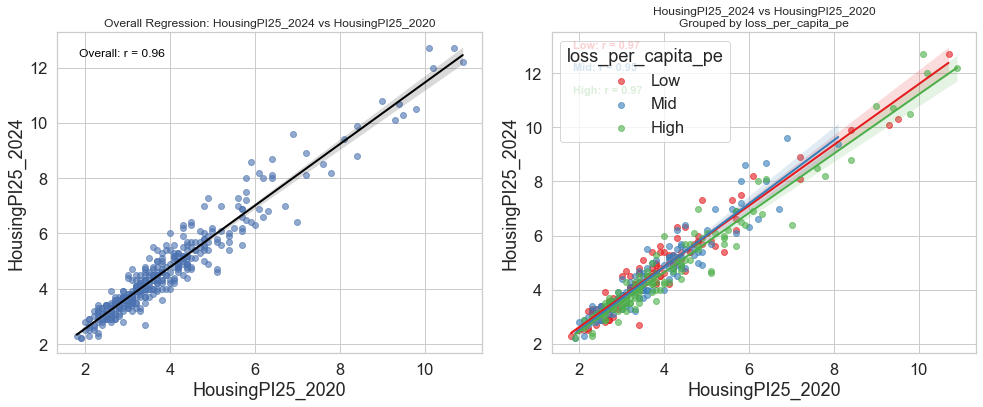

📊 Plot ID 212: X = HousingPI25_2020, Y = HousingPI25_2024, Z = loss_per_capita_bldg


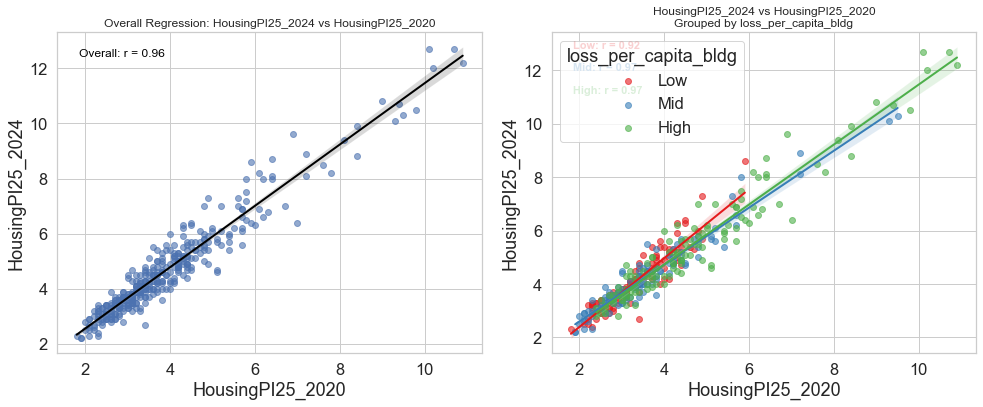

📊 Plot ID 213: X = HousingPI25_2020, Y = HousingPI25_2024, Z = Inflow_rate


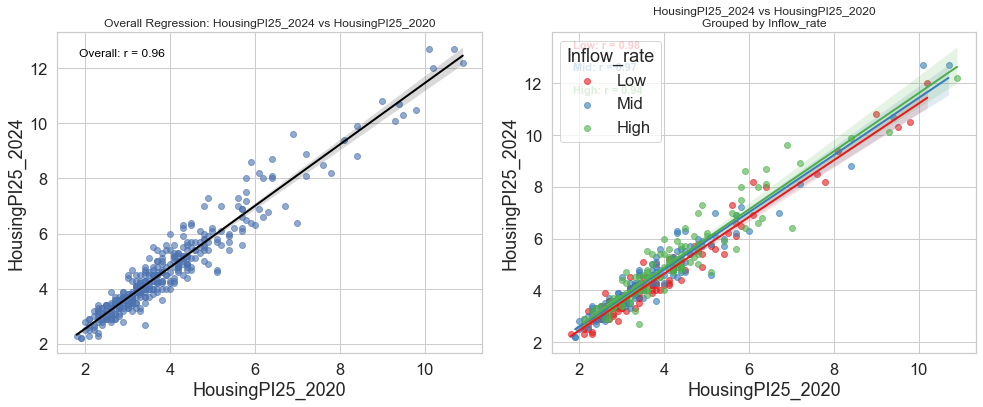

📊 Plot ID 214: X = HousingPI25_2020, Y = HousingPI25_2024, Z = Outflow_rate


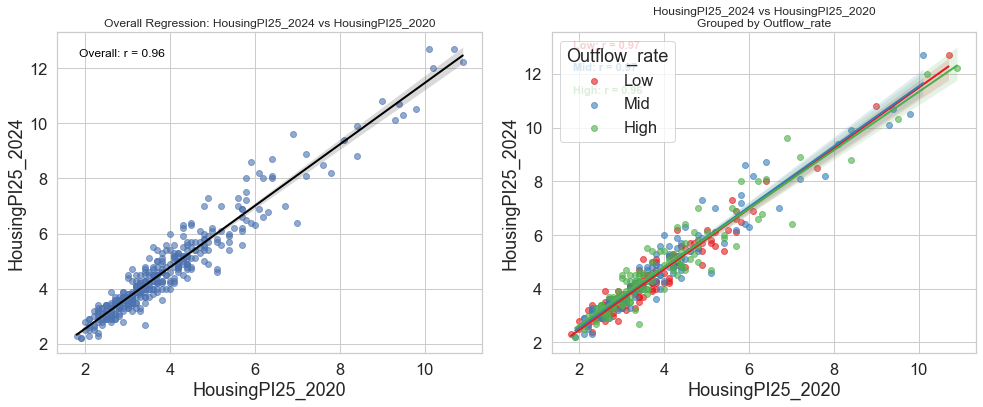

📊 Plot ID 215: X = HousingPI25_2020, Y = HousingPI25_2024, Z = Migration16to20_A_Outflow_Estimate


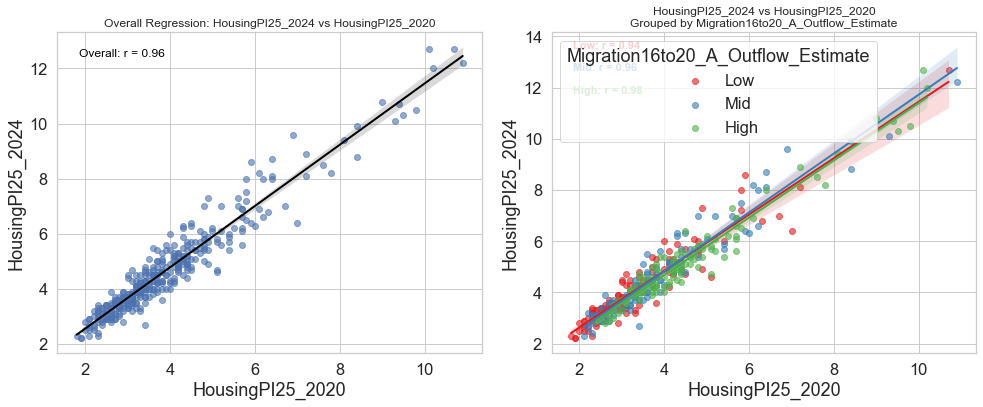

📊 Plot ID 216: X = HousingPI25_2020, Y = HousingPI25_2024, Z = HousingPI25_2000


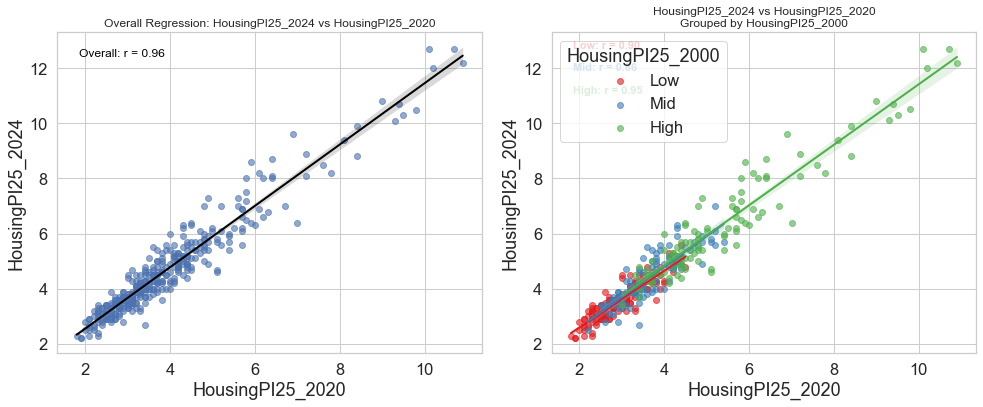

📊 Plot ID 217: X = HousingPI25_2020, Y = HousingPI25_2024, Z = HousingPI25_2010


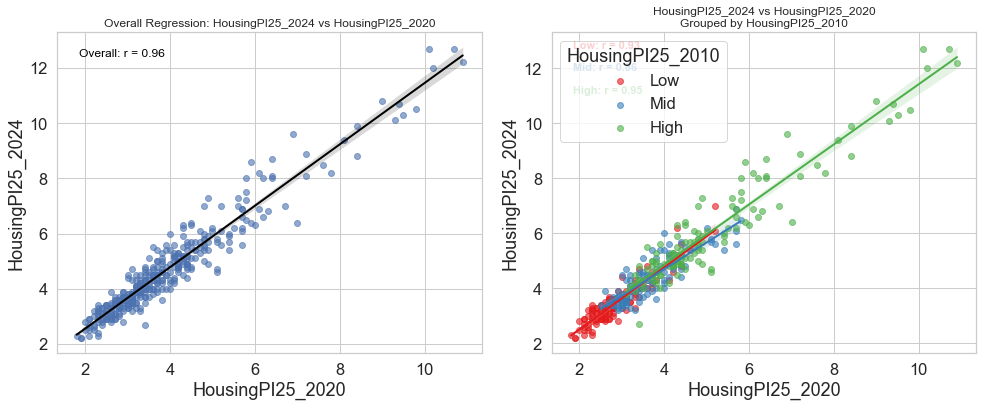

📊 Plot ID 218: X = HousingPI25_2024, Y = loss_per_capita_pe, Z = loss_per_capita_bldg


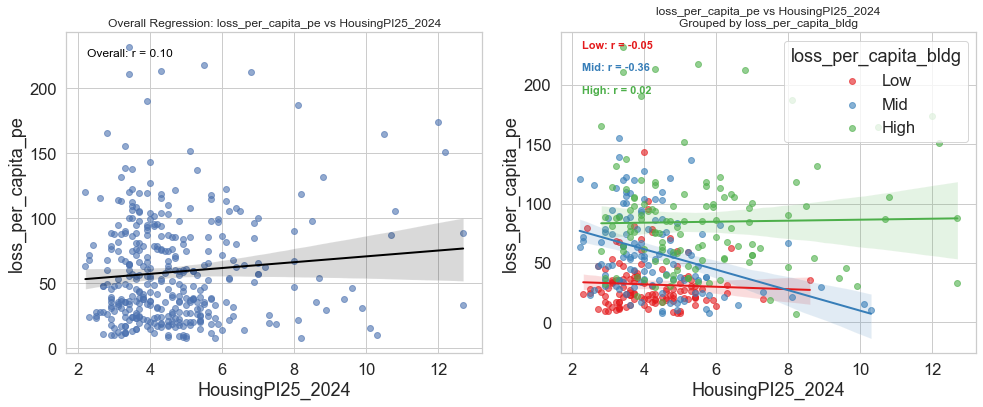

📊 Plot ID 219: X = HousingPI25_2024, Y = loss_per_capita_pe, Z = Inflow_rate


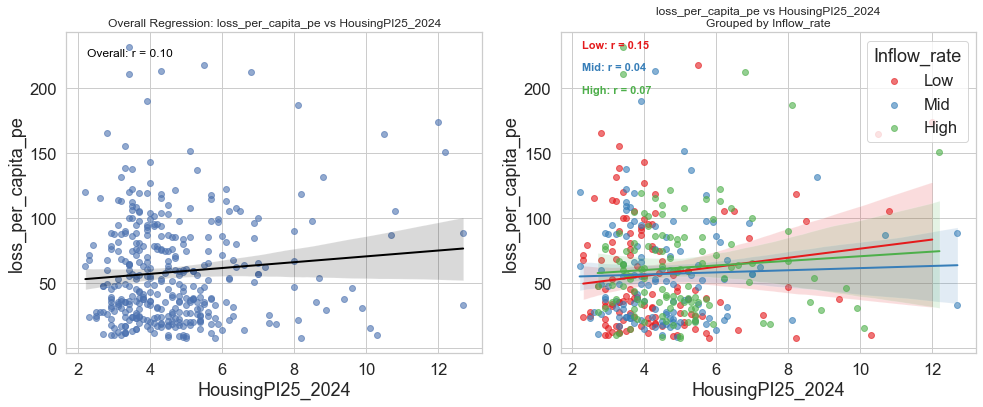

📊 Plot ID 220: X = HousingPI25_2024, Y = loss_per_capita_pe, Z = Outflow_rate


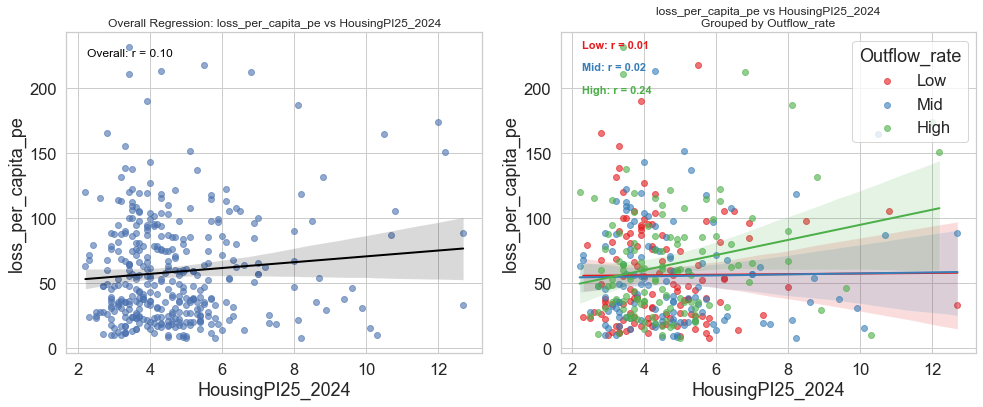

📊 Plot ID 221: X = HousingPI25_2024, Y = loss_per_capita_pe, Z = Migration16to20_A_Outflow_Estimate


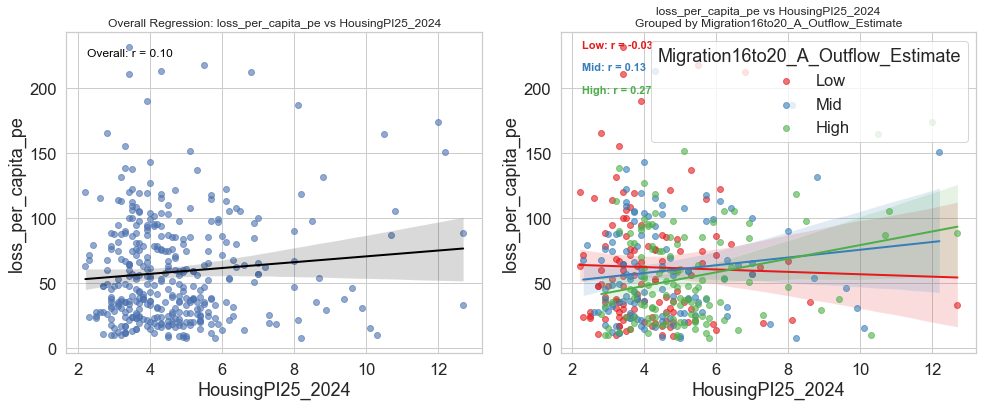

📊 Plot ID 222: X = HousingPI25_2024, Y = loss_per_capita_pe, Z = HousingPI25_2000


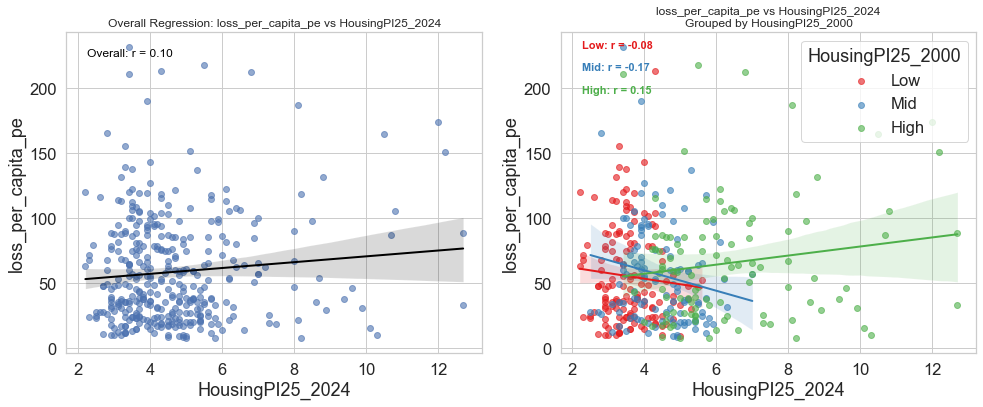

📊 Plot ID 223: X = HousingPI25_2024, Y = loss_per_capita_pe, Z = HousingPI25_2010


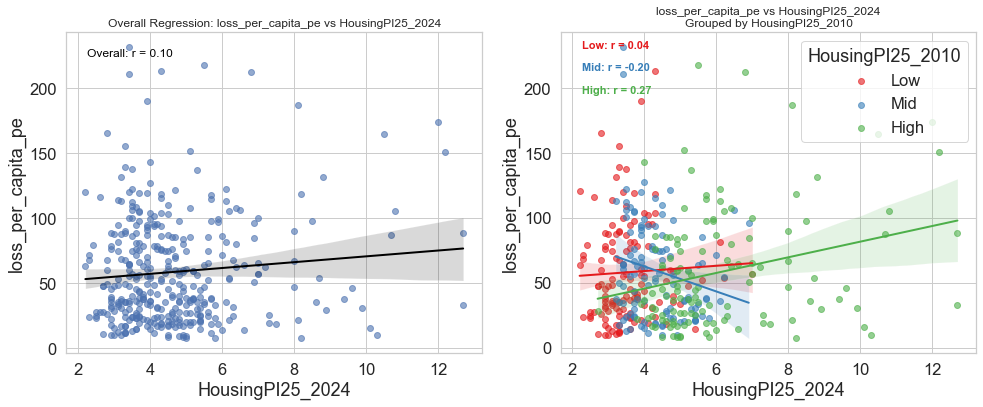

📊 Plot ID 224: X = HousingPI25_2024, Y = loss_per_capita_pe, Z = HousingPI25_2020


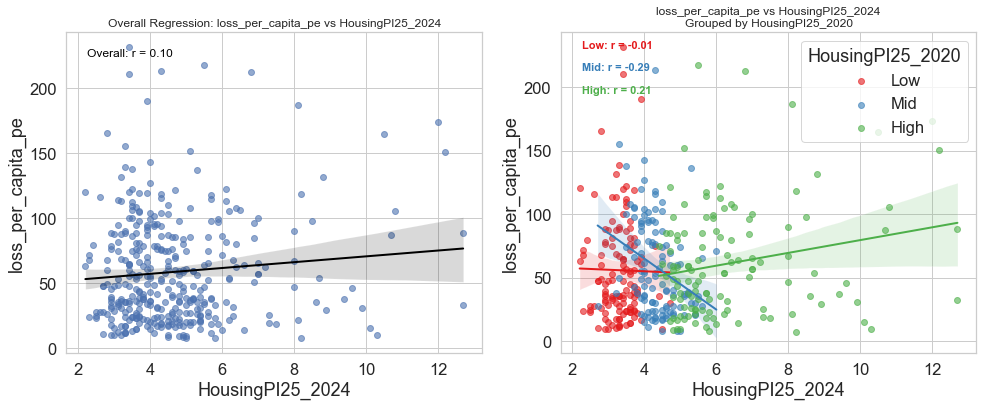

📊 Plot ID 225: X = HousingPI25_2024, Y = loss_per_capita_bldg, Z = loss_per_capita_pe


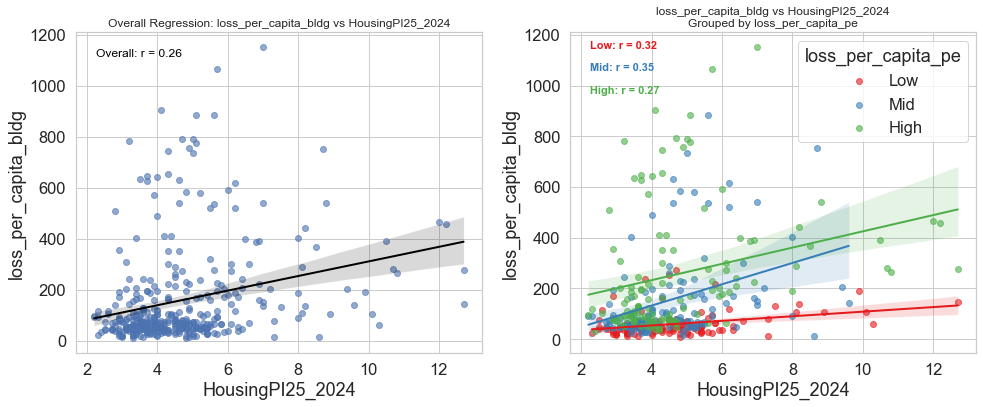

📊 Plot ID 226: X = HousingPI25_2024, Y = loss_per_capita_bldg, Z = Inflow_rate


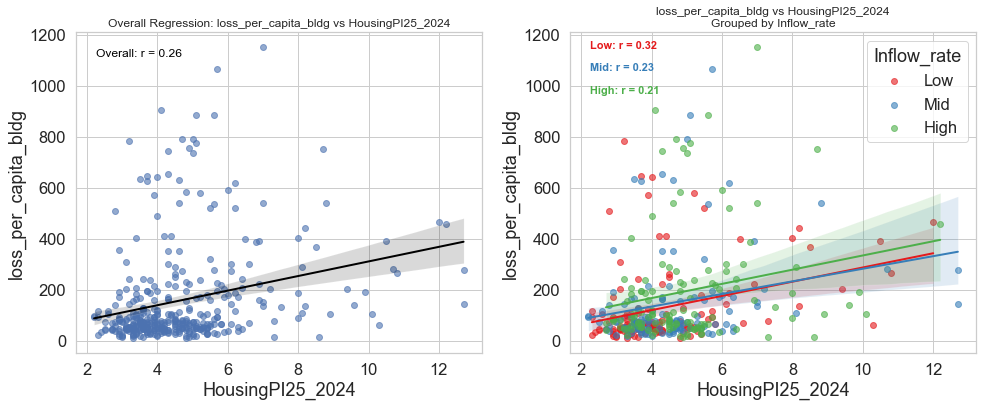

📊 Plot ID 227: X = HousingPI25_2024, Y = loss_per_capita_bldg, Z = Outflow_rate


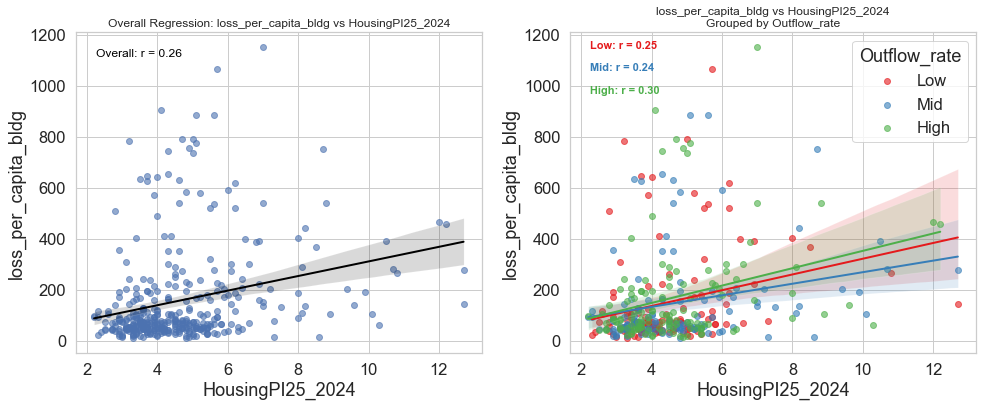

📊 Plot ID 228: X = HousingPI25_2024, Y = loss_per_capita_bldg, Z = Migration16to20_A_Outflow_Estimate


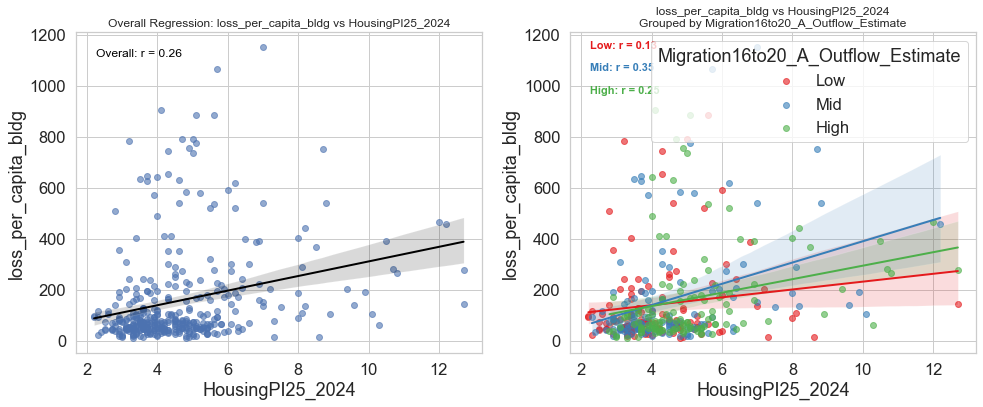

📊 Plot ID 229: X = HousingPI25_2024, Y = loss_per_capita_bldg, Z = HousingPI25_2000


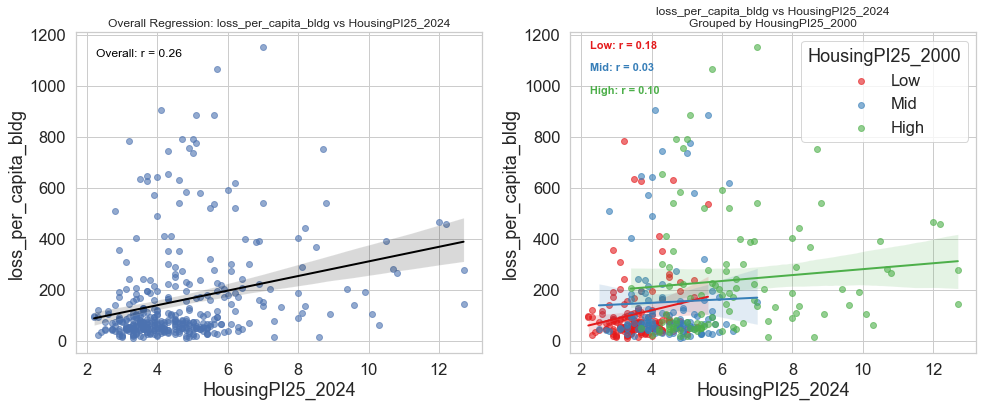

📊 Plot ID 230: X = HousingPI25_2024, Y = loss_per_capita_bldg, Z = HousingPI25_2010


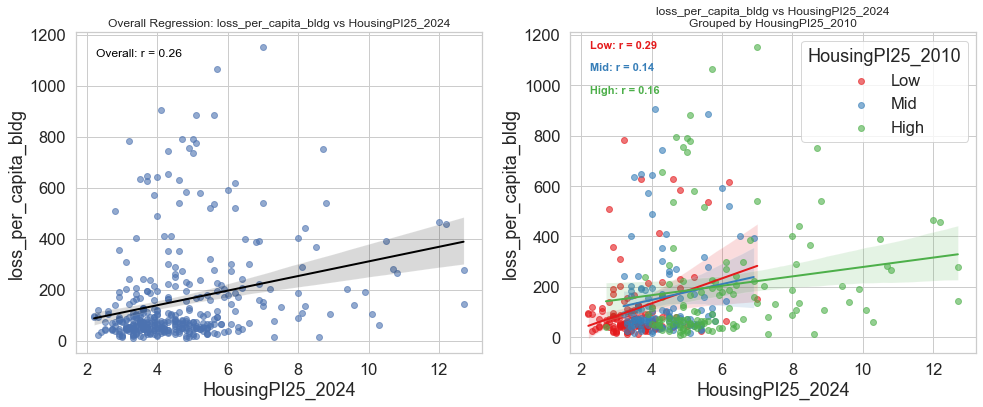

📊 Plot ID 231: X = HousingPI25_2024, Y = loss_per_capita_bldg, Z = HousingPI25_2020


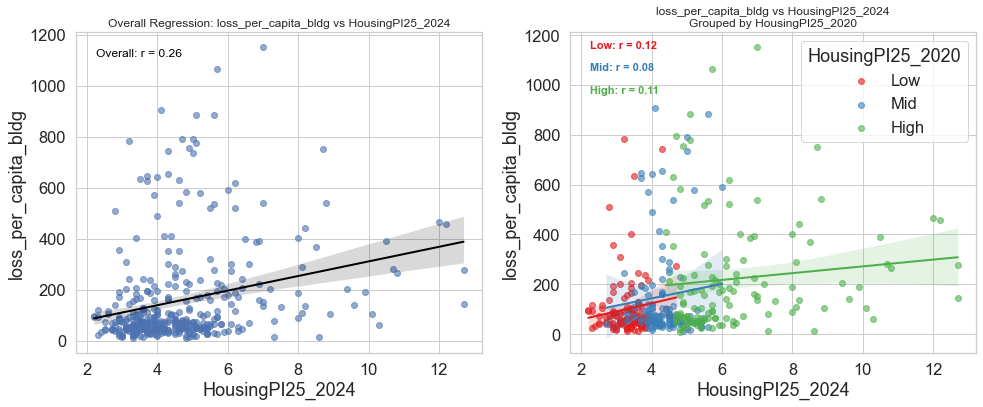

📊 Plot ID 232: X = HousingPI25_2024, Y = Inflow_rate, Z = loss_per_capita_pe


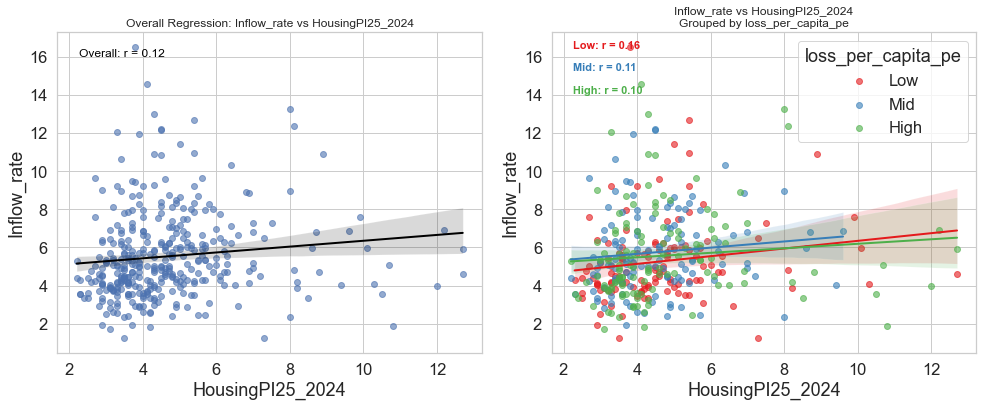

📊 Plot ID 233: X = HousingPI25_2024, Y = Inflow_rate, Z = loss_per_capita_bldg


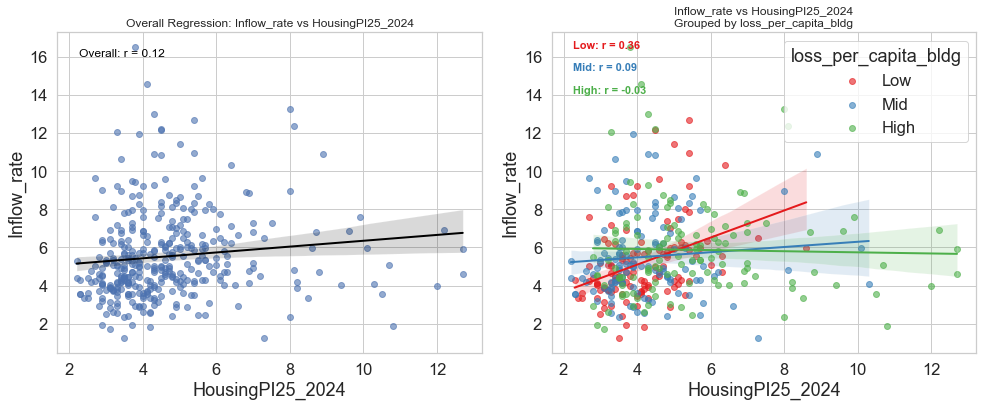

📊 Plot ID 234: X = HousingPI25_2024, Y = Inflow_rate, Z = Outflow_rate


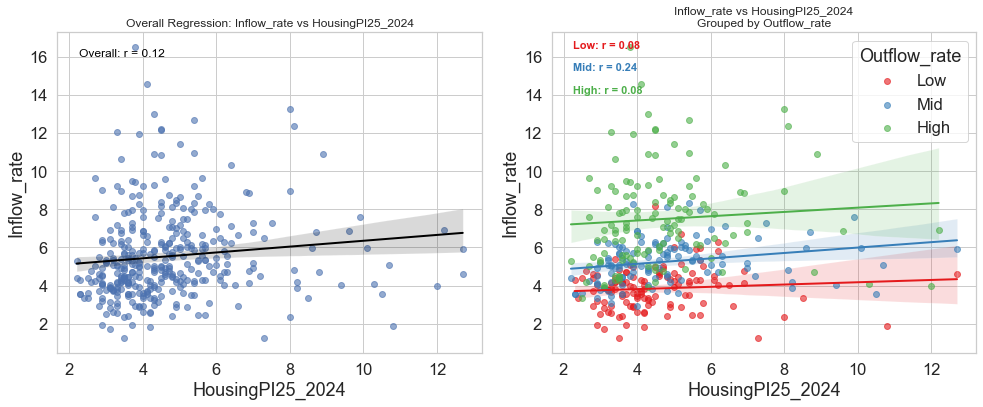

📊 Plot ID 235: X = HousingPI25_2024, Y = Inflow_rate, Z = Migration16to20_A_Outflow_Estimate


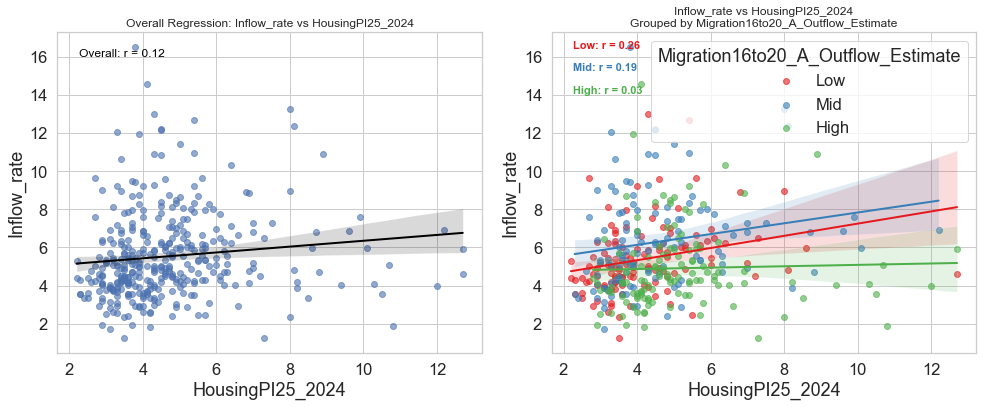

📊 Plot ID 236: X = HousingPI25_2024, Y = Inflow_rate, Z = HousingPI25_2000


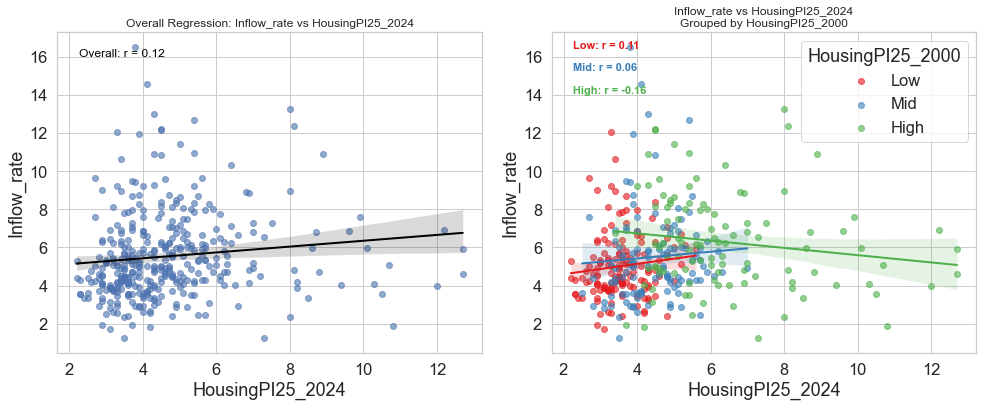

📊 Plot ID 237: X = HousingPI25_2024, Y = Inflow_rate, Z = HousingPI25_2010


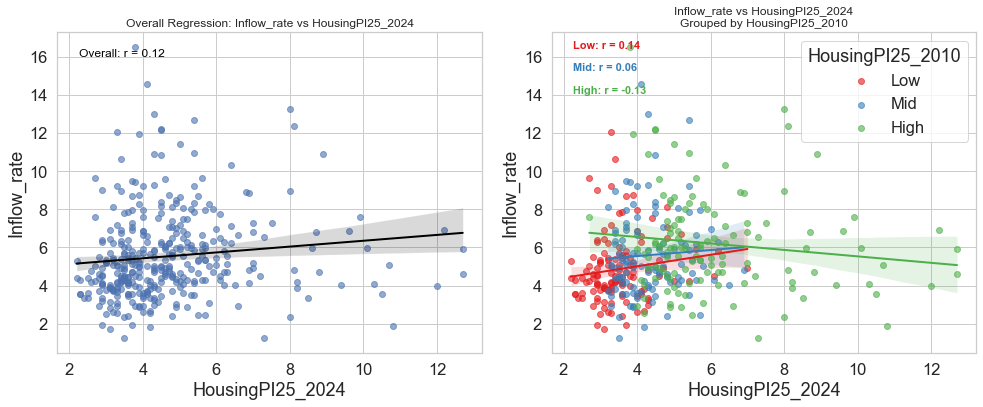

📊 Plot ID 238: X = HousingPI25_2024, Y = Inflow_rate, Z = HousingPI25_2020


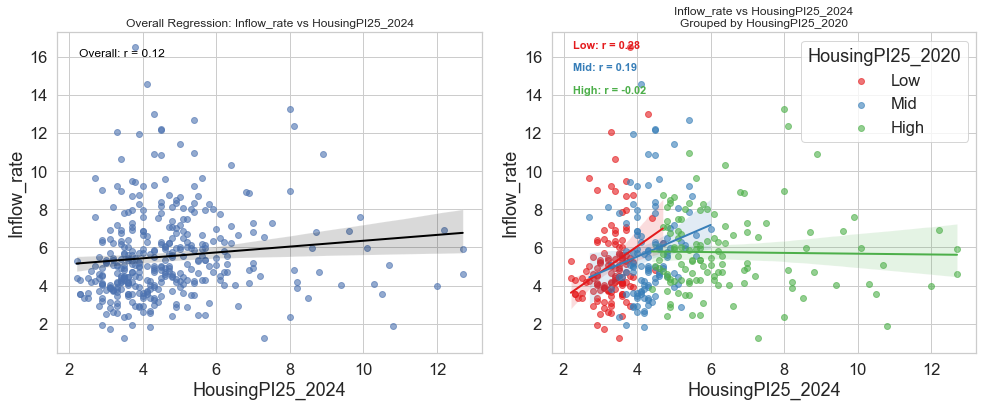

📊 Plot ID 239: X = HousingPI25_2024, Y = Outflow_rate, Z = loss_per_capita_pe


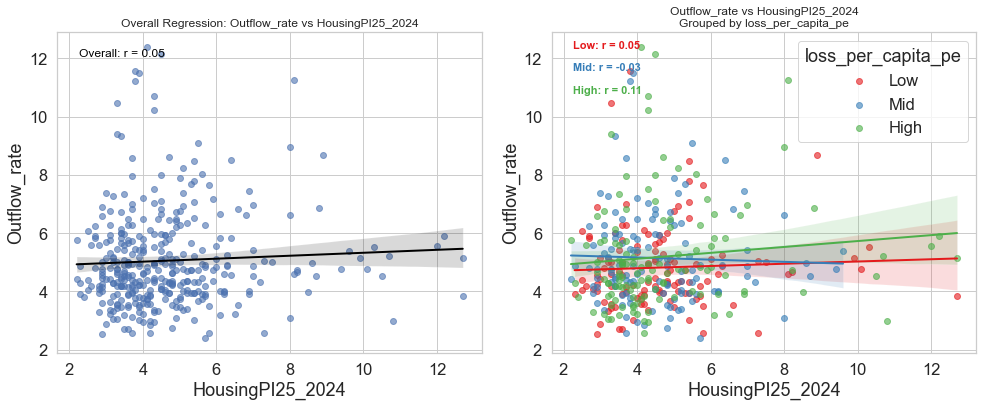

📊 Plot ID 240: X = HousingPI25_2024, Y = Outflow_rate, Z = loss_per_capita_bldg


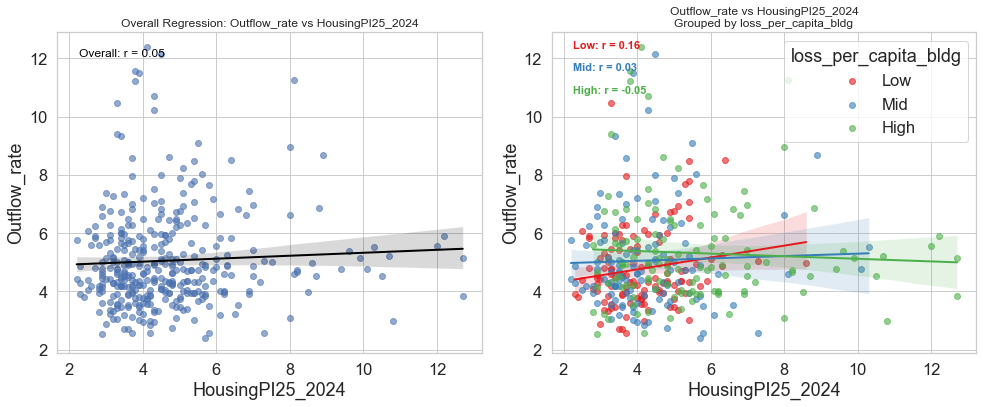

📊 Plot ID 241: X = HousingPI25_2024, Y = Outflow_rate, Z = Inflow_rate


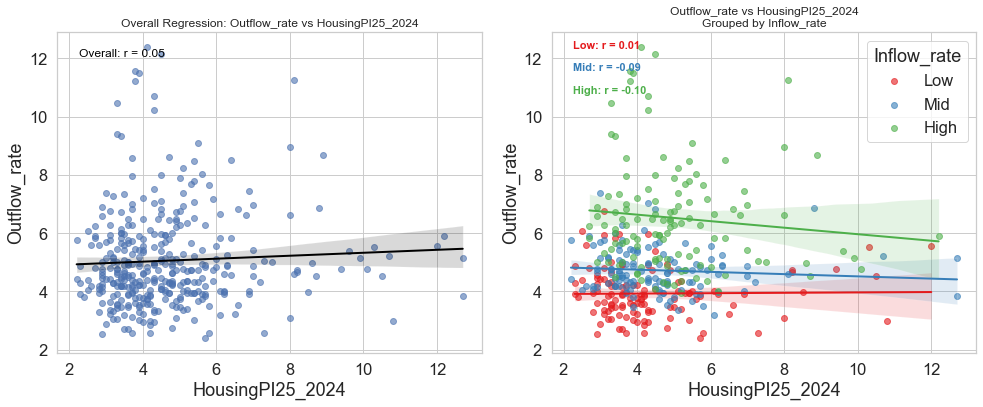

📊 Plot ID 242: X = HousingPI25_2024, Y = Outflow_rate, Z = Migration16to20_A_Outflow_Estimate


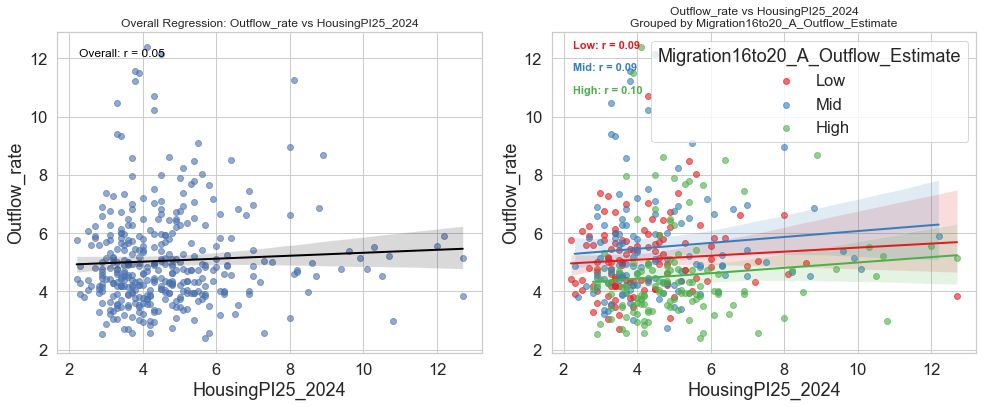

📊 Plot ID 243: X = HousingPI25_2024, Y = Outflow_rate, Z = HousingPI25_2000


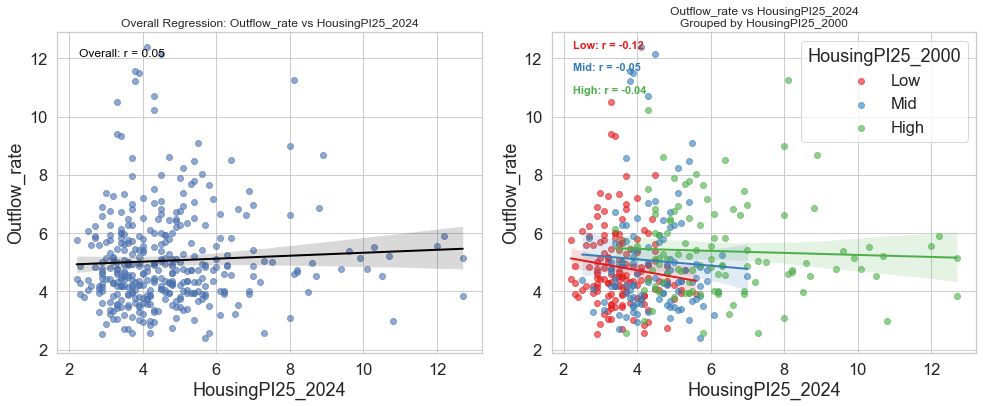

📊 Plot ID 244: X = HousingPI25_2024, Y = Outflow_rate, Z = HousingPI25_2010


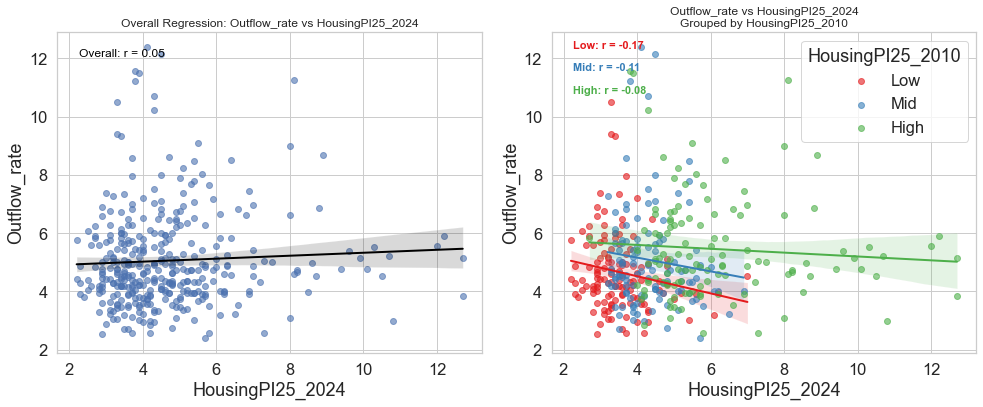

📊 Plot ID 245: X = HousingPI25_2024, Y = Outflow_rate, Z = HousingPI25_2020


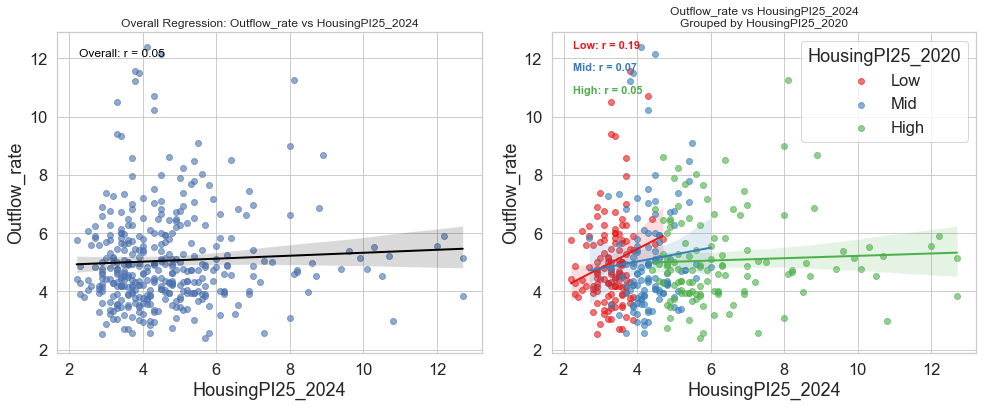

📊 Plot ID 246: X = HousingPI25_2024, Y = Migration16to20_A_Outflow_Estimate, Z = loss_per_capita_pe


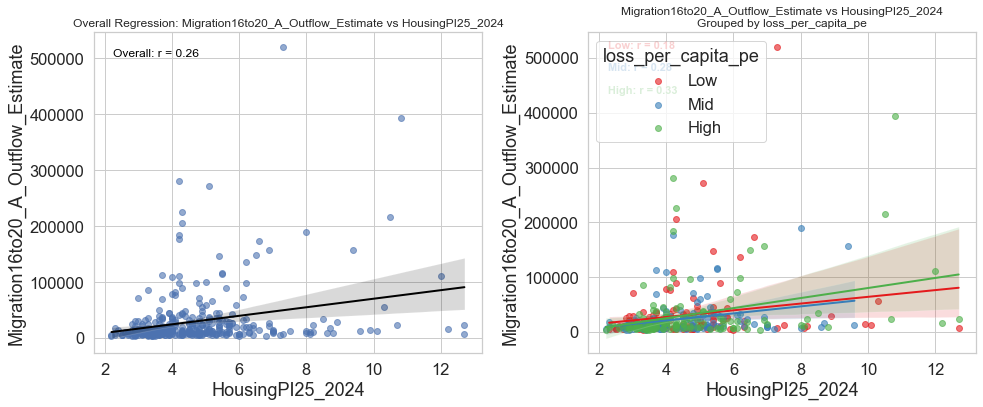

📊 Plot ID 247: X = HousingPI25_2024, Y = Migration16to20_A_Outflow_Estimate, Z = loss_per_capita_bldg


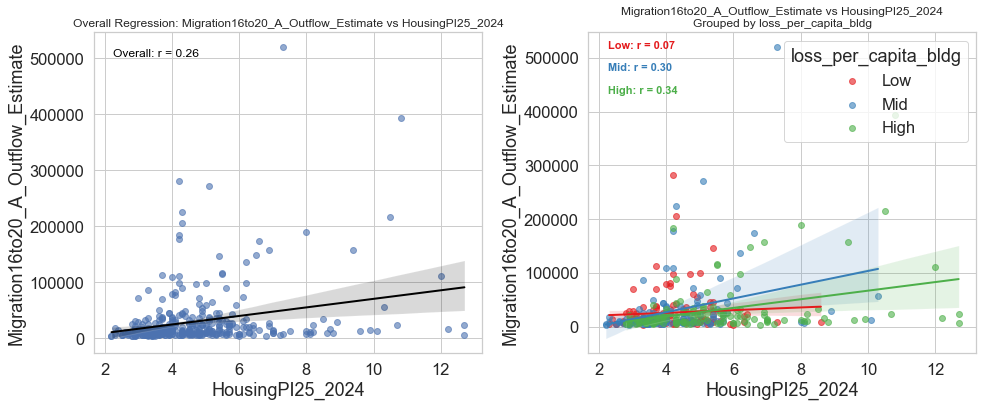

📊 Plot ID 248: X = HousingPI25_2024, Y = Migration16to20_A_Outflow_Estimate, Z = Inflow_rate


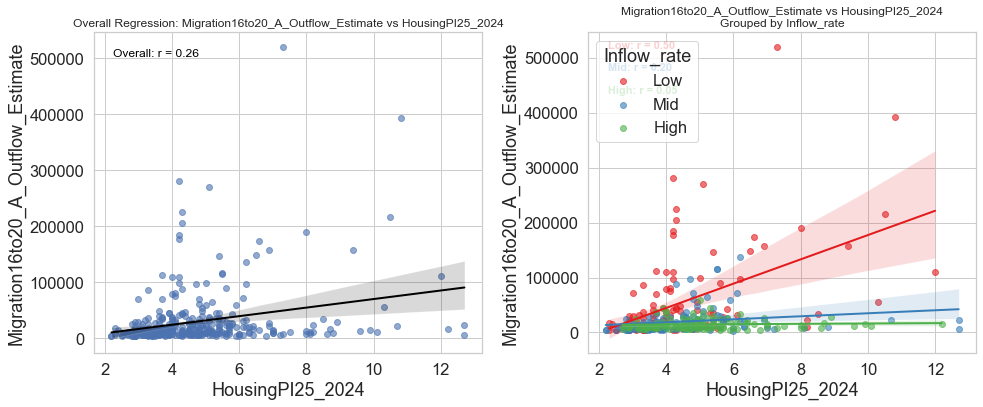

📊 Plot ID 249: X = HousingPI25_2024, Y = Migration16to20_A_Outflow_Estimate, Z = Outflow_rate


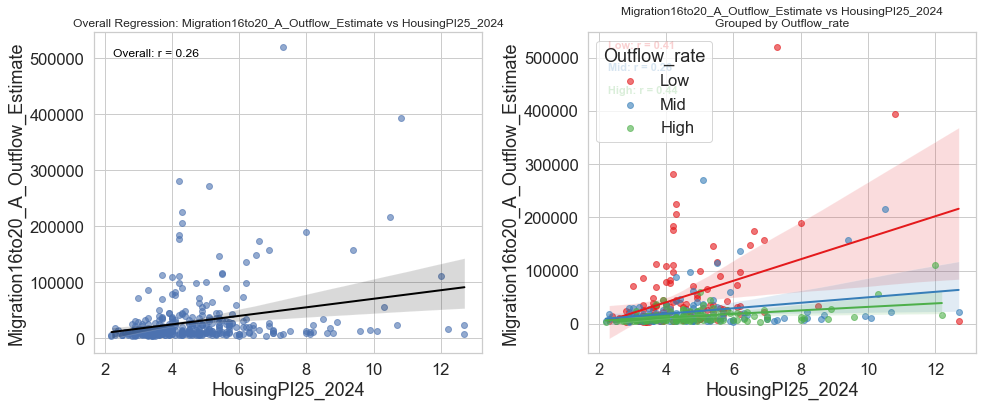

📊 Plot ID 250: X = HousingPI25_2024, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2000


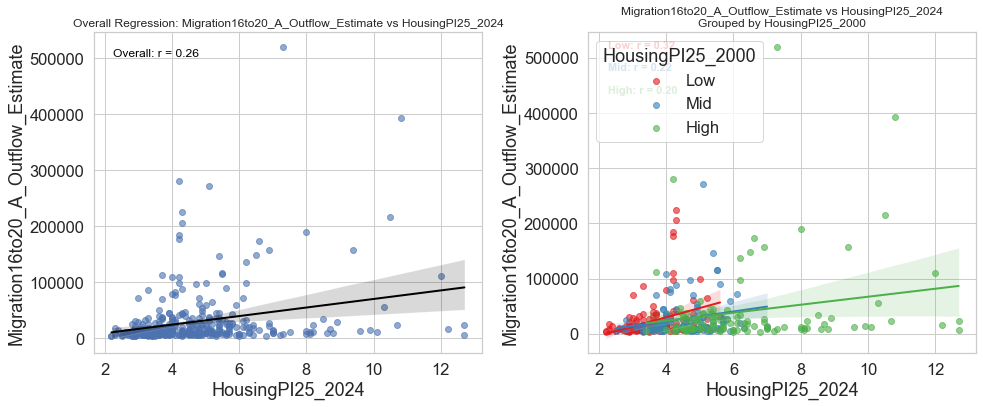

📊 Plot ID 251: X = HousingPI25_2024, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2010


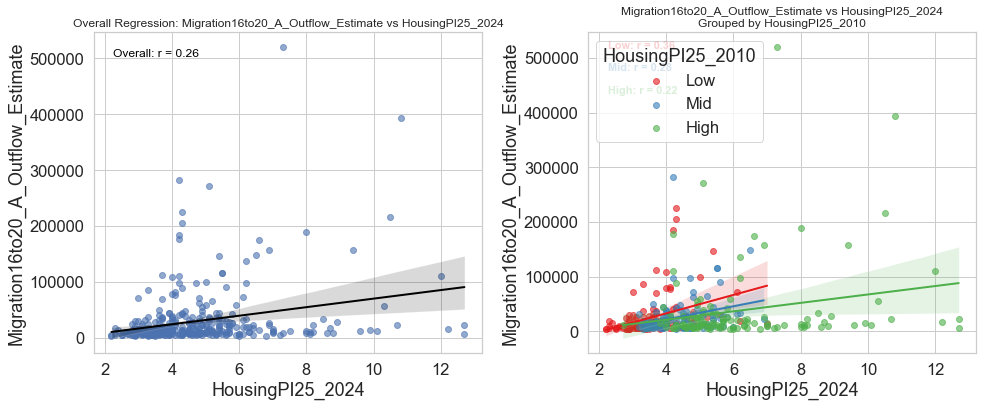

📊 Plot ID 252: X = HousingPI25_2024, Y = Migration16to20_A_Outflow_Estimate, Z = HousingPI25_2020


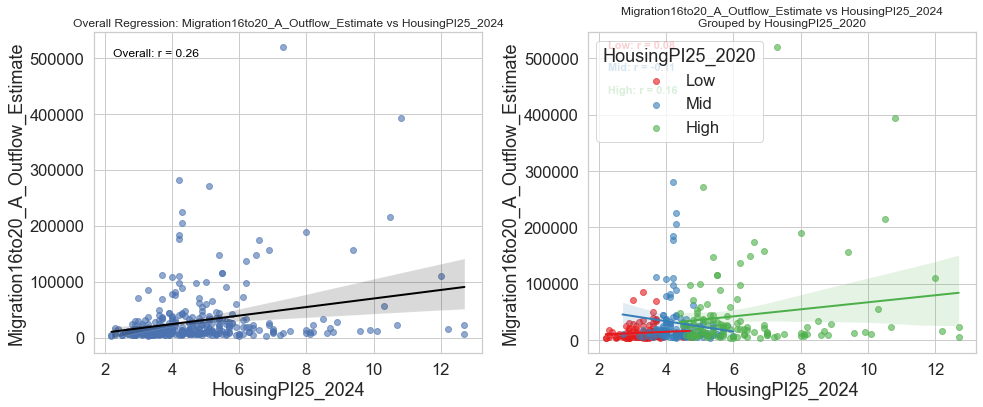

In [14]:
summary = plot_by_combo_id(df=data, combo_table=combo_table, ID_list=combo_table['ID'].to_list())

In [15]:
summary.to_csv('Correlations_summary.csv')